<a href="https://colab.research.google.com/github/humzkhan/Adaptive_learning/blob/main/Thesis_Smooth.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install scikit-optimize

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 107.8/107.8 kB 4.3 MB/s eta 0:00:00


In [2]:
import numpy as np
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore", category=UserWarning)

from skopt import gp_minimize
from skopt.plots import plot_convergence

import os
import glob
import pandas as pd

import re

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from mpl_toolkits.mplot3d import Axes3D
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels import RBF, WhiteKernel, ExpSineSquared, RationalQuadratic, Matern, Product, ConstantKernel as C
from collections import defaultdict
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from pandas.plotting import parallel_coordinates
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
from scipy.stats import f_oneway

In [3]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)  # Approve the authentication prompts as needed

Mounted at /content/drive


Helper Functions

In [4]:
def check_headers(dataframes, required_headers):
    """
    Check each DataFrame for the presence of required headers.

    Parameters:
    - dataframes (dict): Dictionary where keys are file paths and values are DataFrames.
    - required_headers (list): List of required headers to check for.

    Returns:
    - dict: Dictionary with filenames as keys and missing headers as values.
    """
    missing_headers = {}

    for file_path, df in dataframes.items():
        # Normalize the column names: lowercase and remove spaces
        normalized_columns = [col.lower().replace(" ", "") for col in df.columns]

        # Find missing headers
        file_missing = [header.lower().replace(" ", "") for header in required_headers if header.lower().replace(" ", "") not in normalized_columns]

        if file_missing:
            missing_headers[file_path] = file_missing

    return missing_headers

def add_missing_headers_flexible(dataframes):
    """
    Add missing headers to DataFrames by searching flexibly for S11 and S21 in column headers.

    Parameters:
    - dataframes (dict): Dictionary where keys are file paths and values are DataFrames.

    Returns:
    - dict: Updated dictionary of DataFrames with missing headers added.
    """
    updated_files = []  # To track files that were updated

    for file_path, df in dataframes.items():
        # Normalize column names for consistent matching
        df.columns = [col.lower().replace(" ", "").replace("(linm)", "") for col in df.columns]

        # Flag to track if any update was made
        updated = False

        # Attempt to locate 'S11' and 'S21' columns
        s11_col = next((col for col in df.columns if "s11" in col), None)
        s21_col = next((col for col in df.columns if "s21" in col), None)

        # Check and calculate each required column
        if 'r' not in df.columns:
            if s11_col:
                df['r'] = df[s11_col] ** 2
                updated = True
            else:
                print(f"Missing 'S11' column for calculating 'R' in {file_path}")
                continue

        if 't' not in df.columns:
            if s21_col:
                df['t'] = df[s21_col] ** 2
                updated = True
            else:
                print(f"Missing 'S21' column for calculating 'T' in {file_path}")
                continue

        if 'a' not in df.columns:
            if 'r' in df.columns and 't' in df.columns:
                df['a'] = 1 - df['r'] - df['t']
                updated = True
            else:
                print(f"Cannot calculate 'A' in {file_path} due to missing 'R' or 'T'")
                continue

        if 'ser' not in df.columns:
            if 'r' in df.columns:
                df['ser'] = -10 * np.log10(1 - df['r'])
                updated = True
            else:
                print(f"Cannot calculate 'SEr' in {file_path} due to missing 'R'")
                continue

        if 'set' not in df.columns:
            if 't' in df.columns:
                df['set'] = -10 * np.log10(df['t'])
                updated = True
            else:
                print(f"Cannot calculate 'SEt' in {file_path} due to missing 'T'")
                continue

        if 'sea' not in df.columns:
            if 'set' in df.columns and 'ser' in df.columns:
                df['sea'] = df['set'] - df['ser']
                updated = True
            else:
                print(f"Cannot calculate 'SEa' in {file_path} due to missing 'SEt' or 'SEr'")
                continue

        # If updated, track the file
        if updated:
            updated_files.append(file_path)

        # Update DataFrame in the dictionary
        dataframes[file_path] = df

    ## Print updated files
    #for file_path in updated_files:
     #   print(f"\nUpdated {file_path}:")
      #  print(dataframes[file_path].head(1))  # Print only the first row for preview

    return dataframes

def standardize_files(dataframes):
    """
    Standardize the headers and clean up the data for all provided dataframes.

    Parameters:
    - dataframes (dict): Dictionary where keys are file paths and values are DataFrames.

    Returns:
    - dict: Updated dictionary with standardized DataFrames.
    """
    standardized_headers = [
        "frequency(Hz)", "Tr 1  Data(e')", "Tr 2  Data(e'')", "Tr 3  Data(u')",
        "Tr 4  Data(u'')", "Tr 5  S11(LinM)", "Tr 6  S21(LinM)", "R", "T", "A", "SEr", "Sea", "Set"
    ]
    standardized_dfs = {}

    for file_path, df in dataframes.items():
        # Standardize column names (remove spacing, normalize to lowercase for matching)
        df.columns = [col.lower().strip().replace(" ", "").replace("(linm)", "") for col in df.columns]

        # Map the standardized headers to the current column names
        column_mapping = {}
        for std_col in standardized_headers:
            std_col_lower = std_col.lower().replace(" ", "").replace("(linm)", "")
            match = next((col for col in df.columns if col == std_col_lower), None)
            if match:
                column_mapping[match] = std_col

        # Apply the mapping to the DataFrame
        df = df.rename(columns=column_mapping)

        # Retain only the standardized headers
        df = df[[col for col in standardized_headers if col in df.columns]]

        # Filter rows to keep only frequency values within the specified range (12.4 GHz to 18 GHz)
        freq_col = "frequency(Hz)"
        if freq_col in df.columns:
            df = df[(df[freq_col] >= 12.4e9) & (df[freq_col] <= 18e9)]

        # Save the standardized DataFrame
        standardized_dfs[file_path] = df

    return standardized_dfs


def remove_footer_data(dataframes):
    """
    Remove footer data from DataFrames by splitting off rows starting at the first null value.

    Parameters:
    - dataframes (dict): Dictionary where keys are file paths and values are DataFrames.

    Returns:
    - dict: Updated dictionary of DataFrames with footer data removed.
    """
    updated_dataframes = {}

    for file_path, df in dataframes.items():
        # Find the first index where a null value appears
        null_index = df.isnull().any(axis=1).idxmax() if df.isnull().any().any() else None

        if null_index is not None and null_index > 0:
            # Keep only the rows before the first null
            df_cleaned = df.iloc[:null_index]
            #print(f"Footer data removed from {file_path} starting at index {null_index}")
        else:
            df_cleaned = df  # No null values, keep the DataFrame as is
            #print(f"No footer data found in {file_path}")

        # Update the dictionary with cleaned DataFrame
        updated_dataframes[file_path] = df_cleaned

    return updated_dataframes

def thesis_row_with_alternative_features(file_path, df):
    """
    Extract features for a single dataframe with alternative features for modeling.

    Parameters:
    - file_path (str): Path to the file.
    - df (pd.DataFrame): Dataframe to process.

    Returns:
    - dict: Extracted features as a dictionary.
    """

    match = re.search(r'(\d+)%/(ABS|PBT)/(\d+)%-(ABS|PBT)-([\d.]+)mm', file_path)
    if not match:
        print(f"Filename format not recognized: {file_path}")
        return None

    cnt_pct = int(match.group(1))
    material = match.group(2)
    thickness = float(match.group(5))

    # Normalize column names
    df.columns = [col.strip().lower() for col in df.columns]

    # Create a row with features
    row = {
        'filename': file_path,
        'cnt_pct': cnt_pct,
        'material': material,
        'thickness': thickness,
        'mean_a': df['a'].mean() if 'a' in df.columns else np.nan,
        'max_a': df['a'].max() if 'a' in df.columns else np.nan,
        'std_a': df['a'].std() if 'a' in df.columns else np.nan,
        'range_a': (df['a'].max() - df['a'].min()) if 'a' in df.columns else np.nan,
        'weighted_mean_a': (df['a'] * df['frequency(hz)']).sum() / df['frequency(hz)'].sum()
        if 'a' in df.columns else np.nan,
        'mean_r': df['r'].mean() if 'r' in df.columns else np.nan,
        'std_r': df['r'].std() if 'r' in df.columns else np.nan,
        'mean_t': df['t'].mean() if 't' in df.columns else np.nan,
        'std_t': df['t'].std() if 't' in df.columns else np.nan,
        'mean_a_to_r_ratio': (df['a'].mean() / df['r'].mean()) if 'a' in df.columns and 'r' in df.columns else np.nan,
        'gradient_a': np.gradient(df['a']).mean() if 'a' in df.columns else np.nan,
        'gradient_r': np.gradient(df['r']).mean() if 'r' in df.columns else np.nan,
        'gradient_t': np.gradient(df['t']).mean() if 't' in df.columns else np.nan,
        'performance_score': (
            0.5 * df['a'].mean() - 0.3 * df['r'].mean() + 0.2 * df['t'].mean()
        ) if 'a' in df.columns and 'r' in df.columns and 't' in df.columns else np.nan,
    }
    return row

def create_thesis_dataframe_with_alternative_features(dataframes):
    """
    Create a single thesis dataframe by processing multiple dataframes with alternative features.

    Parameters:
    - dataframes (dict): Dictionary where keys are file paths and values are DataFrames.

    Returns:
    - pd.DataFrame: Thesis dataframe with all rows appended.
    """
    thesis_data = []
    for file_path, df in dataframes.items():
        thesis_row_data = thesis_row_with_alternative_features(file_path, df)
        if thesis_row_data:
            thesis_data.append(thesis_row_data)

    return pd.DataFrame(thesis_data)



In [5]:
import re

def extract_material_properties(file_path, df):
    """
    Extract material properties at each frequency for a given sample.

    Parameters:
    - file_path (str): Path to the file.
    - df (pd.DataFrame): DataFrame with frequency-based data.

    Returns:
    - pd.DataFrame: DataFrame containing material properties per frequency.
    """
    # Extract CNT%, Material, and Thickness from the filename
    match = re.search(r'(\d+)%/(ABS|PBT)/(\d+)%-(ABS|PBT)-([\d.]+)mm', file_path)
    if not match:
        print(f"❌ Filename format not recognized: {file_path}")
        return None

    cnt_pct = int(match.group(1))
    material = match.group(2)
    thickness = float(match.group(5))

    # Normalize column names (remove extra spaces, lowercase everything)
    df.columns = [col.strip().lower().replace(" ", "") for col in df.columns]

    # Print available columns for debugging
    #print(f"\n🔍 Checking columns in {file_path}:")
    #print(df.columns.tolist())

    # **Flexible Column Mapping**
    column_mapping = {
        "frequency": r"frequency\(hz\)|freq",
        "epsilon_real": r"tr\d+data\(e'\)|e_real|epsilon_real",
        "epsilon_imag": r"tr\d+data\(e''\)|e_imag|epsilon_imag",
        "mu_real": r"tr\d+data\(u'\)|u_real|mu_real",
        "mu_imag": r"tr\d+data\(u''\)|u_imag|mu_imag",
    }

    # Find the best-matching columns dynamically
    selected_columns = {}
    for standard_name, regex_pattern in column_mapping.items():
        found_col = next((col for col in df.columns if re.search(regex_pattern, col)), None)
        if found_col:
            selected_columns[standard_name] = found_col
        else:
            print(f"⚠️ Warning: Could not find column for {standard_name} in {file_path}")

    # If critical columns are missing, skip this file
    if "frequency" not in selected_columns:
        print(f"❌ Skipping {file_path} due to missing frequency column")
        return None

    # Extract relevant data
    material_df = df[list(selected_columns.values())].copy()

    # Rename columns for consistency
    material_df.rename(columns={v: k for k, v in selected_columns.items()}, inplace=True)

    # Add metadata columns
    material_df["cnt_pct"] = cnt_pct
    material_df["material"] = material
    material_df["thickness"] = thickness

    print(f"Found required columns in {file_path}")

    return material_df


def create_material_properties_dataframe(dataframes):
    """
    Process multiple dataframes to extract per-frequency material properties.

    Parameters:
    - dataframes (dict): Dictionary of file paths and corresponding DataFrames.

    Returns:
    - pd.DataFrame: Combined DataFrame with all extracted material properties.
    """
    all_material_data = []

    for file_path, df in dataframes.items():
        material_df = extract_material_properties(file_path, df)
        if material_df is not None:
            all_material_data.append(material_df)

    # Combine all extracted material data
    combined_df = pd.concat(all_material_data, ignore_index=True) if all_material_data else None

    # Remove rows where 'frequency' is NaN (likely footer data)
    if combined_df is not None:
        combined_df = combined_df.dropna(subset=["frequency"])

    return combined_df


Main Function

In [6]:
def pull_all_data_from_google_drive_folder():
    """
    Step 1: Retrieves all Data files (csv, xls, xlsx) from desginated google drive path
    Step 2: Calculates SEr, SEa, SEt if hasn't been calculated yet
    Step 3: Standardizes files header names, removes header data, and footer data
    Step 4: Compiles cleaned data into DataFrame of Single layer samples

    returns dataframe

    """

    # Define the base path to your folder
    base_path = '/content/drive/MyDrive/Thesis_Updated/singleLayerData'

    # Dictionary to store DataFrames
    all_dfs = {}

    # Find all CSV and Excel files
    csv_files = glob.glob(os.path.join(base_path, '**', '*.csv'), recursive=True)
    xls_files = glob.glob(os.path.join(base_path, '**', '*.xls'), recursive=True)
    xlsx_files = glob.glob(os.path.join(base_path, '**', '*.xlsx'), recursive=True)
    excel_files = xls_files + xlsx_files

    print(f"Found {len(csv_files)} CSV files and {len(excel_files)} Excel files.")

    # Step 4: Load all files into pandas DataFrames
    # Load CSV files (skip first 14 lines of the header)
    for file_path in csv_files:
        try:
            relative_path = os.path.relpath(file_path, base_path)
            print(f"Loading CSV: {relative_path} (Skipping first 14 lines)")
            df = pd.read_csv(file_path, skiprows=14)  # Skip first 14 rows
            all_dfs[relative_path] = df
        except Exception as e:
            print(f"Error reading CSV {file_path}: {e}")

    # Load Excel files
    for file_path in excel_files:
        try:
            relative_path = os.path.relpath(file_path, base_path)
            print(f"Loading Excel: {relative_path}")
            df = pd.read_excel(file_path)
            all_dfs[relative_path] = df
        except Exception as e:
            print(f"Error reading Excel {file_path}: {e}")

    # Step 5: Verify loaded DataFrames
    #print("\nLoaded the following files (relative paths):")
    #for rel_path in all_dfs:
        #print(f"  -> {rel_path}")
        #print(all_dfs[rel_path].head())  # Show the first few rows for each DataFrame

    # Define required headers
    required_headers = ['A', 'R', 'T', 'SEr', 'SEa', 'SEt']

    # Check headers for all DataFrames
    missing_headers_info = check_headers(all_dfs, required_headers)

    # Display results
    #if missing_headers_info:
     ##   print("\nFiles missing required headers:")
     #   for file, missing in missing_headers_info.items():
        #    print(f"File: {file}")
        #    print(f"Missing headers: {missing}")
    #else:
        #print("\nAll files have the required headers.")


    # Apply the updated function to all DataFrames
    updated_dfs = add_missing_headers_flexible(all_dfs)

    print("\nHeaders: SEr, SEa, SEt - Calculated")

    print("\nData Extraction Started")

    # Apply the standardization function to the dataframes
    standardized_dfs = standardize_files(all_dfs)



    # Check the results for a few files
    #for file_path, df in standardized_dfs.items():
        #print(f"\nStandardized {file_path}:")
        #print(df.head())

    # Apply the function to remove footer data

    cleaned_dfs = remove_footer_data(standardized_dfs)
    print("\nData Extraction Complete")

    # Example usage:
    thesis_df = create_thesis_dataframe_with_alternative_features(cleaned_dfs)
    print("\nData Frame Complete")

    # Generate material_df for material property analysis
    material_df = create_material_properties_dataframe(all_dfs)
    print("\nMaterial Properties DataFrame Complete")

    return thesis_df, material_df

thesis_df, material_df = pull_all_data_from_google_drive_folder()


Found 37 CSV files and 0 Excel files.
Loading CSV: 4%/PBT/4%-PBT-2.0mm.csv (Skipping first 14 lines)
Loading CSV: 5%/PBT/5%-PBT-2.8mm-B.csv (Skipping first 14 lines)
Loading CSV: 5%/PBT/5%-PBT-2.0mm.csv (Skipping first 14 lines)
Loading CSV: 5%/PBT/5%-PBT-2.8mm-A.csv (Skipping first 14 lines)
Loading CSV: 5%/ABS/5%-ABS-2.8mm-C.csv (Skipping first 14 lines)
Loading CSV: 5%/ABS/5%-ABS-2.8mm-B.csv (Skipping first 14 lines)
Loading CSV: 5%/ABS/5%-ABS-2.8mm-A.csv (Skipping first 14 lines)
Loading CSV: 3%/ABS/3%-ABS-1.1mm-B-ambient.csv (Skipping first 14 lines)
Loading CSV: 3%/ABS/3%-ABS-2.8mm-C.csv (Skipping first 14 lines)
Loading CSV: 3%/ABS/3%-ABS-1.1mm-A-ambient.csv (Skipping first 14 lines)
Loading CSV: 3%/ABS/3%-ABS-1.1mm-A-compressed.csv (Skipping first 14 lines)
Loading CSV: 3%/ABS/3%-ABS-1.1mm-B-compressed.csv (Skipping first 14 lines)
Loading CSV: 3%/ABS/3%-ABS-2.8mm-B.csv (Skipping first 14 lines)
Loading CSV: 3%/ABS/3%-ABS-1.1mm-B-quenched.csv (Skipping first 14 lines)
Loading C

In [30]:
thesis_df

,filename,cnt_pct,material,thickness,mean_a,max_a,std_a,range_a,weighted_mean_a,mean_r,std_r,mean_t,std_t,mean_a_to_r_ratio,gradient_a,gradient_r,gradient_t,performance_score
0,4%/PBT/4%-PBT-2.0mm.csv,4,PBT,2.0,0.322400,0.366000,0.032448,0.120000,0.325429,0.675710,0.032294,0.001980,1.407053e-04,0.477128,0.001260,-0.001250,-1.000000e-05,-0.041117
1,5%/PBT/5%-PBT-2.8mm-B.csv,5,PBT,2.8,0.290490,0.340000,0.031941,0.109000,0.293846,0.708940,0.031879,0.001000,6.537985e-19,0.409753,0.001065,-0.001055,0.000000e+00,-0.067237
2,5%/PBT/5%-PBT-2.0mm.csv,5,PBT,2.0,0.280870,0.308000,0.024239,0.087000,0.282945,0.709060,0.023523,0.010010,8.932406e-04,0.396116,0.000950,-0.000915,-3.000000e-05,-0.070281
3,5%/PBT/5%-PBT-2.8mm-A.csv,5,PBT,2.8,0.381270,0.428000,0.032487,0.121000,0.384122,0.614710,0.032279,0.004000,2.615194e-18,0.620244,0.001225,-0.001235,0.000000e+00,0.007022
4,5%/ABS/5%-ABS-2.8mm-C.csv,5,ABS,2.8,0.323394,0.378991,0.037225,0.151901,0.327121,0.675066,0.037086,0.001541,1.515093e-04,0.479055,0.001591,-0.001586,-5.277696e-06,-0.040515
5,5%/ABS/5%-ABS-2.8mm-B.csv,5,ABS,2.8,0.386848,0.447619,0.041150,0.165001,0.391030,0.610900,0.040854,0.002252,3.136588e-04,0.633243,0.001709,-0.001698,-1.075371e-05,0.010605
6,5%/ABS/5%-ABS-2.8mm-A.csv,5,ABS,2.8,0.364283,0.420302,0.037661,0.154790,0.368035,0.634600,0.037497,0.001117,1.783259e-04,0.574036,0.001598,-0.001592,-6.100656e-06,-0.008015
7,3%/ABS/3%-ABS-1.1mm-B-ambient.csv,3,ABS,1.1,0.277968,0.336482,0.037138,0.145670,0.281689,0.682892,0.040165,0.039140,3.254189e-03,0.407046,0.001491,-0.001586,9.488576e-05,-0.058055
8,3%/ABS/3%-ABS-2.8mm-C.csv,3,ABS,2.8,0.398753,0.453739,0.037528,0.153152,0.402528,0.597885,0.037241,0.003362,3.208077e-04,0.666940,0.001552,-0.001541,-1.118723e-05,0.020684
9,3%/ABS/3%-ABS-1.1mm-A-ambient.csv,3,ABS,1.1,0.264837,0.319390,0.035780,0.132930,0.268387,0.703096,0.038867,0.032068,3.369347e-03,0.376672,0.001321,-0.001426,1.044107e-04,-0.072097


In [31]:
material_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 3700 entries, 0 to 3758
Data columns (total 8 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   frequency     3700 non-null   float64
 1   epsilon_real  3700 non-null   float64
 2   epsilon_imag  3700 non-null   float64
 3   mu_real       3700 non-null   object 
 4   mu_imag       3700 non-null   object 
 5   cnt_pct       3700 non-null   int64  
 6   material      3700 non-null   object 
 7   thickness     3700 non-null   float64
dtypes: float64(4), int64(1), object(3)
memory usage: 260.2+ KB


In [32]:
material_df

,frequency,epsilon_real,epsilon_imag,mu_real,mu_imag,cnt_pct,material,thickness
0,1.240000e+10,12.70,6.38,1.0,0.00E+00,4,PBT,2.0
1,1.245657e+10,12.40,6.13,1.0,0.00E+00,4,PBT,2.0
2,1.251313e+10,12.60,6.13,1.0,0.00E+00,4,PBT,2.0
3,1.256970e+10,12.40,5.99,1.0,0.00E+00,4,PBT,2.0
4,1.262626e+10,12.60,6.19,1.0,0.00E+00,4,PBT,2.0
...,...,...,...,...,...,...,...,...
3754,1.777374e+10,6.17,4.59,1.0,0.00E+00,2,PBT,2.0
3755,1.783030e+10,6.15,4.74,1.0,0.00E+00,2,PBT,2.0
3756,1.788687e+10,6.17,4.53,1.0,0.00E+00,2,PBT,2.0
3757,1.794343e+10,6.09,4.63,1.0,0.00E+00,2,PBT,2.0


ANOVA

In [7]:
def run_one_way_anova(dataframe, group_column, value_column, group1, group2):
    """
    Perform a one-way ANOVA test between two groups in a dataset.

    Parameters:
    - dataframe (pd.DataFrame): The dataset containing the data.
    - group_column (str): The name of the column containing group labels (e.g., "material").
    - value_column (str): The name of the column containing the dependent variable (e.g., "performance_score").
    - group1 (str): The name of the first group to compare (e.g., "ABS").
    - group2 (str): The name of the second group to compare (e.g., "PBT").

    Returns:
    - dict: A dictionary with the F-statistic and p-value.
    """
    # Filter data for the two groups
    group1_data = dataframe[dataframe[group_column] == group1][value_column]
    group2_data = dataframe[dataframe[group_column] == group2][value_column]

    # Perform one-way ANOVA
    f_stat, p_value = f_oneway(group1_data, group2_data)

    return {"F-statistic": f_stat, "p-value": p_value}

In [8]:
def run_one_way_anova_ABS_PBT(dataframe):
    """
    Perform a one-way ANOVA test between ABS and PBT in a dataset.

    """

    # Assuming `thesis_df` is your dataset and you want to compare "ABS" and "PBT" based on "mean_a":
    result = run_one_way_anova(
        dataframe=dataframe,
        group_column="material",
        value_column="mean_a",
        group1="ABS",
        group2="PBT"
    )

    print("One-Way ANOVA Results (Mean Absorption):")
    print(f"F-statistic: {result['F-statistic']}")
    print(f"p-value: {result['p-value']}")

    # Assuming `thesis_df` is your dataset and you want to compare "ABS" and "PBT" based on "mean_r":
    result = run_one_way_anova(
        dataframe=dataframe,
        group_column="material",
        value_column="mean_r",
        group1="ABS",
        group2="PBT"
    )

    print("\nOne-Way ANOVA Results (Mean Reflection):")
    print(f"F-statistic: {result['F-statistic']}")
    print(f"p-value: {result['p-value']}")

    # Assuming `thesis_df` is your dataset and you want to compare "ABS" and "PBT" based on "mean_t":
    result = run_one_way_anova(
        dataframe=dataframe,
        group_column="material",
        value_column="mean_t",
        group1="ABS",
        group2="PBT"
    )

    print("\nOne-Way ANOVA Results (Mean Transmission):")
    print(f"F-statistic: {result['F-statistic']}")
    print(f"p-value: {result['p-value']}")

    return

run_one_way_anova_ABS_PBT(thesis_df)


One-Way ANOVA Results (Mean Absorption):
F-statistic: 0.7922660288977393
p-value: 0.3794934486420708

One-Way ANOVA Results (Mean Reflection):
F-statistic: 0.11728650111881918
p-value: 0.734044558708791

One-Way ANOVA Results (Mean Transmission):
F-statistic: 1.458892807011812
p-value: 0.23520492942327412


In [9]:
def add_abs_qca_column(dataframe):
    """
    Adds a column 'ABS-QCA' to the DataFrame based on the following rules:
    - Value is 0 if the material is PBT.
    - Value is 2 if the filename is one of the specified 6 names.
    - Value is 1 if the material is ABS but not one of the specified filenames.

    Parameters:
    - dataframe (pd.DataFrame): The input DataFrame to modify.

    Returns:
    - pd.DataFrame: The modified DataFrame with the new 'ABS-QCA' column.
    """
    # List of specific filenames
    specific_filenames = [
        "3%/ABS/3%-ABS-1.1mm-B-ambient.csv",
        "3%/ABS/3%-ABS-1.1mm-A-ambient.csv",
        "3%/ABS/3%-ABS-1.1mm-A-compressed.csv",
        "3%/ABS/3%-ABS-1.1mm-B-compressed.csv",
        "3%/ABS/3%-ABS-1.1mm-B-quenched.csv",
        "3%/ABS/3%-ABS-1.1mm-A-quenched.csv"
    ]

    # Define the logic for the 'ABS-QCA' column
    def determine_abs_qca(row):
        if row['material'] == 'PBT':
            return 0
        elif row['filename'] in specific_filenames:
            return 2
        elif row['material'] == 'ABS':
            return 1
        return None  # Fallback, should not occur if data is clean

    # Apply the logic to create the new column
    dataframe['ABS-QCA'] = dataframe.apply(determine_abs_qca, axis=1)

    return dataframe

In [10]:
def run_one_way_anova_QCA(dataframe):
    """
    Perform a one-way ANOVA test between Quenched, Compressed, Ambient samples and the rest of the dataset.

    """

    # Assuming `thesis_df` is your DataFrame:
    thesis_df_qca = add_abs_qca_column(dataframe)



    # Example usage:
    # Assuming `thesis_df` is your dataset and you want to compare "ABS" and "PBT" based on "performance_score":
    result = run_one_way_anova(
        dataframe=thesis_df_qca,
        group_column="ABS-QCA",
        value_column="mean_a",
        group1=1,
        group2=2
    )

    print("One-Way ANOVA Results (Mean Absorption):")
    print(f"F-statistic: {result['F-statistic']}")
    print(f"p-value: {result['p-value']}")

    # Example usage:
    # Assuming `thesis_df` is your dataset and you want to compare "ABS" and "PBT" based on "performance_score":
    result = run_one_way_anova(
        dataframe=thesis_df_qca,
        group_column="ABS-QCA",
        value_column="mean_r",
        group1=1,
        group2=2
    )

    print("\nOne-Way ANOVA Results (Mean Reflection):")
    print(f"F-statistic: {result['F-statistic']}")
    print(f"p-value: {result['p-value']}")

    # Example usage:
    # Assuming `thesis_df` is your dataset and you want to compare "ABS" and "PBT" based on "performance_score":
    result = run_one_way_anova(
        dataframe=thesis_df_qca,
        group_column="ABS-QCA",
        value_column="mean_t",
        group1=1,
        group2=2
    )

    print("\nOne-Way ANOVA Results (Mean Transmission):")
    print(f"F-statistic: {result['F-statistic']}")
    print(f"p-value: {result['p-value']}")


run_one_way_anova_QCA(thesis_df)


One-Way ANOVA Results (Mean Absorption):
F-statistic: 44.170955396551854
p-value: 1.5975295371311125e-05

One-Way ANOVA Results (Mean Reflection):
F-statistic: 9.255859658158506
p-value: 0.009437981170541348

One-Way ANOVA Results (Mean Transmission):
F-statistic: 0.6652533439876693
p-value: 0.42940275843364784


In [11]:
density_abs = 1.05  # g/cm³ (Typical for ABS)
density_pbt = 1.35  # g/cm³ (Assuming glass-filled PBT)
density_cnt = 1.8   # g/cm³ (Carbon Nanotubes)

def compute_volumetric_cnt(row):
    """
    Compute volumetric CNT percentage given weight percentage and material type.
    """
    # Select density based on material type
    if row['material'] == 'ABS':
        density_material = density_abs
    elif row['material'] == 'PBT':
        density_material = density_pbt
    else:
        return np.nan  # Return NaN if material is unknown

    # Extract weight % CNT
    w_cnt = row['cnt_pct']  # Weight percentage of CNT (already in dataframe)

    # Convert to volume fraction
    v_cnt = ( (w_cnt / 100) * density_material ) / \
            ( (w_cnt / 100) * density_material + (1 - w_cnt / 100) * density_cnt ) * 100

    return v_cnt

# Apply the function to create the new column
thesis_df['v_cnt_pct'] = thesis_df.apply(compute_volumetric_cnt, axis=1)

thesis_df


,filename,cnt_pct,material,thickness,mean_a,max_a,std_a,range_a,weighted_mean_a,mean_r,std_r,mean_t,std_t,mean_a_to_r_ratio,gradient_a,gradient_r,gradient_t,performance_score,ABS-QCA,v_cnt_pct
0,4%/PBT/4%-PBT-2.0mm.csv,4,PBT,2.0,0.322400,0.366000,0.032448,0.120000,0.325429,0.675710,0.032294,0.001980,1.407053e-04,0.477128,0.001260,-0.001250,-1.000000e-05,-0.041117,0,3.030303
1,5%/PBT/5%-PBT-2.8mm-B.csv,5,PBT,2.8,0.290490,0.340000,0.031941,0.109000,0.293846,0.708940,0.031879,0.001000,6.537985e-19,0.409753,0.001065,-0.001055,0.000000e+00,-0.067237,0,3.797468
2,5%/PBT/5%-PBT-2.0mm.csv,5,PBT,2.0,0.280870,0.308000,0.024239,0.087000,0.282945,0.709060,0.023523,0.010010,8.932406e-04,0.396116,0.000950,-0.000915,-3.000000e-05,-0.070281,0,3.797468
3,5%/PBT/5%-PBT-2.8mm-A.csv,5,PBT,2.8,0.381270,0.428000,0.032487,0.121000,0.384122,0.614710,0.032279,0.004000,2.615194e-18,0.620244,0.001225,-0.001235,0.000000e+00,0.007022,0,3.797468
4,5%/ABS/5%-ABS-2.8mm-C.csv,5,ABS,2.8,0.323394,0.378991,0.037225,0.151901,0.327121,0.675066,0.037086,0.001541,1.515093e-04,0.479055,0.001591,-0.001586,-5.277696e-06,-0.040515,1,2.978723
5,5%/ABS/5%-ABS-2.8mm-B.csv,5,ABS,2.8,0.386848,0.447619,0.041150,0.165001,0.391030,0.610900,0.040854,0.002252,3.136588e-04,0.633243,0.001709,-0.001698,-1.075371e-05,0.010605,1,2.978723
6,5%/ABS/5%-ABS-2.8mm-A.csv,5,ABS,2.8,0.364283,0.420302,0.037661,0.154790,0.368035,0.634600,0.037497,0.001117,1.783259e-04,0.574036,0.001598,-0.001592,-6.100656e-06,-0.008015,1,2.978723
7,3%/ABS/3%-ABS-1.1mm-B-ambient.csv,3,ABS,1.1,0.277968,0.336482,0.037138,0.145670,0.281689,0.682892,0.040165,0.039140,3.254189e-03,0.407046,0.001491,-0.001586,9.488576e-05,-0.058055,2,1.772152
8,3%/ABS/3%-ABS-2.8mm-C.csv,3,ABS,2.8,0.398753,0.453739,0.037528,0.153152,0.402528,0.597885,0.037241,0.003362,3.208077e-04,0.666940,0.001552,-0.001541,-1.118723e-05,0.020684,1,1.772152
9,3%/ABS/3%-ABS-1.1mm-A-ambient.csv,3,ABS,1.1,0.264837,0.319390,0.035780,0.132930,0.268387,0.703096,0.038867,0.032068,3.369347e-03,0.376672,0.001321,-0.001426,1.044107e-04,-0.072097,2,1.772152


In [15]:
import statsmodels.api as sm
import statsmodels.formula.api as smf

# Convert material type to categorical
thesis_df['material'] = thesis_df['material'].astype('category')

# Run ANCOVA for each target variable
for target in ['mean_a', 'mean_r', 'mean_t']:
    model = smf.ols(f"{target} ~ material + cnt_pct", data=thesis_df).fit()
    anova_table = sm.stats.anova_lm(model, typ=2)  # Type II ANOVA for ANCOVA
    print(f"ANCOVA results for {target}:")
    print(anova_table)
    print("\n" + "-"*50 + "\n")

ANCOVA results for mean_a:
            sum_sq    df         F    PR(>F)
material  0.003205   1.0  0.855176  0.361609
cnt_pct   0.037041   1.0  9.883322  0.003451
Residual  0.127427  34.0       NaN       NaN

--------------------------------------------------

ANCOVA results for mean_r:
            sum_sq    df          F        PR(>F)
material  0.003440   1.0   0.454625  5.047058e-01
cnt_pct   0.351167   1.0  46.416027  7.730597e-08
Residual  0.257232  34.0        NaN           NaN

--------------------------------------------------

ANCOVA results for mean_t:
            sum_sq    df          F        PR(>F)
material  0.013371   1.0   4.062678  5.179989e-02
cnt_pct   0.160384   1.0  48.729839  4.728916e-08
Residual  0.111904  34.0        NaN           NaN

--------------------------------------------------



In [16]:
# Convert material type to categorical
thesis_df['material'] = thesis_df['material'].astype('category')

# Run ANCOVA for each target variable
for target in ['mean_a', 'mean_r', 'mean_t']:
    model = smf.ols(f"{target} ~ material + v_cnt_pct", data=thesis_df).fit()
    anova_table = sm.stats.anova_lm(model, typ=2)  # Type II ANOVA for ANCOVA
    print(f"ANCOVA results for {target}:")
    print(anova_table)
    print("\n" + "-"*50 + "\n")


ANCOVA results for mean_a:
             sum_sq    df         F    PR(>F)
material   0.000562   1.0  0.149147  0.701758
v_cnt_pct  0.036273   1.0  9.620200  0.003856
Residual   0.128196  34.0       NaN       NaN

--------------------------------------------------

ANCOVA results for mean_r:
             sum_sq    df          F        PR(>F)
material   0.024069   1.0   3.049740  8.978050e-02
v_cnt_pct  0.340068   1.0  43.089676  1.608619e-07
Residual   0.268331  34.0        NaN           NaN

--------------------------------------------------

ANCOVA results for mean_t:
             sum_sq    df          F        PR(>F)
material   0.032142   1.0   9.277581  4.460830e-03
v_cnt_pct  0.154494   1.0  44.593244  1.150481e-07
Residual   0.117793  34.0        NaN           NaN

--------------------------------------------------



In [17]:
for target in ['mean_a', 'mean_r', 'mean_t']:
    model = smf.ols(f"{target} ~ material + cnt_pct + thickness", data=thesis_df).fit()
    anova_table = sm.stats.anova_lm(model, typ=2)  # Type II ANOVA
    print(f"ANCOVA results for {target} (controlling for cnt_pct & thickness):")
    print(anova_table)
    print("\n" + "-"*50 + "\n")

ANCOVA results for mean_a (controlling for cnt_pct & thickness):
             sum_sq    df          F    PR(>F)
material   0.001914   1.0   0.611719  0.439718
cnt_pct    0.057098   1.0  18.248866  0.000155
thickness  0.024176   1.0   7.726819  0.008914
Residual   0.103251  33.0        NaN       NaN

--------------------------------------------------

ANCOVA results for mean_r (controlling for cnt_pct & thickness):
             sum_sq    df          F        PR(>F)
material   0.004222   1.0   0.555482  4.613619e-01
cnt_pct    0.329719   1.0  43.379757  1.736111e-07
thickness  0.006407   1.0   0.842877  3.652370e-01
Residual   0.250825  33.0        NaN           NaN

--------------------------------------------------

ANCOVA results for mean_t (controlling for cnt_pct & thickness):
             sum_sq    df          F    PR(>F)
material   0.011906   1.0   3.698208  0.063136
cnt_pct    0.112664   1.0  34.995450  0.000001
thickness  0.005663   1.0   1.759150  0.193837
Residual   0.106240  

In [18]:
for target in ['mean_a', 'mean_r', 'mean_t']:
    model = smf.ols(f"{target} ~ material + v_cnt_pct + thickness", data=thesis_df).fit()
    anova_table = sm.stats.anova_lm(model, typ=2)  # Type II ANOVA
    print(f"ANCOVA results for {target} (controlling for v_cnt_pct & thickness):")
    print(anova_table)
    print("\n" + "-"*50 + "\n")

ANCOVA results for mean_a (controlling for v_cnt_pct & thickness):
             sum_sq    df          F    PR(>F)
material   0.000002   1.0   0.000673  0.979467
v_cnt_pct  0.057333   1.0  18.365852  0.000149
thickness  0.025180   1.0   8.066015  0.007667
Residual   0.103016  33.0        NaN       NaN

--------------------------------------------------

ANCOVA results for mean_r (controlling for v_cnt_pct & thickness):
             sum_sq    df          F        PR(>F)
material   0.027766   1.0   3.510451  6.986151e-02
v_cnt_pct  0.319531   1.0  40.398402  3.396824e-07
thickness  0.007318   1.0   0.925168  3.431171e-01
Residual   0.261014  33.0        NaN           NaN

--------------------------------------------------

ANCOVA results for mean_t (controlling for v_cnt_pct & thickness):
             sum_sq    df          F    PR(>F)
material   0.027435   1.0   8.049552  0.007723
v_cnt_pct  0.106431   1.0  31.227036  0.000003
thickness  0.005320   1.0   1.560829  0.220333
Residual   0.11

Visualizations

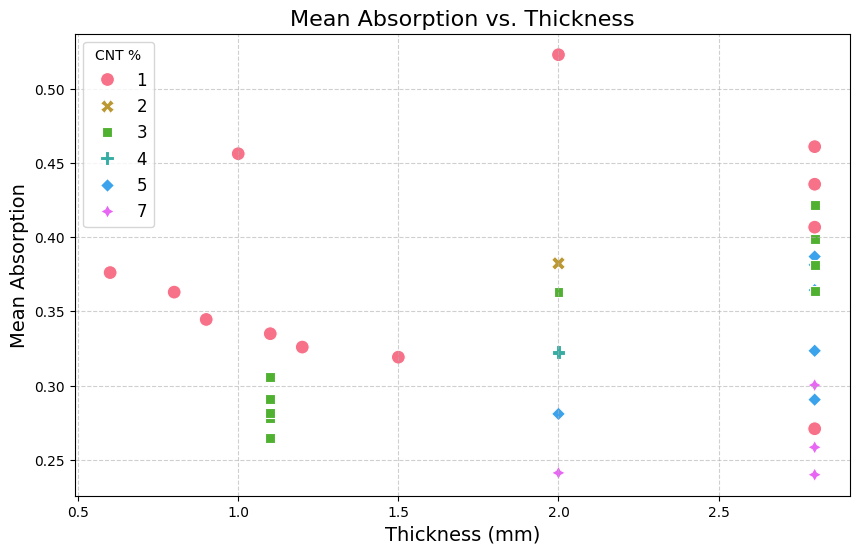

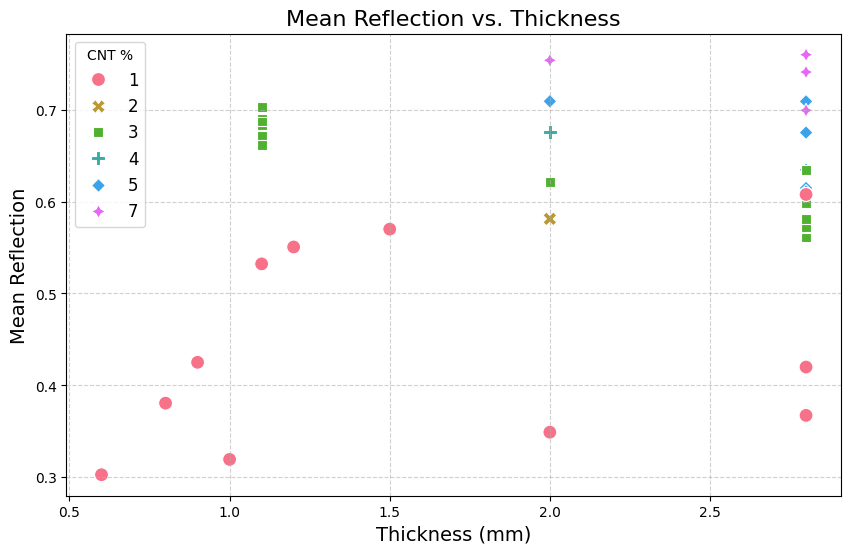

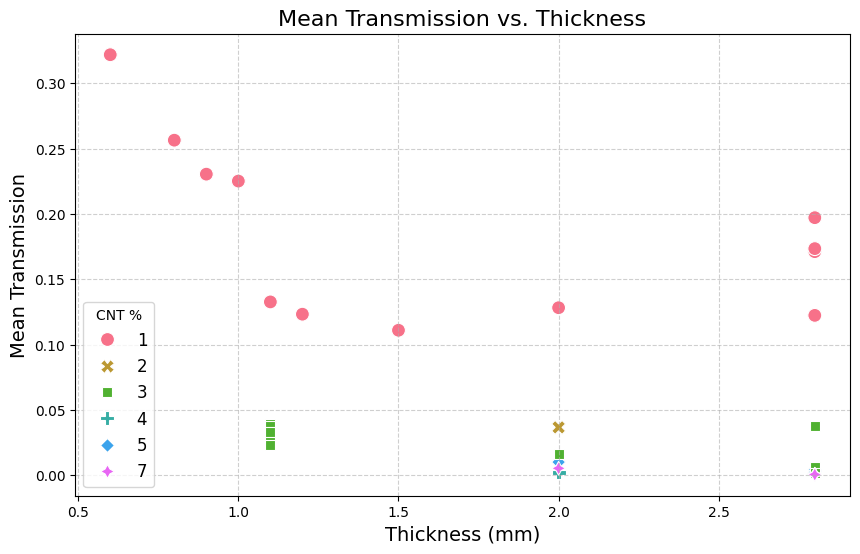

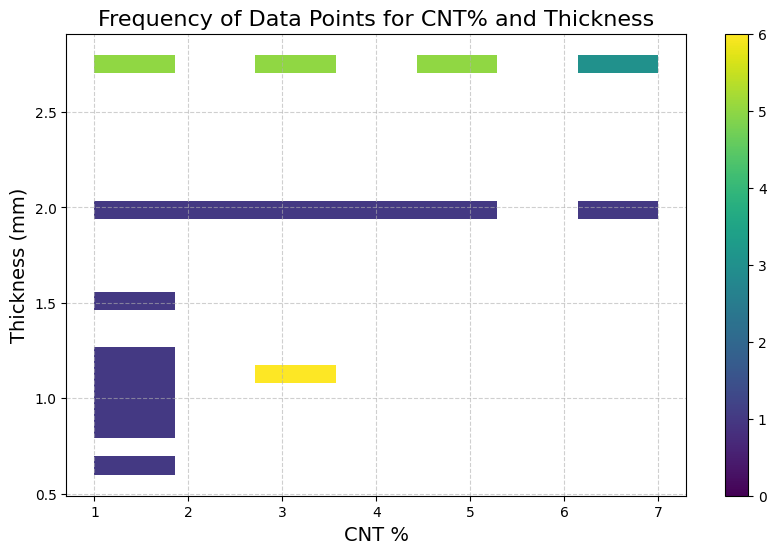

In [19]:
def plot_targets_by_thickness(df):
    """
    Plot mean absorption, reflection, and transmission as functions of thickness,
    with CNT% as different colors, and add a histogram showing the frequency
    of data points for each CNT% and thickness combination.

    Parameters:
    - df (pd.DataFrame): DataFrame containing 'thickness', 'cnt_pct', 'mean_a', 'mean_r', 'mean_t'
    """
    # Define target variables and titles
    targets = {'mean_a': 'Mean Absorption', 'mean_r': 'Mean Reflection', 'mean_t': 'Mean Transmission'}
    colors = sns.color_palette("husl", len(df['cnt_pct'].unique()))

    # Create scatter plots for each target variable
    for target, title in targets.items():
        plt.figure(figsize=(10, 6))
        sns.scatterplot(
            data=df,
            x="thickness",
            y=target,
            hue="cnt_pct",
            palette=colors,
            style="cnt_pct",
            s=100
        )
        plt.title(f'{title} vs. Thickness', fontsize=16)
        plt.xlabel('Thickness (mm)', fontsize=14)
        plt.ylabel(title, fontsize=14)
        plt.legend(title='CNT %', fontsize=12)
        plt.grid(True, linestyle='--', alpha=0.6)
        plt.show()

    # **New Plot: Histogram of data point frequencies for CNT% and Thickness**
    plt.figure(figsize=(10, 6))
    sns.histplot(
        data=df,
        y="thickness",
        x="cnt_pct",
        bins=[7, 23],  # 8 thickness bins (0.6mm-2.8mm), 7 CNT% bins (1%-7%)
        cbar=True,
        cmap="viridis"
    )
    plt.title('Frequency of Data Points for CNT% and Thickness', fontsize=16)
    plt.ylabel('Thickness (mm)', fontsize=14)
    plt.xlabel('CNT %', fontsize=14)
    plt.grid(True, linestyle='--', alpha=0.6)
    plt.show()

# Call the function
plot_targets_by_thickness(thesis_df)


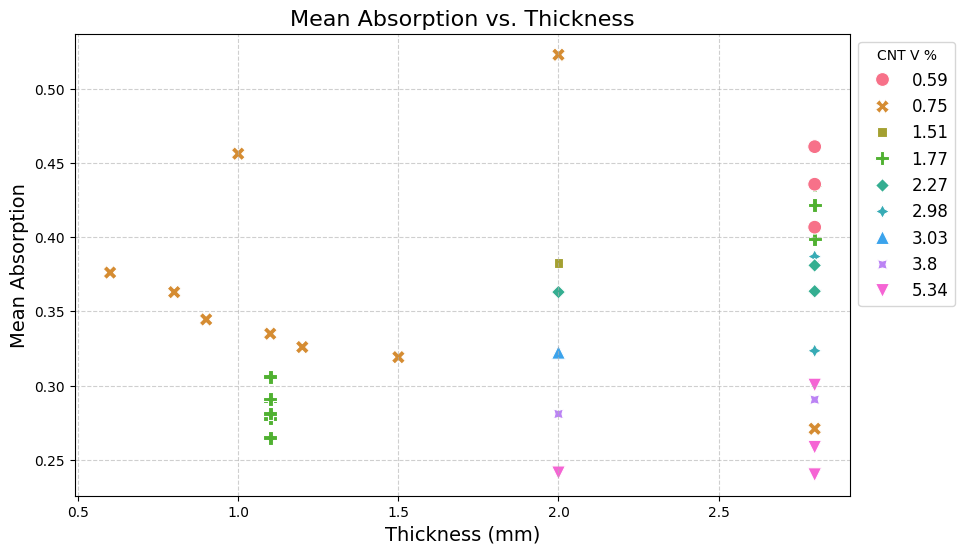

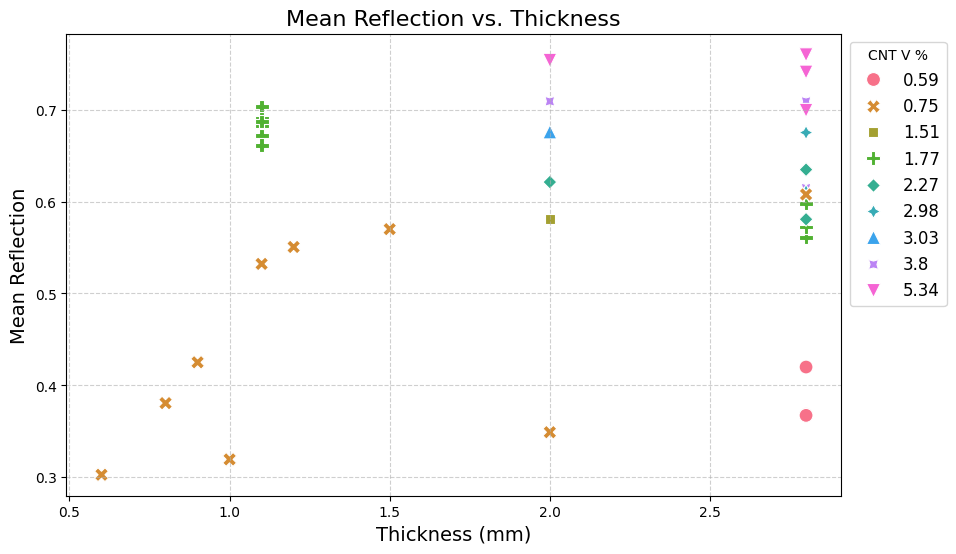

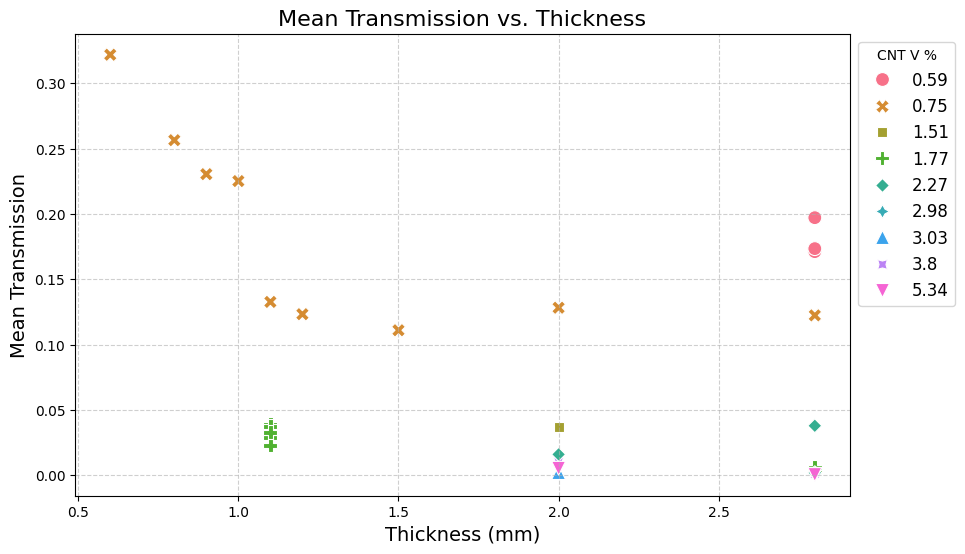

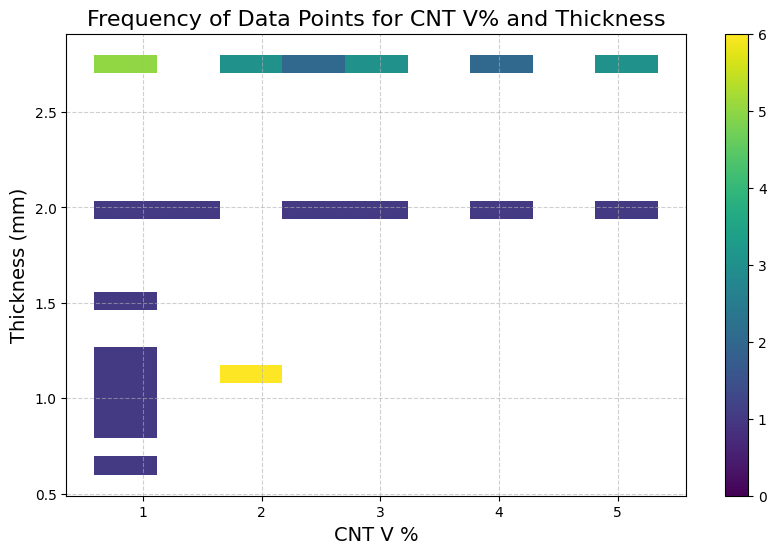

In [23]:
def plot_targets_by_thickness(df):
    """
    Plot mean absorption, reflection, and transmission as functions of thickness,
    with CNT% as different colors, and add a histogram showing the frequency
    of data points for each CNT% and thickness combination.

    Parameters:
    - df (pd.DataFrame): DataFrame containing 'thickness', 'cnt_pct', 'mean_a', 'mean_r', 'mean_t'
    """
    # Round `v-cnt_pct` to 2 decimal places for better readability
    df['v_cnt_pct_rounded'] = df['v_cnt_pct'].round(2)  # Convert to string for clean legend

    # **Sort the labels in ascending order**
    sorted_labels = sorted(df['v_cnt_pct_rounded'].unique(), key=float)  # Convert to float for proper sorting

    # Define target variables and titles
    targets = {'mean_a': 'Mean Absorption', 'mean_r': 'Mean Reflection', 'mean_t': 'Mean Transmission'}
    colors = sns.color_palette("husl", len(sorted_labels))

    # Create scatter plots for each target variable
    for target, title in targets.items():
        plt.figure(figsize=(10, 6))
        sns.scatterplot(
            data=df,
            x="thickness",
            y=target,
            hue="v_cnt_pct_rounded",
            hue_order=sorted_labels,  # Ensure legend is in ascending order
            palette=colors,
            style="v_cnt_pct_rounded",
            s=100
        )
        plt.title(f'{title} vs. Thickness', fontsize=16)
        plt.xlabel('Thickness (mm)', fontsize=14)
        plt.ylabel(title, fontsize=14)
        plt.legend(title='CNT V %', fontsize=12, loc='upper left', bbox_to_anchor=(1, 1))
        plt.grid(True, linestyle='--', alpha=0.6)
        plt.show()

    # **New Plot: Histogram of data point frequencies for CNT% and Thickness**
    plt.figure(figsize=(10, 6))
    sns.histplot(
        data=df,
        y="thickness",
        x="v_cnt_pct_rounded",
        bins=[np.linspace(min(sorted_labels), max(sorted_labels), len(sorted_labels) + 1), 23],  # Ensuring CNT% bin edges match actual values
        cbar=True,
        cmap="viridis"
    )
    plt.title('Frequency of Data Points for CNT V% and Thickness', fontsize=16)
    plt.ylabel('Thickness (mm)', fontsize=14)
    plt.xlabel('CNT V %', fontsize=14)
    plt.grid(True, linestyle='--', alpha=0.6)
    plt.show()

# Call the function
plot_targets_by_thickness(thesis_df)


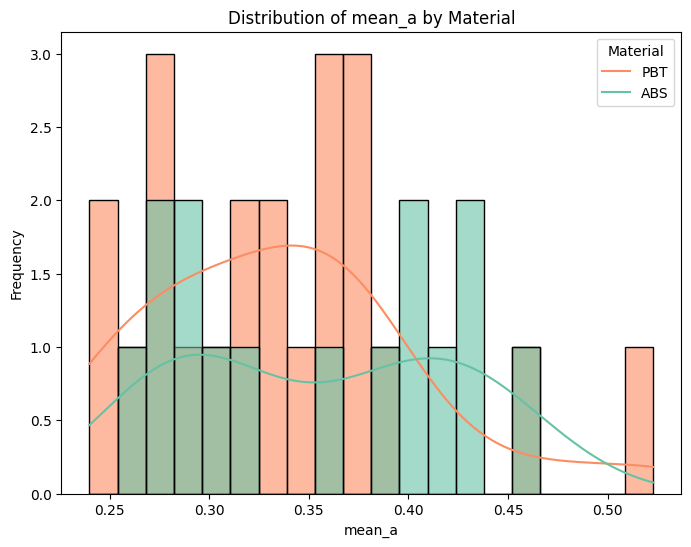

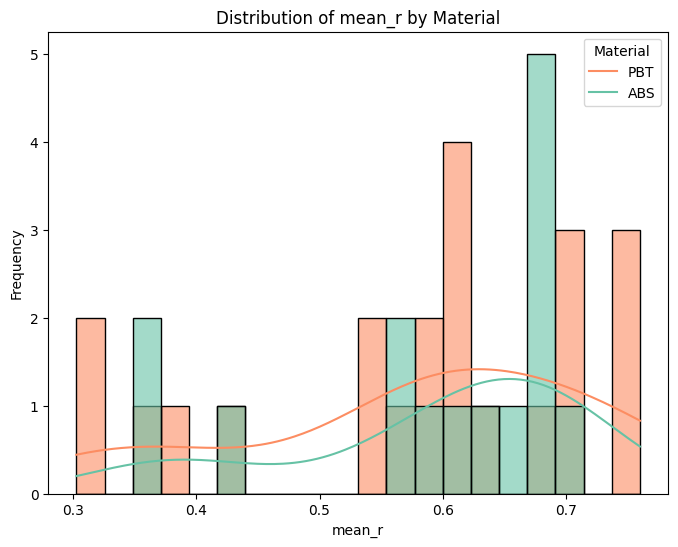

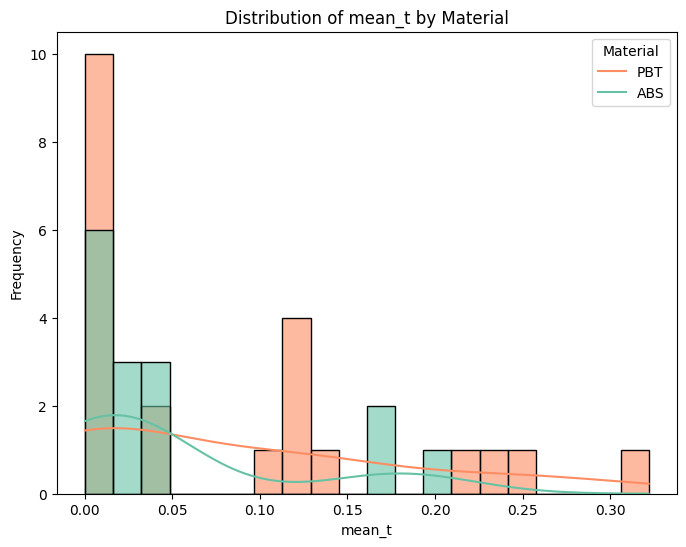

<ipython-input-24-422b6b2ea5a4>:12: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=dataframe, x='material', y=feature, palette='Set3')


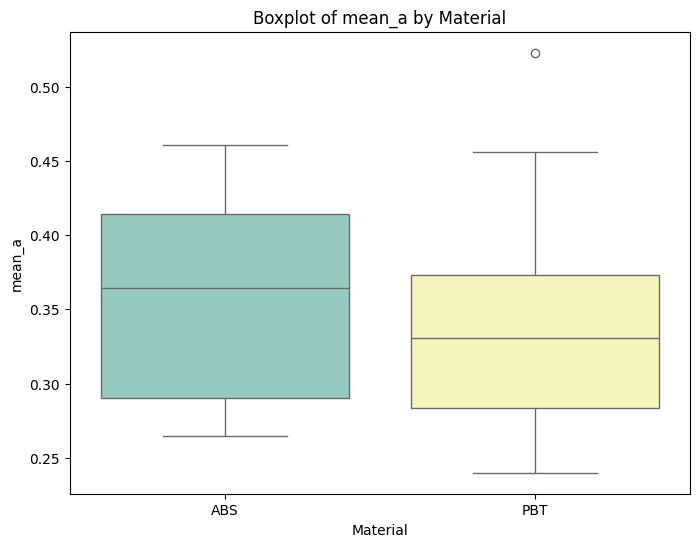

<ipython-input-24-422b6b2ea5a4>:12: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=dataframe, x='material', y=feature, palette='Set3')


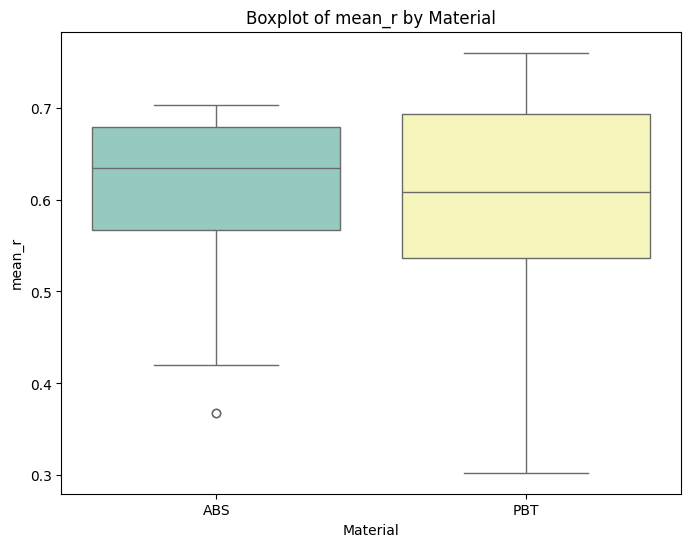

<ipython-input-24-422b6b2ea5a4>:12: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=dataframe, x='material', y=feature, palette='Set3')


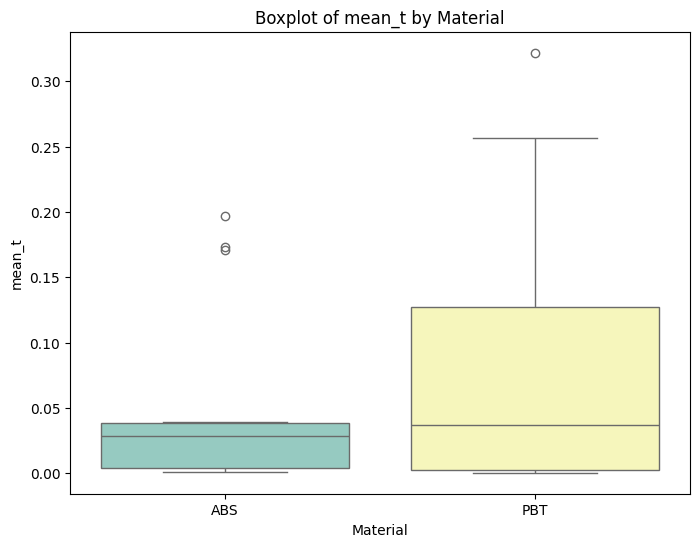

<ipython-input-24-422b6b2ea5a4>:20: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(data=dataframe, x='material', y=feature, palette='Set3')


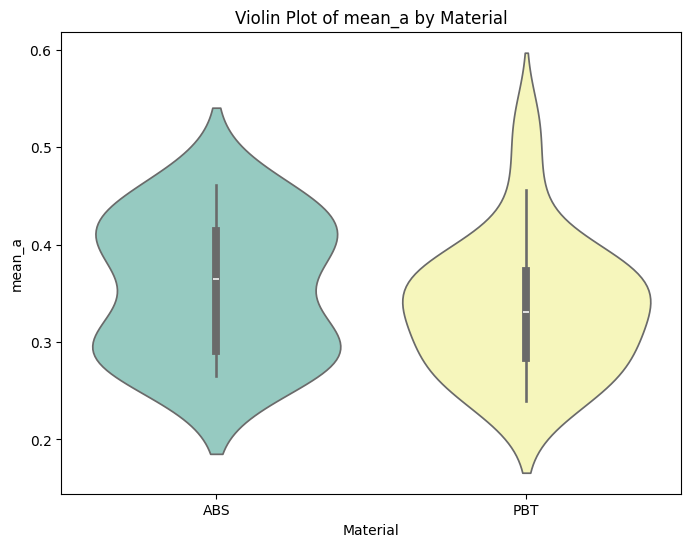

<ipython-input-24-422b6b2ea5a4>:20: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(data=dataframe, x='material', y=feature, palette='Set3')


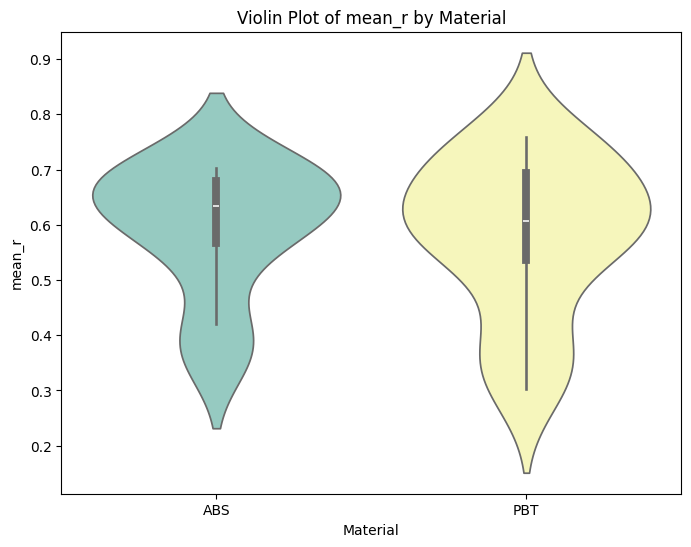

<ipython-input-24-422b6b2ea5a4>:20: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(data=dataframe, x='material', y=feature, palette='Set3')


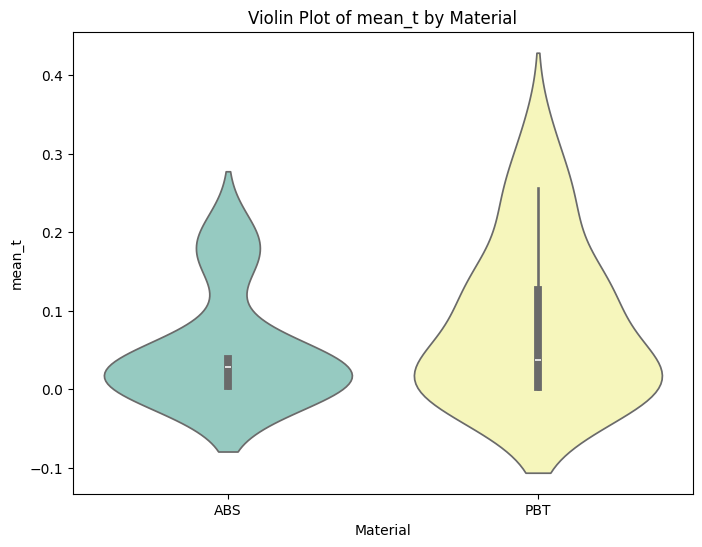

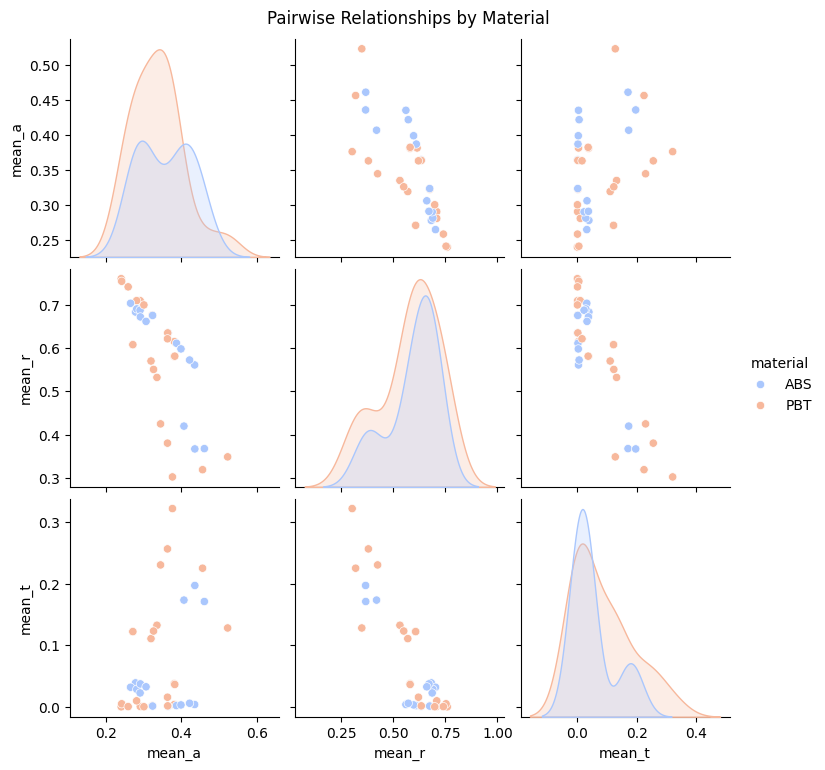

In [24]:
def visualize_ABS_PBT(dataframe):
  for feature in ['mean_a', 'mean_r', 'mean_t']:
      plt.figure(figsize=(8, 6))
      sns.histplot(data=dataframe, x=feature, hue='material', kde=True, bins=20, palette='Set2', alpha=0.6)
      plt.title(f'Distribution of {feature} by Material')
      plt.xlabel(feature)
      plt.ylabel('Frequency')
      plt.legend(title='Material', labels=['PBT', 'ABS'])
      plt.show()
  for feature in ['mean_a', 'mean_r', 'mean_t']:
      plt.figure(figsize=(8, 6))
      sns.boxplot(data=dataframe, x='material', y=feature, palette='Set3')
      plt.title(f'Boxplot of {feature} by Material')
      plt.xlabel('Material')
      plt.ylabel(feature)
      plt.show()
  for feature in ['mean_a', 'mean_r', 'mean_t']:
      # Violin plot for more detail
      plt.figure(figsize=(8, 6))
      sns.violinplot(data=dataframe, x='material', y=feature, palette='Set3')
      plt.title(f'Violin Plot of {feature} by Material')
      plt.xlabel('Material')
      plt.ylabel(feature)
      plt.show()

  #dataframe = dataframe.rename({'material':'process'}, axis=1)
  sns.pairplot(dataframe, vars=['mean_a', 'mean_r', 'mean_t'], hue='material', palette='coolwarm', diag_kind='kde')
  plt.suptitle('Pairwise Relationships by Material', y=1.02)
  plt.show()

  return

visualize_ABS_PBT(thesis_df)

ABS modalities

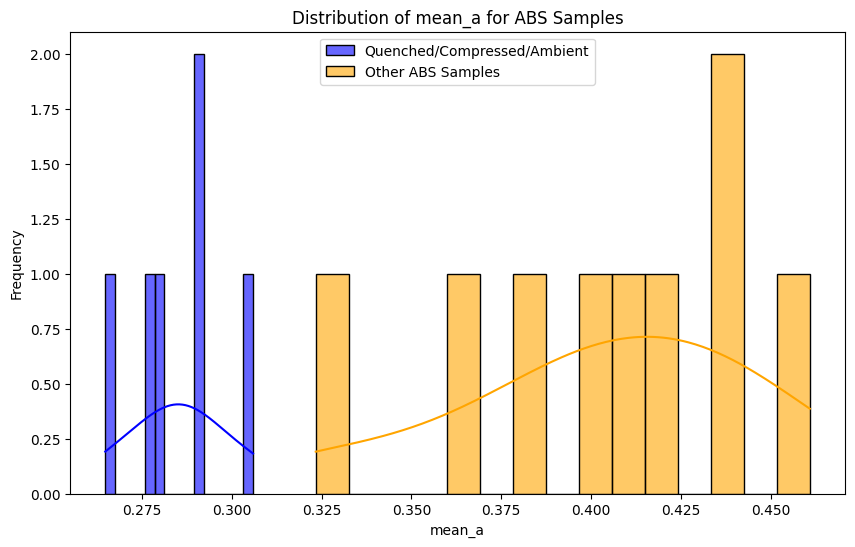

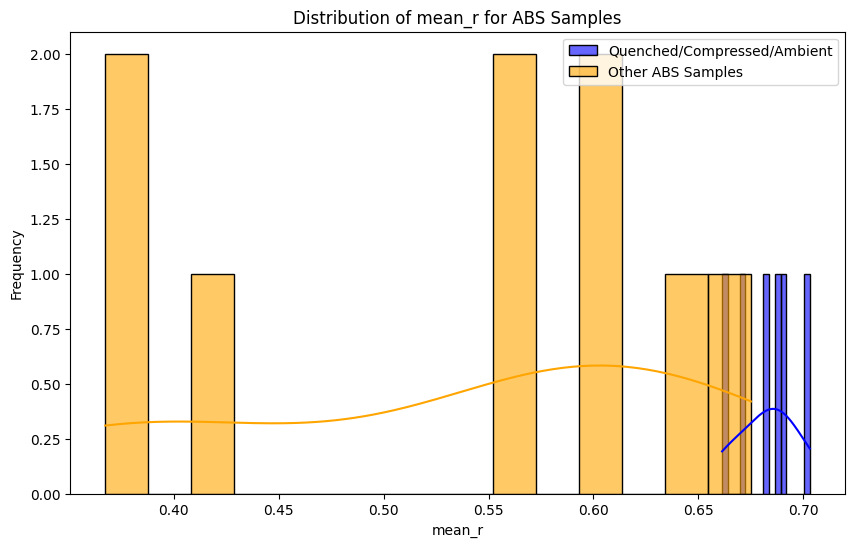

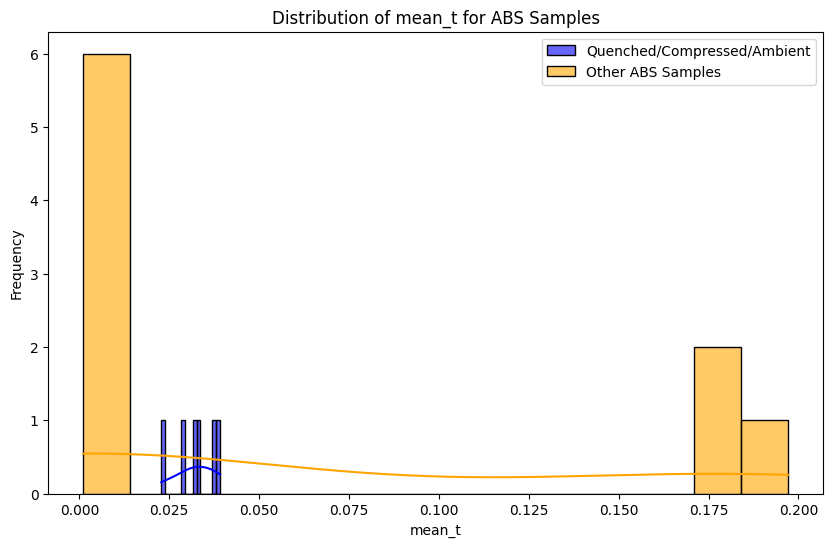

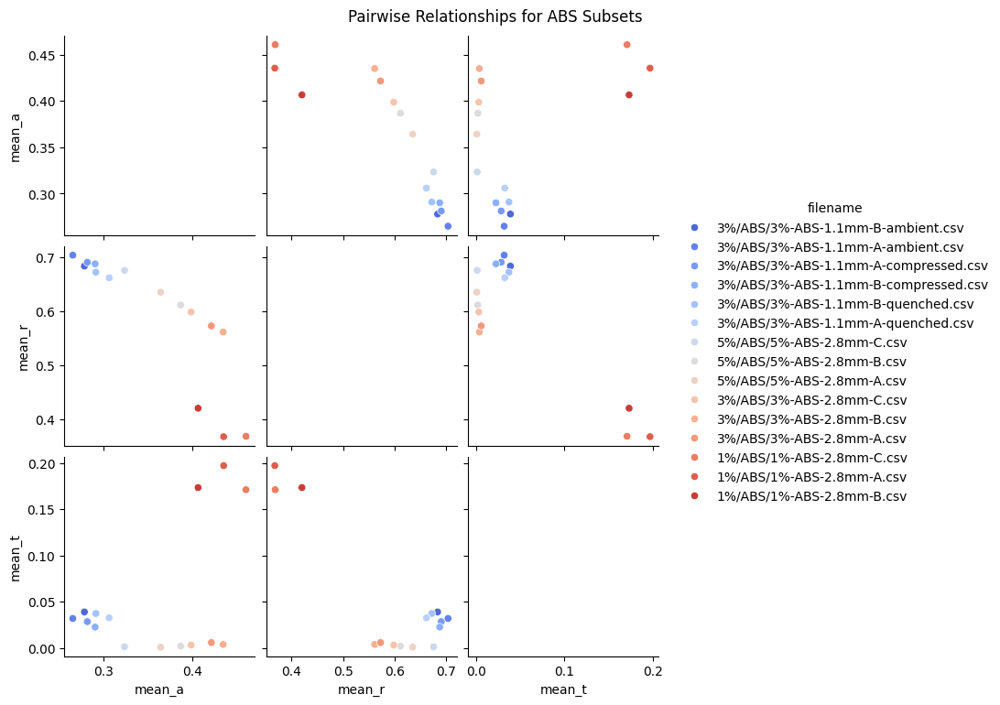

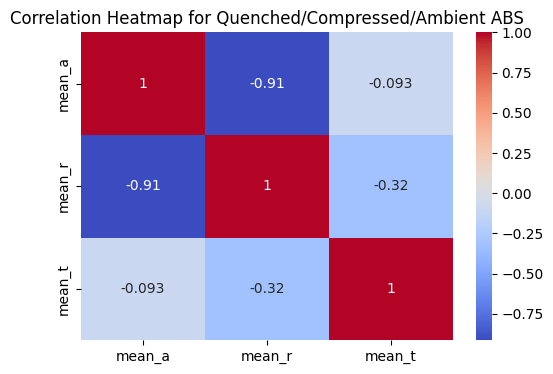

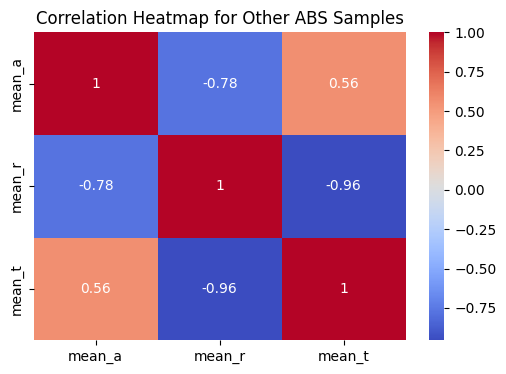

In [25]:
def visualize_ABS_modalities(dataframe):

  # Create subsets
  quenched_compressed_ambient_files = [
      '3%-ABS-1.1mm-B-quenched',
      '3%-ABS-1.1mm-B-compressed',
      '3%-ABS-1.1mm-B-ambient',
      '3%-ABS-1.1mm-A-quenched',
      '3%-ABS-1.1mm-A-compressed',
      '3%-ABS-1.1mm-A-ambient'
  ]

  abs_quenched_compressed = dataframe[dataframe['filename'].str.contains('|'.join(quenched_compressed_ambient_files))]
  abs_other = dataframe[(dataframe['material'] == 'ABS') & (~dataframe['filename'].str.contains('|'.join(quenched_compressed_ambient_files)))]

  def plot_histograms_with_kde(feature):
      plt.figure(figsize=(10, 6))
      sns.histplot(abs_quenched_compressed[feature], kde=True, color='blue', label='Quenched/Compressed/Ambient', bins=15, alpha=0.6)
      sns.histplot(abs_other[feature], kde=True, color='orange', label='Other ABS Samples', bins=15, alpha=0.6)
      plt.title(f'Distribution of {feature} for ABS Samples')
      plt.xlabel(feature)
      plt.ylabel('Frequency')
      plt.legend()
      plt.show()

  # Plot distributions
  for feature in ['mean_a', 'mean_r', 'mean_t']:
      plot_histograms_with_kde(feature)

  sns.pairplot(
      pd.concat([abs_quenched_compressed, abs_other]),
      vars=['mean_a', 'mean_r', 'mean_t'],
      hue='filename',
      palette='coolwarm',
      diag_kind='kde'
  )
  plt.suptitle('Pairwise Relationships for ABS Subsets', y=1.02)
  plt.show()

  for subset, name in [(abs_quenched_compressed, 'Quenched/Compressed/Ambient ABS'), (abs_other, 'Other ABS Samples')]:
      corr_matrix = subset[['mean_a', 'mean_r', 'mean_t']].corr()
      plt.figure(figsize=(6, 4))
      sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', cbar=True)
      plt.title(f'Correlation Heatmap for {name}')
      plt.show()

  return

visualize_ABS_modalities(thesis_df)

## Predicting Material Properties from Frequency, CNT, Thickness, and Material

XGBoost

In [15]:
import xgboost as xgb
import numpy as np
import pandas as pd
from sklearn.model_selection import KFold
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

def train_xgboost_with_cv(material_df, n_splits=5, random_state=42):
    """
    Trains an XGBoost model using 5-fold cross-validation on the given material properties dataset.

    Args:
        material_df (DataFrame): The dataset containing material properties.
        n_splits (int): Number of folds for cross-validation.
        random_state (int): Random seed for reproducibility.

    Returns:
        dict: Dictionary containing RMSE, MAE, and R² scores for each material property.
    """

    # 🚀 Extract Features and Target Variables
    X = material_df[['frequency', 'cnt_pct', 'thickness', 'material']].copy()
    y = material_df[['epsilon_real', 'epsilon_imag', 'mu_real', 'mu_imag']].copy()

    # 🚀 Encode Categorical Features (One-Hot Encoding)
    encoder = OneHotEncoder(drop='first', sparse_output=False)
    material_encoded = encoder.fit_transform(X[['material']])

    # 🚀 Combine Encoded Features with Numerical Features
    X_encoded = np.hstack((X[['frequency', 'cnt_pct', 'thickness']].values, material_encoded))

    # 🚀 Standardize Features
    scaler_X = StandardScaler()
    scaler_y = StandardScaler()

    X_scaled = scaler_X.fit_transform(X_encoded)
    y_scaled = scaler_y.fit_transform(y)

    # 🚀 Initialize Metrics Storage
    results = {prop: {'RMSE': [], 'MAE': [], 'R²': []} for prop in y.columns}

    # 🚀 Perform 5-Fold Cross-Validation
    kf = KFold(n_splits=n_splits, shuffle=True, random_state=random_state)

    for train_index, test_index in kf.split(X_scaled):
        X_train, X_test = X_scaled[train_index], X_scaled[test_index]

        # 🚀 Train a Separate Model for Each Output Variable
        for i, prop in enumerate(y.columns):
            y_train, y_test = y_scaled[train_index, i], y_scaled[test_index, i]

            # Define XGBoost model
            model = xgb.XGBRegressor(
                objective='reg:squarederror',
                n_estimators=100,
                learning_rate=0.05,
                max_depth=6,
                subsample=0.8,
                colsample_bytree=0.8,
                random_state=random_state
            )

            # Train the model
            model.fit(X_train, y_train)

            # Make Predictions
            y_pred = model.predict(X_test)

            # Compute Metrics
            rmse = np.sqrt(mean_squared_error(y_test, y_pred))
            mae = mean_absolute_error(y_test, y_pred)
            r2 = r2_score(y_test, y_pred)

            # Store Results
            results[prop]['RMSE'].append(rmse)
            results[prop]['MAE'].append(mae)
            results[prop]['R²'].append(r2)

    # 🚀 Aggregate Results Across Folds
    final_results = {}
    for prop in results:
        final_results[prop] = {
            'RMSE': np.mean(results[prop]['RMSE']),
            'MAE': np.mean(results[prop]['MAE']),
            'R²': np.mean(results[prop]['R²'])
        }

    return final_results

xgboost_results = train_xgboost_with_cv(material_df)
print("🚀 XGBoost Cross-Validation Results:")
for prop, metrics in xgboost_results.items():
    print(f"\n📌 {prop}:")
    print(f"   - RMSE: {metrics['RMSE']:.4f}")
    print(f"   - MAE: {metrics['MAE']:.4f}")
    print(f"   - R² Score: {metrics['R²']:.4f}")


🚀 XGBoost Cross-Validation Results:

📌 epsilon_real:
   - RMSE: 0.6671
   - MAE: 0.2461
   - R² Score: 0.5505

📌 epsilon_imag:
   - RMSE: 0.5510
   - MAE: 0.2016
   - R² Score: 0.6957

📌 mu_real:
   - RMSE: 1.0498
   - MAE: 0.3007
   - R² Score: -0.1130

📌 mu_imag:
   - RMSE: 0.9711
   - MAE: 0.2757
   - R² Score: 0.0432


In [16]:
import xgboost as xgb
import numpy as np
import pandas as pd
from sklearn.model_selection import KFold
from sklearn.preprocessing import OneHotEncoder, StandardScaler, PolynomialFeatures
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from itertools import product

def fourier_features(frequency, order=3):
    """Generate Fourier features for frequency."""
    features = []
    for i in range(1, order + 1):
        features.append(np.sin(2 * np.pi * i * frequency))
        features.append(np.cos(2 * np.pi * i * frequency))
    return np.column_stack(features)

def train_xgboost_with_cv(material_df, n_splits=5, random_state=42, fourier_order=3, poly_degree=2):
    """
    Trains an XGBoost model using 5-fold cross-validation with improved features.

    Args:
        material_df (DataFrame): The dataset containing material properties.
        n_splits (int): Number of folds for cross-validation.
        random_state (int): Random seed for reproducibility.
        fourier_order (int): Order of Fourier features for frequency representation.
        poly_degree (int): Degree of polynomial feature interactions.

    Returns:
        dict: Dictionary containing RMSE, MAE, and R² scores for each material property.
    """

    # 🚀 Extract Features and Targets
    X = material_df[['frequency', 'cnt_pct', 'thickness', 'material']].copy()
    y = material_df[['epsilon_real', 'epsilon_imag', 'mu_real', 'mu_imag']].copy()

    # 🚀 Encode Categorical Features (One-Hot Encoding)
    encoder = OneHotEncoder(drop='first', sparse_output=False)
    material_encoded = encoder.fit_transform(X[['material']])

    # 🚀 Generate Fourier Features
    fourier_feats = fourier_features(X['frequency'].values, order=fourier_order)

    # 🚀 Generate Polynomial Features (Without Categorical Variables)
    poly = PolynomialFeatures(degree=poly_degree, include_bias=False)
    poly_feats = poly.fit_transform(X[['frequency', 'cnt_pct', 'thickness']])

    # 🚀 Combine All Features
    X_encoded = np.hstack((X[['frequency', 'cnt_pct', 'thickness']].values, fourier_feats, poly_feats, material_encoded))

    # 🚀 Standardize Features
    scaler_X = StandardScaler()
    scaler_y = StandardScaler()

    X_scaled = scaler_X.fit_transform(X_encoded)
    y_scaled = scaler_y.fit_transform(y)

    # 🚀 Train Separate Models for Each Material
    results = {}
    for material in material_df['material'].unique():
        print(f"\n🚀 Training for material: {material}")

        # 🚀 Filter Data for This Material
        material_mask = (X['material'] == material)
        X_mat = X_scaled[material_mask]
        y_mat = y_scaled[material_mask]

        # 🚀 Initialize Storage for Metrics
        results[material] = {prop: {'RMSE': [], 'MAE': [], 'R²': []} for prop in y.columns}

        # 🚀 Perform 5-Fold Cross-Validation
        kf = KFold(n_splits=n_splits, shuffle=True, random_state=random_state)

        for train_index, test_index in kf.split(X_mat):
            X_train, X_test = X_mat[train_index], X_mat[test_index]

            # 🚀 Tune Hyperparameters
            best_hyperparams = {}
            for param_combo in product([3, 6, 9], [100, 300], [0.01, 0.05, 0.1]):
                max_depth, n_estimators, learning_rate = param_combo
                total_r2 = 0

                for i, prop in enumerate(y.columns):
                    y_train, y_test = y_mat[train_index, i], y_mat[test_index, i]

                    model = xgb.XGBRegressor(
                        objective='reg:squarederror',
                        n_estimators=n_estimators,
                        learning_rate=learning_rate,
                        max_depth=max_depth,
                        subsample=0.8,
                        colsample_bytree=0.8,
                        random_state=random_state
                    )
                    model.fit(X_train, y_train)
                    y_pred = model.predict(X_test)
                    total_r2 += r2_score(y_test, y_pred)

                avg_r2 = total_r2 / len(y.columns)
                best_hyperparams[(max_depth, n_estimators, learning_rate)] = avg_r2

            # 🚀 Select Best Hyperparameters
            best_params = max(best_hyperparams, key=best_hyperparams.get)
            max_depth, n_estimators, learning_rate = best_params

            # 🚀 Train Final Model with Best Hyperparameters
            for i, prop in enumerate(y.columns):
                y_train, y_test = y_mat[train_index, i], y_mat[test_index, i]

                model = xgb.XGBRegressor(
                    objective='reg:squarederror',
                    n_estimators=n_estimators,
                    learning_rate=learning_rate,
                    max_depth=max_depth,
                    subsample=0.8,
                    colsample_bytree=0.8,
                    random_state=random_state
                )

                model.fit(X_train, y_train)
                y_pred = model.predict(X_test)

                # 🚀 Compute Metrics
                rmse = np.sqrt(mean_squared_error(y_test, y_pred))
                mae = mean_absolute_error(y_test, y_pred)
                r2 = r2_score(y_test, y_pred)

                # 🚀 Store Results
                results[material][prop]['RMSE'].append(rmse)
                results[material][prop]['MAE'].append(mae)
                results[material][prop]['R²'].append(r2)

    # 🚀 Aggregate Results Across Folds
    final_results = {}
    for material in results:
        final_results[material] = {}
        for prop in results[material]:
            final_results[material][prop] = {
                'RMSE': np.mean(results[material][prop]['RMSE']),
                'MAE': np.mean(results[material][prop]['MAE']),
                'R²': np.mean(results[material][prop]['R²'])
            }

    return final_results

xgboost_results = train_xgboost_with_cv(material_df)
print("🚀 Improved XGBoost Cross-Validation Results:")
for material, props in xgboost_results.items():
    print(f"\n🔹 Material: {material}")
    for prop, metrics in props.items():
        print(f"   📌 {prop}:")
        print(f"      - RMSE: {metrics['RMSE']:.4f}")
        print(f"      - MAE: {metrics['MAE']:.4f}")
        print(f"      - R² Score: {metrics['R²']:.4f}")



🚀 Training for material: PBT

🚀 Training for material: ABS
🚀 Improved XGBoost Cross-Validation Results:

🔹 Material: PBT
   📌 epsilon_real:
      - RMSE: 0.7732
      - MAE: 0.2830
      - R² Score: 0.5889
   📌 epsilon_imag:
      - RMSE: 0.6785
      - MAE: 0.2826
      - R² Score: 0.5494
   📌 mu_real:
      - RMSE: 1.2994
      - MAE: 0.4623
      - R² Score: -0.0146
   📌 mu_imag:
      - RMSE: 1.1988
      - MAE: 0.4385
      - R² Score: 0.1373

🔹 Material: ABS
   📌 epsilon_real:
      - RMSE: 0.2919
      - MAE: 0.1792
      - R² Score: 0.4985
   📌 epsilon_imag:
      - RMSE: 0.3768
      - MAE: 0.3350
      - R² Score: 0.8391
   📌 mu_real:
      - RMSE: 0.0000
      - MAE: 0.0000
      - R² Score: -16548786161789306.0000
   📌 mu_imag:
      - RMSE: 0.0000
      - MAE: 0.0000
      - R² Score: 0.0000


In [20]:
material_df

,frequency,epsilon_real,epsilon_imag,mu_real,mu_imag,cnt_pct,material,thickness
0,1.240000e+10,12.70,6.38,1.0,0.00E+00,4,PBT,2.0
1,1.245657e+10,12.40,6.13,1.0,0.00E+00,4,PBT,2.0
2,1.251313e+10,12.60,6.13,1.0,0.00E+00,4,PBT,2.0
3,1.256970e+10,12.40,5.99,1.0,0.00E+00,4,PBT,2.0
4,1.262626e+10,12.60,6.19,1.0,0.00E+00,4,PBT,2.0
...,...,...,...,...,...,...,...,...
3754,1.777374e+10,6.17,4.59,1.0,0.00E+00,2,PBT,2.0
3755,1.783030e+10,6.15,4.74,1.0,0.00E+00,2,PBT,2.0
3756,1.788687e+10,6.17,4.53,1.0,0.00E+00,2,PBT,2.0
3757,1.794343e+10,6.09,4.63,1.0,0.00E+00,2,PBT,2.0


In [19]:
material_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 3700 entries, 0 to 3758
Data columns (total 8 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   frequency     3700 non-null   float64
 1   epsilon_real  3700 non-null   float64
 2   epsilon_imag  3700 non-null   float64
 3   mu_real       3700 non-null   object 
 4   mu_imag       3700 non-null   object 
 5   cnt_pct       3700 non-null   int64  
 6   material      3700 non-null   object 
 7   thickness     3700 non-null   float64
dtypes: float64(4), int64(1), object(3)
memory usage: 260.2+ KB


Unique values in mu_real: [1.]
Unique values in mu_real: [0.]
Unique values in mu_real: [1.    0.623 0.618 0.612 0.62  0.616 0.609 0.621 0.598 0.597 0.608 0.6
 0.613 0.601 0.592 0.61  0.65  0.649 0.648 0.642 0.632 0.672 1.45  1.5
 1.4   1.44  1.42  1.49  1.47  2.25  2.23  2.27  2.3   2.26  2.28  2.31
 2.22  2.24  2.2   2.15  2.18  2.17  2.21  2.14  2.16  2.13  2.11  2.19
 2.12  2.09  2.06  2.08  2.03  2.07  2.05  0.403 0.41  0.398 0.419 0.389
 0.405 0.371 0.401 0.361 0.415 0.363 0.39  0.358 0.396 0.402 0.406 0.378
 0.431 0.394 0.368 0.432 0.449 0.379 0.391 0.365 0.367 0.353 0.327 0.335
 0.308 0.342 0.309 0.338 0.267 0.318 0.269 0.307 0.266 0.293 0.255 0.272
 0.263 0.271 0.273 0.29  0.279 0.295 0.292 0.303 0.265 0.311 0.27  0.321
 0.248 0.291 0.286 0.259 0.277 0.253 0.288 0.25  0.246 0.26  0.268 0.239
 0.252 0.233 0.264 0.235 0.223 0.238 0.278 0.28  0.274 0.968 0.962 0.953
 0.956 0.942 0.947 0.931 0.941 0.915 0.946 0.912 0.932 0.899 0.928 0.91
 0.926 0.913 0.905 0.898 0.906 0.88  0.896 

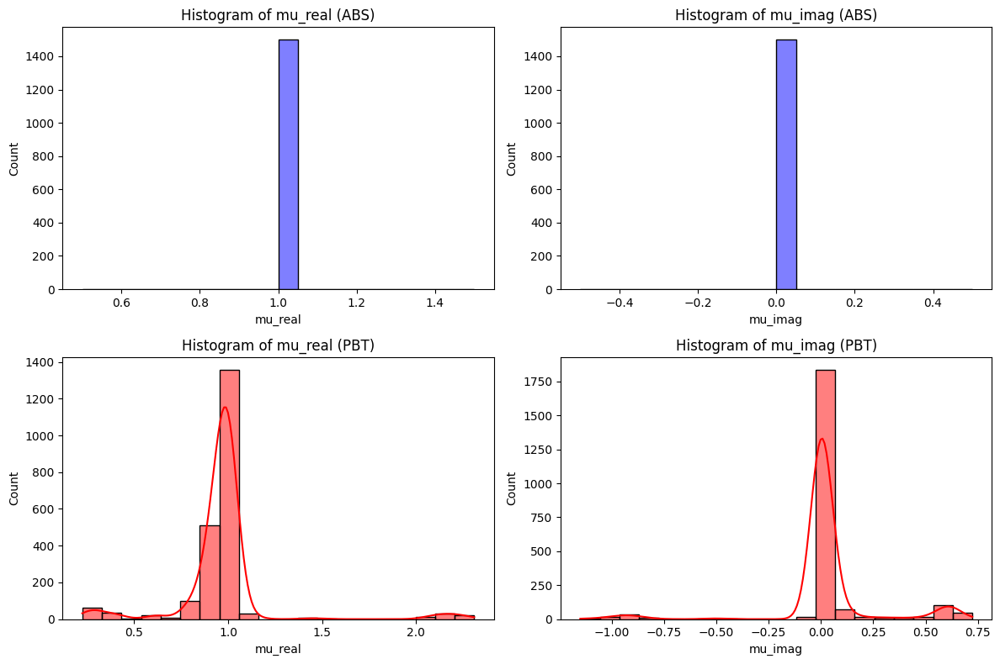

In [22]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# ✅ Step 1: Convert mu_real and mu_imag to float, replacing errors
material_df['mu_real'] = pd.to_numeric(material_df['mu_real'], errors='coerce')
material_df['mu_imag'] = pd.to_numeric(material_df['mu_imag'], errors='coerce')

# ✅ Step 2: Check for missing or unusual values
#print("Unique values in mu_real:", material_df['mu_real'].unique())
#print("Unique values in mu_imag:", material_df['mu_imag'].unique())

# 🚀 Step 3: Re-run the histogram function
def plot_mu_histograms(material_df):
    """
    Plots histograms of mu_real and mu_imag for ABS and PBT separately.
    Handles missing values and ensures data is numeric.
    """
    # Filter data for ABS and PBT
    abs_data = material_df[material_df['material'] == 'ABS']
    pbt_data = material_df[material_df['material'] == 'PBT']

    print("Unique values in mu_real:", abs_data['mu_real'].unique())
    print("Unique values in mu_real:", abs_data['mu_imag'].unique())
    print("Unique values in mu_real:", pbt_data['mu_real'].unique())
    print("Unique values in mu_imag:", pbt_data['mu_imag'].unique())

    # Create histograms for mu_real and mu_imag
    fig, axes = plt.subplots(2, 2, figsize=(12, 8))

    sns.histplot(abs_data['mu_real'].dropna(), bins=20, kde=True, ax=axes[0, 0], color='blue')
    axes[0, 0].set_title('Histogram of mu_real (ABS)')

    sns.histplot(abs_data['mu_imag'].dropna(), bins=20, kde=True, ax=axes[0, 1], color='blue')
    axes[0, 1].set_title('Histogram of mu_imag (ABS)')

    sns.histplot(pbt_data['mu_real'].dropna(), bins=20, kde=True, ax=axes[1, 0], color='red')
    axes[1, 0].set_title('Histogram of mu_real (PBT)')

    sns.histplot(pbt_data['mu_imag'].dropna(), bins=20, kde=True, ax=axes[1, 1], color='red')
    axes[1, 1].set_title('Histogram of mu_imag (PBT)')

    plt.tight_layout()
    plt.show()

# Run the function again after fixing the data
plot_mu_histograms(material_df)


In [23]:
import pandas as pd

# 🚀 Filter PBT samples with negative mu_imag
pbt_negative_mu_imag = material_df[(material_df['material'] == 'PBT') & (material_df['mu_imag'] < 0)]

# 🚀 Display unique sample combinations (CNT % and thickness)
unique_pbt_samples = pbt_negative_mu_imag[['cnt_pct', 'thickness']].drop_duplicates()

# 🚀 Print the result
print("📌 PBT Sample Combinations with Negative mu_imag:")
print(unique_pbt_samples)


📌 PBT Sample Combinations with Negative mu_imag:
      cnt_pct  thickness
132         5        2.8
1703        3        2.8
2431        1        0.6
2533        1        0.9
2636        1        1.1
2739        1        1.5
2929        1        2.0
2945        1        1.2


LSTMs

In [38]:
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
import torch.optim as optim
from sklearn.preprocessing import StandardScaler
from torch.utils.data import DataLoader, TensorDataset

# 🚀 Filter data for ABS and PBT
pbt_data = material_df[material_df['material'] == 'PBT']
abs_data = material_df[material_df['material'] == 'ABS']

# 🚀 Function to prepare LSTM input data
def prepare_lstm_data(df, target_cols, sequence_length=100):
    """
    Converts a material dataset into a format suitable for LSTM training.

    Args:
        df (DataFrame): Data containing frequency-dependent material properties.
        target_cols (list): List of properties to predict.
        sequence_length (int): Number of frequency points per sample.

    Returns:
        X (Tensor): Input features.
        y (Tensor): Target properties.
    """
    # 🚀 Normalize input features
    scaler_X = StandardScaler()
    scaler_y = StandardScaler()

    X = df[['cnt_pct', 'thickness']].values  # Material-level properties
    y = df[target_cols].values  # Frequency-dependent properties

    X_scaled = scaler_X.fit_transform(X)
    y_scaled = scaler_y.fit_transform(y)

    # 🚀 Reshape data into sequences
    num_samples = len(df) // sequence_length
    X_seq = np.repeat(X_scaled[:num_samples], sequence_length, axis=0).reshape(num_samples, sequence_length, -1)
    y_seq = y_scaled[:num_samples * sequence_length].reshape(num_samples, sequence_length, -1)

    return torch.tensor(X_seq, dtype=torch.float32), torch.tensor(y_seq, dtype=torch.float32)

# 🚀 Prepare data for PBT (Predicts `ε_real`, `ε_imag`, `μ_real`, `μ_imag`)
X_pbt, y_pbt = prepare_lstm_data(pbt_data, ['epsilon_real', 'epsilon_imag', 'mu_real', 'mu_imag'])

# 🚀 Prepare data for ABS (Predicts `ε_real`, `ε_imag` only)
X_abs, y_abs = prepare_lstm_data(abs_data, ['epsilon_real', 'epsilon_imag'])

class LSTMModel(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, num_layers=2):
        super(LSTMModel, self).__init__()
        self.lstm = nn.LSTM(input_size, hidden_size, num_layers, batch_first=True)
        self.fc = nn.Linear(hidden_size, output_size)

    def forward(self, x):
        lstm_out, _ = self.lstm(x)
        output = self.fc(lstm_out)
        return output

# 🚀 Define models
hidden_size = 64
num_layers = 2

# PBT Model: 2 input features (`cnt_pct`, `thickness`), 4 outputs (`ε_real`, `ε_imag`, `μ_real`, `μ_imag`)
pbt_model = LSTMModel(input_size=2, hidden_size=hidden_size, output_size=4, num_layers=num_layers)

# ABS Model: 2 input features (`cnt_pct`, `thickness`), 2 outputs (`ε_real`, `ε_imag`)
abs_model = LSTMModel(input_size=2, hidden_size=hidden_size, output_size=2, num_layers=num_layers)

def train_lstm(model, X_train, y_train, epochs=100, batch_size=32, lr=0.001):
    """
    Trains an LSTM model for material property prediction.

    Args:
        model (nn.Module): The LSTM model.
        X_train (Tensor): Input features.
        y_train (Tensor): Target outputs.
        epochs (int): Number of training epochs.
        batch_size (int): Batch size for training.
        lr (float): Learning rate.
    """
    dataset = TensorDataset(X_train, y_train)
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

    optimizer = optim.Adam(model.parameters(), lr=lr)
    criterion = nn.MSELoss()

    model.train()
    for epoch in range(epochs):
        total_loss = 0
        for X_batch, y_batch in dataloader:
            optimizer.zero_grad()
            output = model(X_batch)
            loss = criterion(output, y_batch)
            loss.backward()
            optimizer.step()
            total_loss += loss.item()

        if (epoch + 1) % 10 == 0:
            print(f"Epoch [{epoch+1}/{epochs}], Loss: {total_loss / len(dataloader):.6f}")

# 🚀 Train models
print("Training LSTM for PBT...")
train_lstm(pbt_model, X_pbt, y_pbt)

print("Training LSTM for ABS...")
train_lstm(abs_model, X_abs, y_abs)

def predict_lstm(model, X_test):
    """
    Generates predictions using a trained LSTM model.

    Args:
        model (nn.Module): Trained LSTM model.
        X_test (Tensor): Input features.

    Returns:
        Tensor: Predicted material properties.
    """
    model.eval()
    with torch.no_grad():
        return model(X_test)

# 🚀 Make predictions
y_pred_pbt = predict_lstm(pbt_model, X_pbt)
y_pred_abs = predict_lstm(abs_model, X_abs)

print("Predictions for PBT:", y_pred_pbt.shape)
print("Predictions for ABS:", y_pred_abs.shape)


Training LSTM for PBT...
Epoch [10/100], Loss: 1.000381
Epoch [20/100], Loss: 0.999888
Epoch [30/100], Loss: 0.999850
Epoch [40/100], Loss: 0.999820
Epoch [50/100], Loss: 0.999738
Epoch [60/100], Loss: 0.999538
Epoch [70/100], Loss: 0.997564
Epoch [80/100], Loss: 0.996454
Epoch [90/100], Loss: 0.995327
Epoch [100/100], Loss: 0.995243
Training LSTM for ABS...
Epoch [10/100], Loss: 1.001223
Epoch [20/100], Loss: 0.997997
Epoch [30/100], Loss: 0.986275
Epoch [40/100], Loss: 1.125988
Epoch [50/100], Loss: 0.943745
Epoch [60/100], Loss: 0.946795
Epoch [70/100], Loss: 0.938906
Epoch [80/100], Loss: 0.906434
Epoch [90/100], Loss: 0.965866
Epoch [100/100], Loss: 0.953701
Predictions for PBT: torch.Size([22, 100, 4])
Predictions for ABS: torch.Size([15, 100, 2])


In [39]:
from sklearn.metrics import mean_squared_error, r2_score
import numpy as np
import pandas as pd

# 🚀 Compute RMSE and R² for LSTM Models
def evaluate_lstm(y_true, y_pred, properties):
    """
    Computes RMSE and R² score for LSTM predictions.

    Args:
        y_true (Tensor): True values.
        y_pred (Tensor): Predicted values.
        properties (list): List of properties being predicted.

    Returns:
        DataFrame: RMSE and R² scores for each output property.
    """
    y_true_np = y_true.numpy().reshape(-1, y_true.shape[-1])  # Flatten sequences
    y_pred_np = y_pred.numpy().reshape(-1, y_pred.shape[-1])  # Flatten sequences

    results = {}
    for i, prop in enumerate(properties):
        rmse = np.sqrt(mean_squared_error(y_true_np[:, i], y_pred_np[:, i]))
        r2 = r2_score(y_true_np[:, i], y_pred_np[:, i])
        results[prop] = {"RMSE": rmse, "R²": r2}

    return pd.DataFrame(results).T

# 🚀 Evaluate PBT LSTM Model
pbt_properties = ["epsilon_real", "epsilon_imag", "mu_real", "mu_imag"]
pbt_lstm_results = evaluate_lstm(y_pbt, y_pred_pbt, pbt_properties)

# 🚀 Evaluate ABS LSTM Model
abs_properties = ["epsilon_real", "epsilon_imag"]
abs_lstm_results = evaluate_lstm(y_abs, y_pred_abs, abs_properties)

# 🚀 Print Results
print("🚀 PBT LSTM Evaluation:")
print(pbt_lstm_results)
print("\n🚀 ABS LSTM Evaluation:")
print(abs_lstm_results)


🚀 PBT LSTM Evaluation:
                  RMSE        R²
epsilon_real  0.998518  0.002961
epsilon_imag  0.999630  0.000740
mu_real       0.997598  0.004798
mu_imag       0.994687  0.010598

🚀 ABS LSTM Evaluation:
                  RMSE        R²
epsilon_real  0.945531  0.105971
epsilon_imag  0.999992  0.000016


Transformers

In [16]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold
import numpy as np
import pandas as pd
from sklearn.metrics import mean_squared_error, r2_score

# 🚀 Filter data for ABS and PBT
pbt_data = material_df[material_df['material'] == 'PBT']
abs_data = material_df[material_df['material'] == 'ABS']

# 🚀 Function to prepare Transformer input data
def prepare_transformer_data(df, target_cols, sequence_length=100):
    """
    Converts a material dataset into a format suitable for Transformer training.

    Args:
        df (DataFrame): Data containing frequency-dependent material properties.
        target_cols (list): List of properties to predict.
        sequence_length (int): Number of frequency points per sample.

    Returns:
        X (Tensor): Input features.
        y (Tensor): Target properties.
    """
    # 🚀 Normalize input features
    scaler_X = StandardScaler()
    scaler_y = StandardScaler()

    X = df[['cnt_pct', 'thickness']].values  # Material-level properties
    y = df[target_cols].values  # Frequency-dependent properties

    X_scaled = scaler_X.fit_transform(X)
    y_scaled = scaler_y.fit_transform(y)

    # 🚀 Reshape data into sequences
    num_samples = len(df) // sequence_length
    X_seq = np.repeat(X_scaled[:num_samples], sequence_length, axis=0).reshape(num_samples, sequence_length, -1)
    y_seq = y_scaled[:num_samples * sequence_length].reshape(num_samples, sequence_length, -1)

    return torch.tensor(X_seq, dtype=torch.float32), torch.tensor(y_seq, dtype=torch.float32)

# 🚀 Prepare data for PBT (Predicts `ε_real`, `ε_imag`, `μ_real`, `μ_imag`)
X_pbt, y_pbt = prepare_transformer_data(pbt_data, ['epsilon_real', 'epsilon_imag', 'mu_real', 'mu_imag'])

# 🚀 Prepare data for ABS (Predicts `ε_real`, `ε_imag` only)
X_abs, y_abs = prepare_transformer_data(abs_data, ['epsilon_real', 'epsilon_imag'])

class TransformerModel(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, num_layers=2, num_heads=4):
        super(TransformerModel, self).__init__()
        self.embedding = nn.Linear(input_size, hidden_size)  # Linear embedding for input
        self.transformer = nn.TransformerEncoder(
            nn.TransformerEncoderLayer(d_model=hidden_size, nhead=num_heads, dim_feedforward=hidden_size * 2),
            num_layers=num_layers
        )
        self.fc = nn.Linear(hidden_size, output_size)  # Fully connected layer for output

    def forward(self, x):
        x = self.embedding(x)
        x = self.transformer(x)
        output = self.fc(x)
        return output

# 🚀 Define models
hidden_size = 64
num_layers = 2
num_heads = 4

# PBT Model: 2 input features (`cnt_pct`, `thickness`), 4 outputs (`ε_real`, `ε_imag`, `μ_real`, `μ_imag`)
pbt_model = TransformerModel(input_size=2, hidden_size=hidden_size, output_size=4, num_layers=num_layers, num_heads=num_heads)

# ABS Model: 2 input features (`cnt_pct`, `thickness`), 2 outputs (`ε_real`, `ε_imag`)
abs_model = TransformerModel(input_size=2, hidden_size=hidden_size, output_size=2, num_layers=num_layers, num_heads=num_heads)

def train_transformer_with_cv(model, X, y, n_splits=5, epochs=100, batch_size=32, lr=0.001):
    """
    Trains a Transformer model using 5-fold cross-validation and evaluates RMSE & R².

    Args:
        model (nn.Module): Transformer model.
        X (Tensor): Input features.
        y (Tensor): Target outputs.
        n_splits (int): Number of folds for cross-validation.
        epochs (int): Number of training epochs.
        batch_size (int): Batch size for training.
        lr (float): Learning rate.

    Returns:
        dict: RMSE and R² scores for each material property.
    """
    kf = KFold(n_splits=n_splits, shuffle=True, random_state=42)

    results = {
        prop: {'RMSE': [], 'R²': []}
        for prop in (
            ["epsilon_real", "epsilon_imag", "mu_real", "mu_imag"]
            if y.shape[-1] == 4
            else ["epsilon_real", "epsilon_imag"]
        )
    }
    for train_index, test_index in kf.split(X):
        X_train, X_test = X[train_index], X[test_index]
        y_train, y_test = y[train_index], y[test_index]

        dataset = TensorDataset(X_train, y_train)
        dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

        optimizer = optim.Adam(model.parameters(), lr=lr)
        criterion = nn.MSELoss()

        model.train()
        for epoch in range(epochs):
            total_loss = 0
            for X_batch, y_batch in dataloader:
                optimizer.zero_grad()
                output = model(X_batch)
                loss = criterion(output, y_batch)
                loss.backward()
                optimizer.step()
                total_loss += loss.item()

            if (epoch + 1) % 10 == 0:
                print(f"Epoch [{epoch+1}/{epochs}], Loss: {total_loss / len(dataloader):.6f}")

        # 🚀 Evaluate Model
        model.eval()
        with torch.no_grad():
            y_pred = model(X_test)

        # 🚀 Compute Metrics
        y_true_np = y_test.numpy().reshape(-1, y_test.shape[-1])
        y_pred_np = y_pred.numpy().reshape(-1, y_pred.shape[-1])

        for i, prop in enumerate(results.keys()):
            rmse = np.sqrt(mean_squared_error(y_true_np[:, i], y_pred_np[:, i]))
            r2 = r2_score(y_true_np[:, i], y_pred_np[:, i])
            results[prop]['RMSE'].append(rmse)
            results[prop]['R²'].append(r2)

    # 🚀 Aggregate Results Across Folds
    final_results = {prop: {'RMSE': np.mean(results[prop]['RMSE']), 'R²': np.mean(results[prop]['R²'])} for prop in results}
    return final_results

# 🚀 Train and Evaluate PBT Transformer
print("Training Transformer for PBT...")
pbt_transformer_results = train_transformer_with_cv(pbt_model, X_pbt, y_pbt)

# 🚀 Train and Evaluate ABS Transformer
print("Training Transformer for ABS...")
abs_transformer_results = train_transformer_with_cv(abs_model, X_abs, y_abs)

# 🚀 Print Results
print("\n🚀 PBT Transformer Evaluation:")
print(pd.DataFrame(pbt_transformer_results).T)

print("\n🚀 ABS Transformer Evaluation:")
print(pd.DataFrame(abs_transformer_results).T)


Training Transformer for PBT...
Epoch [10/100], Loss: 0.337881
Epoch [20/100], Loss: 0.315410
Epoch [30/100], Loss: 0.317734
Epoch [40/100], Loss: 0.312379
Epoch [50/100], Loss: 0.314326
Epoch [60/100], Loss: 0.313636
Epoch [70/100], Loss: 0.312826
Epoch [80/100], Loss: 0.310057
Epoch [90/100], Loss: 0.310583
Epoch [100/100], Loss: 0.309386
Epoch [10/100], Loss: 1.060834
Epoch [20/100], Loss: 1.049018
Epoch [30/100], Loss: 1.048378
Epoch [40/100], Loss: 1.045866
Epoch [50/100], Loss: 1.045143
Epoch [60/100], Loss: 1.047538
Epoch [70/100], Loss: 1.046602
Epoch [80/100], Loss: 1.045912
Epoch [90/100], Loss: 1.048151
Epoch [100/100], Loss: 1.045161
Epoch [10/100], Loss: 1.207570
Epoch [20/100], Loss: 1.205234
Epoch [30/100], Loss: 1.202915
Epoch [40/100], Loss: 1.204158
Epoch [50/100], Loss: 1.204063
Epoch [60/100], Loss: 1.204407
Epoch [70/100], Loss: 1.203823
Epoch [80/100], Loss: 1.205263
Epoch [90/100], Loss: 1.203839
Epoch [100/100], Loss: 1.202726
Epoch [10/100], Loss: 1.152482
Epoc

PINNs

In [26]:
import torch
import torch.nn as nn
import torch.optim as optim
from sklearn.preprocessing import StandardScaler
import numpy as np
import torch.optim.lr_scheduler as lr_scheduler

# 🚀 Extract features and targets
pbt_data = material_df[material_df['material'] == 'PBT']
X = pbt_data[['frequency', 'cnt_pct', 'thickness']].values
y = pbt_data[['epsilon_real', 'epsilon_imag', 'mu_real', 'mu_imag']].values

# 🚀 Normalize data
scaler_X = StandardScaler()
scaler_y = StandardScaler()

X_scaled = scaler_X.fit_transform(X)
y_scaled = scaler_y.fit_transform(y)

# 🚀 Convert to PyTorch tensors
X_tensor = torch.tensor(X_scaled, dtype=torch.float32)
y_tensor = torch.tensor(y_scaled, dtype=torch.float32)

class PINN(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, num_layers=3):
        super(PINN, self).__init__()
        layers = []
        layers.append(nn.Linear(input_size, hidden_size))
        layers.append(nn.SiLU())  # Sine-like activation function (good for physics)

        for _ in range(num_layers - 1):
            layers.append(nn.Linear(hidden_size, hidden_size))
            layers.append(nn.SiLU())

        layers.append(nn.Linear(hidden_size, output_size))
        self.network = nn.Sequential(*layers)

    def forward(self, x):
        return self.network(x)

def physics_loss_final(model, X, y_true, scaler_y):
    """
    Computes a physics-informed loss function with reduced constraint penalties.
    """
    y_pred = model(X)

    # 🚀 Standard MSE Loss
    mse_loss = nn.MSELoss()(y_pred, y_true)

    # 🚀 Unscale Predictions
    y_pred_unscaled = scaler_y.inverse_transform(y_pred.detach().numpy())

    # Extract Real & Imaginary Parts
    epsilon_real, epsilon_imag, mu_real, mu_imag = y_pred_unscaled.T

    # 🚀 1. Non-Negativity Constraint (ε_imag, μ_imag ≥ 0) (Lower Penalty)
    non_negativity_penalty = 0.001 * (torch.mean(torch.relu(-y_pred[:, 1])) + torch.mean(torch.relu(-y_pred[:, 3])))

    # 🚀 2. Smoothness Constraint (Even Lower Weight)
    freq_diffs = torch.diff(X[:, 0], n=2)  # Compute second derivative wrt frequency
    smoothness_penalty = 0.001 * torch.mean(torch.abs(freq_diffs))

    # 🚀 3. Refractive Index Constraint (Lower Penalty)
    refractive_index = torch.sqrt(torch.abs(y_pred[:, 0] * y_pred[:, 2]))
    refractive_index_penalty = 0.001 * torch.mean(torch.relu(-refractive_index))

    # 🚀 4. Energy Conservation (tanδ = ε_imag / ε_real < 1) (Lower Penalty)
    tan_delta = torch.abs(y_pred[:, 1] / (y_pred[:, 0] + 1e-6))  # Avoid division by zero
    energy_loss_penalty = 0.001 * torch.mean(torch.relu(tan_delta - 1))

    # 🚀 Final Loss Function (Lowered Penalty Weights)
    total_loss = mse_loss + non_negativity_penalty + smoothness_penalty + refractive_index_penalty + energy_loss_penalty

    return total_loss

# 🚀 Adjust Model Capacity
hidden_size = 256
num_layers = 4
final_pinn_model = PINN(input_size=3, hidden_size=hidden_size, output_size=4, num_layers=num_layers)

from sklearn.model_selection import KFold
from sklearn.metrics import mean_squared_error, r2_score
import numpy as np

def train_pinn_tuned(model, X_train, y_train, scaler_y, epochs=2000, lr=0.001):
    """
    Trains the optimized PINN model with a learning rate scheduler.
    """
    optimizer = optim.Adam(model.parameters(), lr=lr)
    scheduler = lr_scheduler.StepLR(optimizer, step_size=500, gamma=0.5)  # Reduce LR after 500 epochs

    model.train()
    for epoch in range(epochs):
        optimizer.zero_grad()
        loss = physics_loss_final(model, X_train, y_train, scaler_y)
        loss.backward()
        optimizer.step()
        scheduler.step()  # Adjust learning rate

        if (epoch + 1) % 100 == 0:
            print(f"Epoch [{epoch+1}/{epochs}], Loss: {loss.item():.6f}")

def train_pinn_cv(model, X, y, scaler_y, n_splits=5, epochs=2000, lr=0.0005):
    """
    Trains the PINN model using 5-fold cross-validation and evaluates RMSE & R².

    Args:
        model (nn.Module): PINN model.
        X (Tensor): Input features.
        y (Tensor): Target outputs.
        scaler_y (StandardScaler): Scaler for target variables.
        n_splits (int): Number of folds for cross-validation.
        epochs (int): Number of training epochs.
        lr (float): Learning rate.

    Returns:
        dict: RMSE and R² scores for each material property.
    """
    kf = KFold(n_splits=n_splits, shuffle=True, random_state=42)

    results = {prop: {'RMSE': [], 'R²': []} for prop in ["epsilon_real", "epsilon_imag", "mu_real", "mu_imag"]}

    for fold, (train_index, test_index) in enumerate(kf.split(X)):
        print(f"🚀 Training Fold {fold+1}/{n_splits}")

        X_train, X_test = X[train_index], X[test_index]
        y_train, y_test = y[train_index], y[test_index]

        # 🚀 Create a fresh PINN model for each fold
        fold_model = PINN(input_size=3, hidden_size=256, output_size=4, num_layers=4)
        train_pinn_tuned(fold_model, X_train, y_train, scaler_y, epochs=epochs, lr=lr)

        # 🚀 Evaluate Model
        fold_model.eval()
        with torch.no_grad():
            y_pred = fold_model(X_test)

        # 🚀 Unscale Predictions
        y_pred_unscaled = scaler_y.inverse_transform(y_pred.numpy())
        y_true_unscaled = scaler_y.inverse_transform(y_test.numpy())

        # 🚀 Compute Metrics
        for i, prop in enumerate(results.keys()):
            rmse = np.sqrt(mean_squared_error(y_true_unscaled[:, i], y_pred_unscaled[:, i]))
            r2 = r2_score(y_true_unscaled[:, i], y_pred_unscaled[:, i])
            results[prop]['RMSE'].append(rmse)
            results[prop]['R²'].append(r2)

    # 🚀 Aggregate Results Across Folds
    final_results = {prop: {'RMSE': np.mean(results[prop]['RMSE']), 'R²': np.mean(results[prop]['R²'])} for prop in results}
    return final_results

# 🚀 Run 5-Fold Cross-Validation on the Optimized PINN
pinn_cv_results = train_pinn_cv(final_pinn_model, X_tensor, y_tensor, scaler_y)

# 🚀 Print Results
print("\n🚀 5-Fold Cross-Validation Results for PINN:")
print(pd.DataFrame(pinn_cv_results).T)



🚀 Training Fold 1/5
Epoch [100/2000], Loss: 0.897610
Epoch [200/2000], Loss: 0.810189
Epoch [300/2000], Loss: 0.793652
Epoch [400/2000], Loss: 0.788457
Epoch [500/2000], Loss: 0.786527
Epoch [600/2000], Loss: 0.785845
Epoch [700/2000], Loss: 0.785206
Epoch [800/2000], Loss: 0.784545
Epoch [900/2000], Loss: 0.783833
Epoch [1000/2000], Loss: 0.783064
Epoch [1100/2000], Loss: 0.782609
Epoch [1200/2000], Loss: 0.782046
Epoch [1300/2000], Loss: 0.781307
Epoch [1400/2000], Loss: 0.780320
Epoch [1500/2000], Loss: 0.779004
Epoch [1600/2000], Loss: 0.778156
Epoch [1700/2000], Loss: 0.777122
Epoch [1800/2000], Loss: 0.775790
Epoch [1900/2000], Loss: 0.774033
Epoch [2000/2000], Loss: 0.771739
🚀 Training Fold 2/5
Epoch [100/2000], Loss: 0.961957
Epoch [200/2000], Loss: 0.719103
Epoch [300/2000], Loss: 1.290086
Epoch [400/2000], Loss: 1.001159
Epoch [500/2000], Loss: 1.154557
Epoch [600/2000], Loss: 1.105627
Epoch [700/2000], Loss: 1.069165
Epoch [800/2000], Loss: 1.037840
Epoch [900/2000], Loss: 1

In [29]:
import ace_tools as tools

ModuleNotFoundError: No module named 'ace_tools'

In [30]:
import itertools

class PINNHyper(nn.Module):
    def __init__(self, input_size, hidden_sizes, output_size, activation=nn.Tanh(), dropout=0.1):
        """
        PINN model with variable architecture.
        Args:
            input_size (int): Number of input features.
            hidden_sizes (list): List of hidden layer sizes.
            output_size (int): Number of output features.
            activation (nn.Module): Activation function.
            dropout (float): Dropout rate.
        """
        super(PINNHyper, self).__init__()
        layers = []

        # First layer
        layers.append(nn.Linear(input_size, hidden_sizes[0]))
        layers.append(activation)

        # Hidden layers
        for i in range(len(hidden_sizes) - 1):
            layers.append(nn.Linear(hidden_sizes[i], hidden_sizes[i + 1]))
            layers.append(activation)
            if dropout > 0:
                layers.append(nn.Dropout(dropout))  # Dropout

        # Output layer
        layers.append(nn.Linear(hidden_sizes[-1], output_size))
        self.network = nn.Sequential(*layers)

    def forward(self, x):
        return self.network(x)
# 🚀 Define Architecture Variations
architecture_variants = [
    [64, 128, 256, 128, 64],   # Symmetric Expansion-Contraction
    [64, 128, 256, 512, 256],  # Linear Growth
    [512, 256, 128, 64, 32],   # Linear Decay
    [128, 128, 128, 128, 128], # Constant Width
]

# 🚀 Define Activation Functions
activations = [nn.Tanh(), nn.ReLU(), nn.SiLU(), nn.LeakyReLU(), nn.Mish()]

# 🚀 Define Learning Rates
learning_rates = [0.001, 0.0005, 0.0001]

# 🚀 Define Dropout Rates
dropouts = [0, 0.1, 0.2]

# 🚀 Create All Combinations
hyperparam_combinations = list(itertools.product(architecture_variants, activations, learning_rates, dropouts))

# 🚀 Limit to a reasonable number for efficiency
hyperparam_combinations = hyperparam_combinations[:15]  # Test 15 combinations for now


import time

def train_pinn_variant(model, X_train, y_train, scaler_y, epochs=1000, lr=0.001):
    """
    Trains a PINN variant with a given architecture.
    """
    optimizer = optim.Adam(model.parameters(), lr=lr)
    model.train()

    for epoch in range(epochs):
        optimizer.zero_grad()
        loss = physics_loss_final(model, X_train, y_train, scaler_y)
        loss.backward()
        optimizer.step()

        if (epoch + 1) % 200 == 0:
            print(f"Epoch [{epoch+1}/{epochs}], Loss: {loss.item():.6f}")

    return model

# 🚀 Run Experiments
results = []

for i, (architecture, activation, lr, dropout) in enumerate(hyperparam_combinations):
    print(f"\n🚀 Training PINN Variant {i+1}/{len(hyperparam_combinations)}")
    print(f"📌 Architecture: {architecture}, Activation: {activation}, LR: {lr}, Dropout: {dropout}")

    # Initialize model
    model = PINNHyper(input_size=3, hidden_sizes=architecture, output_size=4, activation=activation, dropout=dropout)

    # Train model
    start_time = time.time()
    trained_model = train_pinn_variant(model, X_tensor, y_tensor, scaler_y, epochs=1000, lr=lr)
    end_time = time.time()

    # Evaluate Model
    trained_model.eval()
    with torch.no_grad():
        y_pred = trained_model(X_tensor)

    # Unscale Predictions
    y_pred_unscaled = scaler_y.inverse_transform(y_pred.numpy())
    y_true_unscaled = scaler_y.inverse_transform(y_tensor.numpy())

    # Compute Metrics
    variant_results = {
        "Architecture": str(architecture),
        "Activation": activation.__class__.__name__,
        "Learning Rate": lr,
        "Dropout": dropout,
        "Training Time (s)": round(end_time - start_time, 2),
    }

    for i, prop in enumerate(["epsilon_real", "epsilon_imag", "mu_real", "mu_imag"]):
        rmse = np.sqrt(mean_squared_error(y_true_unscaled[:, i], y_pred_unscaled[:, i]))
        r2 = r2_score(y_true_unscaled[:, i], y_pred_unscaled[:, i])
        variant_results[f"{prop}_RMSE"] = round(rmse, 3)
        variant_results[f"{prop}_R²"] = round(r2, 3)

    results.append(variant_results)

# 🚀 Convert Results to DataFrame & Display
results_df = pd.DataFrame(results)
#tools.display_dataframe_to_user(name="PINN Hyperparameter Tuning Results", dataframe=results_df)
results_df



🚀 Training PINN Variant 1/15
📌 Architecture: [64, 128, 256, 128, 64], Activation: Tanh(), LR: 0.001, Dropout: 0
Epoch [200/1000], Loss: 0.986660
Epoch [400/1000], Loss: 0.961105
Epoch [600/1000], Loss: 0.891963
Epoch [800/1000], Loss: 0.823938
Epoch [1000/1000], Loss: 0.799872

🚀 Training PINN Variant 2/15
📌 Architecture: [64, 128, 256, 128, 64], Activation: Tanh(), LR: 0.001, Dropout: 0.1
Epoch [200/1000], Loss: 1.360754
Epoch [400/1000], Loss: 1.354268
Epoch [600/1000], Loss: 1.123597
Epoch [800/1000], Loss: 1.048549
Epoch [1000/1000], Loss: 1.839948

🚀 Training PINN Variant 3/15
📌 Architecture: [64, 128, 256, 128, 64], Activation: Tanh(), LR: 0.001, Dropout: 0.2
Epoch [200/1000], Loss: 1.024096
Epoch [400/1000], Loss: 1.394159
Epoch [600/1000], Loss: 1.295427
Epoch [800/1000], Loss: 1.742317
Epoch [1000/1000], Loss: 2.282609

🚀 Training PINN Variant 4/15
📌 Architecture: [64, 128, 256, 128, 64], Activation: Tanh(), LR: 0.0005, Dropout: 0
Epoch [200/1000], Loss: 1.410223
Epoch [400/1

,Architecture,Activation,Learning Rate,Dropout,Training Time (s),epsilon_real_RMSE,epsilon_real_R²,epsilon_imag_RMSE,epsilon_imag_R²,mu_real_RMSE,mu_real_R²,mu_imag_RMSE,mu_imag_R²
0,"[64, 128, 256, 128, 64]",Tanh,0.0010,0.0,50.41,14.548,0.039,9.885,0.583,0.245,0.121,0.227,0.080
1,"[64, 128, 256, 128, 64]",Tanh,0.0010,0.1,43.02,31.290,-3.446,14.672,0.081,0.260,0.007,0.234,0.023
2,"[64, 128, 256, 128, 64]",Tanh,0.0010,0.2,42.19,36.872,-5.174,14.870,0.056,0.257,0.027,0.234,0.022
3,"[64, 128, 256, 128, 64]",Tanh,0.0005,0.0,34.16,23.761,-1.564,14.683,0.080,0.258,0.023,0.233,0.031
4,"[64, 128, 256, 128, 64]",Tanh,0.0005,0.1,44.45,22.845,-1.370,14.561,0.095,0.260,0.010,0.234,0.025
5,"[64, 128, 256, 128, 64]",Tanh,0.0005,0.2,42.96,18.060,-0.481,14.788,0.067,0.260,0.007,0.234,0.023
6,"[64, 128, 256, 128, 64]",Tanh,0.0001,0.0,33.32,14.415,0.056,14.768,0.069,0.260,0.011,0.234,0.026
7,"[64, 128, 256, 128, 64]",Tanh,0.0001,0.1,43.45,16.294,-0.206,14.948,0.046,0.260,0.010,0.234,0.025
8,"[64, 128, 256, 128, 64]",Tanh,0.0001,0.2,43.64,14.515,0.043,15.146,0.021,0.260,0.009,0.234,0.026
9,"[64, 128, 256, 128, 64]",ReLU,0.0010,0.0,34.12,14.413,0.057,9.610,0.606,0.238,0.171,0.202,0.270


GPR samples

In [31]:
material_df

,frequency,epsilon_real,epsilon_imag,mu_real,mu_imag,cnt_pct,material,thickness
0,1.240000e+10,12.70,6.38,1.0,0.00E+00,4,PBT,2.0
1,1.245657e+10,12.40,6.13,1.0,0.00E+00,4,PBT,2.0
2,1.251313e+10,12.60,6.13,1.0,0.00E+00,4,PBT,2.0
3,1.256970e+10,12.40,5.99,1.0,0.00E+00,4,PBT,2.0
4,1.262626e+10,12.60,6.19,1.0,0.00E+00,4,PBT,2.0
...,...,...,...,...,...,...,...,...
3754,1.777374e+10,6.17,4.59,1.0,0.00E+00,2,PBT,2.0
3755,1.783030e+10,6.15,4.74,1.0,0.00E+00,2,PBT,2.0
3756,1.788687e+10,6.17,4.53,1.0,0.00E+00,2,PBT,2.0
3757,1.794343e+10,6.09,4.63,1.0,0.00E+00,2,PBT,2.0


Training GPR for epsilon_real...
Training GPR for epsilon_imag...


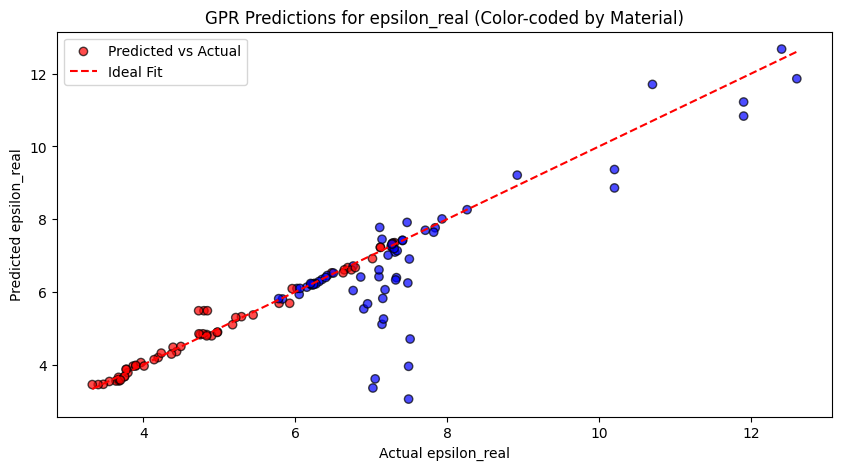

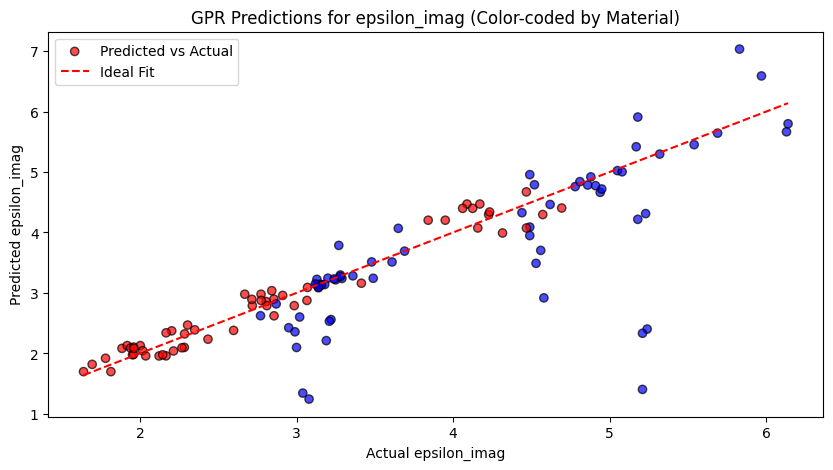

Kernel used for GPR (epsilon_real): 4.78**2 * RBF(length_scale=0.0522)
Kernel used for GPR (epsilon_imag): 2.8**2 * RBF(length_scale=0.0488)


In [33]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels import RBF, ConstantKernel as C
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.pipeline import Pipeline

# Load data (assuming material_df is already loaded)
df = material_df.copy()

# Select 4 unique combinations of (cnt_pct, material, thickness)
selected_combos = df.groupby(['cnt_pct', 'material', 'thickness']).size().reset_index().sample(4)
filtered_df = df.merge(selected_combos[['cnt_pct', 'material', 'thickness']], on=['cnt_pct', 'material', 'thickness'])

# Encode 'material' as a categorical feature
encoder = OneHotEncoder(sparse_output=False, drop='first')
material_encoded = encoder.fit_transform(filtered_df[['material']])
material_columns = encoder.get_feature_names_out(['material'])

# Store material labels for coloring later
material_labels = filtered_df['material'].values

# Prepare feature matrix (X) and target values (y)
X = np.column_stack((
    filtered_df[['cnt_pct', 'thickness', 'frequency']].values,
    material_encoded
))
y_real = filtered_df['epsilon_real'].values
y_imag = filtered_df['epsilon_imag'].values

# Split into training and testing sets (80% train, 20% test)
X_train, X_test, y_real_train, y_real_test, mat_train, mat_test = train_test_split(
    X, y_real, material_labels, test_size=0.2, random_state=42
)
_, _, y_imag_train, y_imag_test, _, _ = train_test_split(X, y_imag, material_labels, test_size=0.2, random_state=42)

# Normalize features (important for GPR)
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Define a Gaussian Process model with RBF kernel
kernel = C(1.0, (1e-2, 1e2)) * RBF(length_scale=1.0, length_scale_bounds=(1e-2, 1e2))
gpr_real = GaussianProcessRegressor(kernel=kernel, n_restarts_optimizer=5, alpha=1e-6)
gpr_imag = GaussianProcessRegressor(kernel=kernel, n_restarts_optimizer=5, alpha=1e-6)

# Train GPR models
print("Training GPR for epsilon_real...")
gpr_real.fit(X_train_scaled, y_real_train)
print("Training GPR for epsilon_imag...")
gpr_imag.fit(X_train_scaled, y_imag_train)

# Predictions
y_real_pred, _ = gpr_real.predict(X_test_scaled, return_std=True)
y_imag_pred, _ = gpr_imag.predict(X_test_scaled, return_std=True)

# Color mapping for materials
color_map = {'PBT': 'blue', 'ABS': 'red'}
colors_test = [color_map[m] for m in mat_test]

# Plot results for epsilon_real with color coding
plt.figure(figsize=(10, 5))
plt.scatter(y_real_test, y_real_pred, c=colors_test, label="Predicted vs Actual", alpha=0.7, edgecolors='k')
plt.plot([min(y_real_test), max(y_real_test)], [min(y_real_test), max(y_real_test)], 'r--', label="Ideal Fit")
plt.xlabel("Actual epsilon_real")
plt.ylabel("Predicted epsilon_real")
plt.title("GPR Predictions for epsilon_real (Color-coded by Material)")
plt.legend()
plt.show()

# Plot results for epsilon_imag with color coding
plt.figure(figsize=(10, 5))
plt.scatter(y_imag_test, y_imag_pred, c=colors_test, label="Predicted vs Actual", alpha=0.7, edgecolors='k')
plt.plot([min(y_imag_test), max(y_imag_test)], [min(y_imag_test), max(y_imag_test)], 'r--', label="Ideal Fit")
plt.xlabel("Actual epsilon_imag")
plt.ylabel("Predicted epsilon_imag")
plt.title("GPR Predictions for epsilon_imag (Color-coded by Material)")
plt.legend()
plt.show()

# Print model performance
print(f"Kernel used for GPR (epsilon_real): {gpr_real.kernel_}")
print(f"Kernel used for GPR (epsilon_imag): {gpr_imag.kernel_}")


Number of training samples for PBT: 400
Number of training samples for ABS: 300

Training GPR for epsilon_real (PBT)...
Training GPR for epsilon_imag (PBT)...


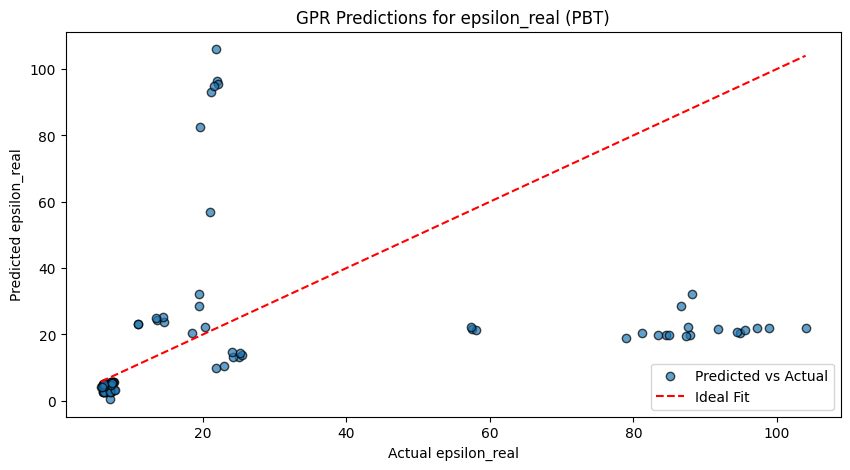

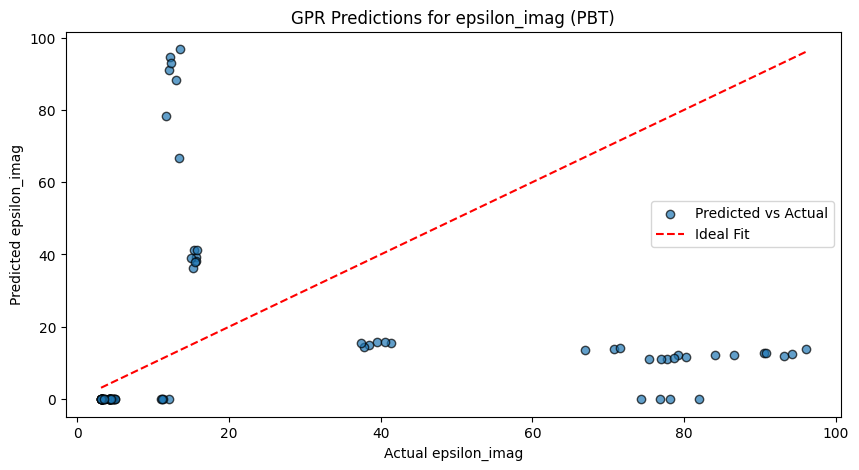

Kernel used for GPR (epsilon_real) - PBT: 10**2 * RBF(length_scale=0.0276)
Kernel used for GPR (epsilon_imag) - PBT: 10**2 * RBF(length_scale=0.01)

Training GPR for epsilon_real (ABS)...
Training GPR for epsilon_imag (ABS)...


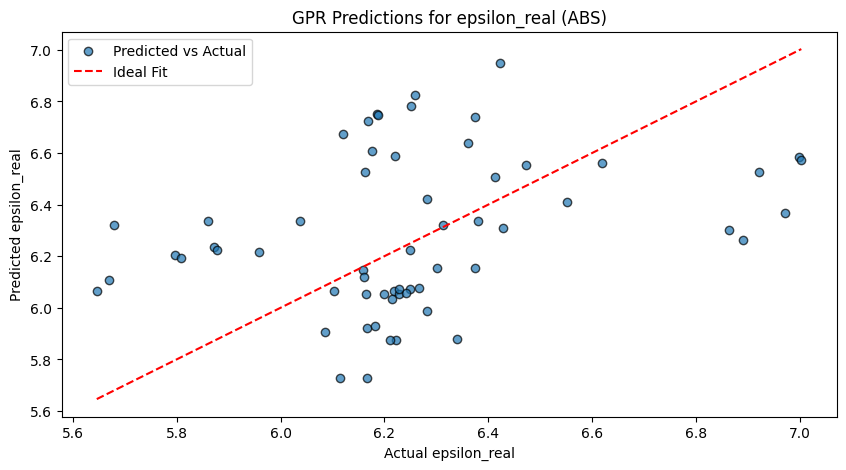

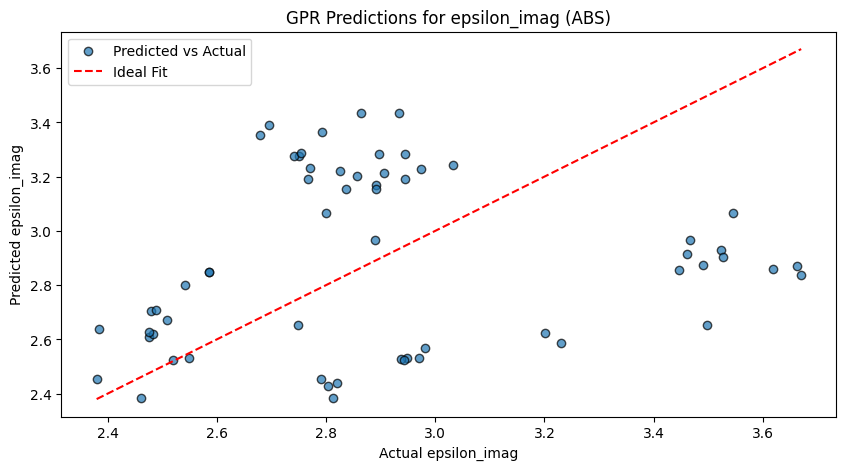

Kernel used for GPR (epsilon_real) - ABS: 4.19**2 * RBF(length_scale=0.0516)
Kernel used for GPR (epsilon_imag) - ABS: 2**2 * RBF(length_scale=0.0513)


In [38]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels import RBF, ConstantKernel as C
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

# Load data (assuming material_df is already loaded)
df = material_df.copy()

# Select 4 unique combinations of (cnt_pct, material, thickness)
selected_combos = df.groupby(['cnt_pct', 'material', 'thickness']).size().reset_index().sample(4)
filtered_df = df.merge(selected_combos[['cnt_pct', 'material', 'thickness']], on=['cnt_pct', 'material', 'thickness'])

# Separate data for ABS and PBT
df_pbt = filtered_df[filtered_df['material'] == 'PBT']
df_abs = filtered_df[filtered_df['material'] == 'ABS']

print(f"Number of training samples for PBT: {df_pbt.shape[0]}")
print(f"Number of training samples for ABS: {df_abs.shape[0]}")


def train_gpr_model(df, material_name):
    """Trains a GPR model for a given material"""

    # Prepare feature matrix (X) and target values (y)
    X = df[['cnt_pct', 'thickness', 'frequency']].values
    y_real = df['epsilon_real'].values
    y_imag = df['epsilon_imag'].values

    # Split into training and testing sets (80% train, 20% test)
    X_train, X_test, y_real_train, y_real_test = train_test_split(X, y_real, test_size=0.2, random_state=42)
    _, _, y_imag_train, y_imag_test = train_test_split(X, y_imag, test_size=0.2, random_state=42)

    # Normalize features
    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    # Define a Gaussian Process model with RBF kernel
    kernel = C(1.0, (1e-2, 1e2)) * RBF(length_scale=1.0, length_scale_bounds=(1e-2, 1e2))
    gpr_real = GaussianProcessRegressor(kernel=kernel, n_restarts_optimizer=5, alpha=1e-6)
    gpr_imag = GaussianProcessRegressor(kernel=kernel, n_restarts_optimizer=5, alpha=1e-6)

    # Train GPR models
    print(f"\nTraining GPR for epsilon_real ({material_name})...")
    gpr_real.fit(X_train_scaled, y_real_train)
    print(f"Training GPR for epsilon_imag ({material_name})...")
    gpr_imag.fit(X_train_scaled, y_imag_train)

    # Predictions
    y_real_pred, _ = gpr_real.predict(X_test_scaled, return_std=True)
    y_imag_pred, _ = gpr_imag.predict(X_test_scaled, return_std=True)

    # Plot results for epsilon_real
    plt.figure(figsize=(10, 5))
    plt.scatter(y_real_test, y_real_pred, label="Predicted vs Actual", alpha=0.7, edgecolors='k')
    plt.plot([min(y_real_test), max(y_real_test)], [min(y_real_test), max(y_real_test)], 'r--', label="Ideal Fit")
    plt.xlabel("Actual epsilon_real")
    plt.ylabel("Predicted epsilon_real")
    plt.title(f"GPR Predictions for epsilon_real ({material_name})")
    plt.legend()
    plt.show()

    # Plot results for epsilon_imag
    plt.figure(figsize=(10, 5))
    plt.scatter(y_imag_test, y_imag_pred, label="Predicted vs Actual", alpha=0.7, edgecolors='k')
    plt.plot([min(y_imag_test), max(y_imag_test)], [min(y_imag_test), max(y_imag_test)], 'r--', label="Ideal Fit")
    plt.xlabel("Actual epsilon_imag")
    plt.ylabel("Predicted epsilon_imag")
    plt.title(f"GPR Predictions for epsilon_imag ({material_name})")
    plt.legend()
    plt.show()

    # Print model performance
    print(f"Kernel used for GPR (epsilon_real) - {material_name}: {gpr_real.kernel_}")
    print(f"Kernel used for GPR (epsilon_imag) - {material_name}: {gpr_imag.kernel_}")

    return gpr_real, gpr_imag, scaler

# Train models for PBT and ABS
gpr_real_pbt, gpr_imag_pbt, scaler_pbt = train_gpr_model(df_pbt, "PBT")
gpr_real_abs, gpr_imag_abs, scaler_abs = train_gpr_model(df_abs, "ABS")


Total unique samples: 21 (ABS + PBT)
Identified 22 unique PBT samples.

Training GPR for epsilon_real (PBT) with 2200 samples...
Training GPR for epsilon_imag (PBT) with 2200 samples...


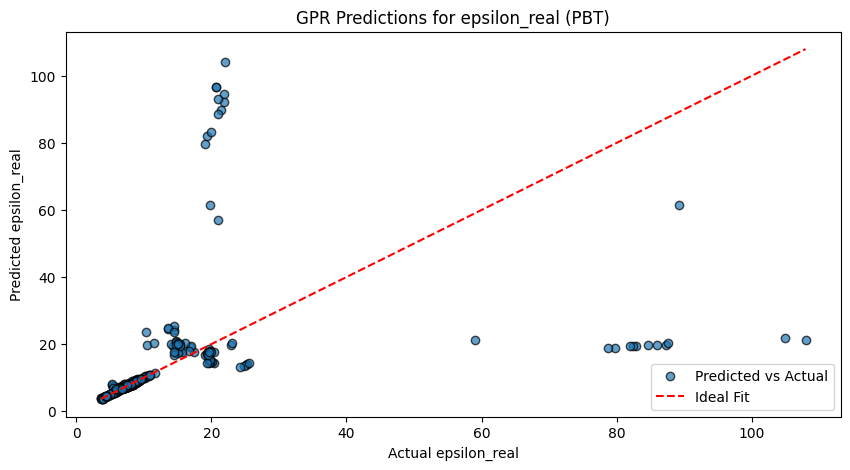

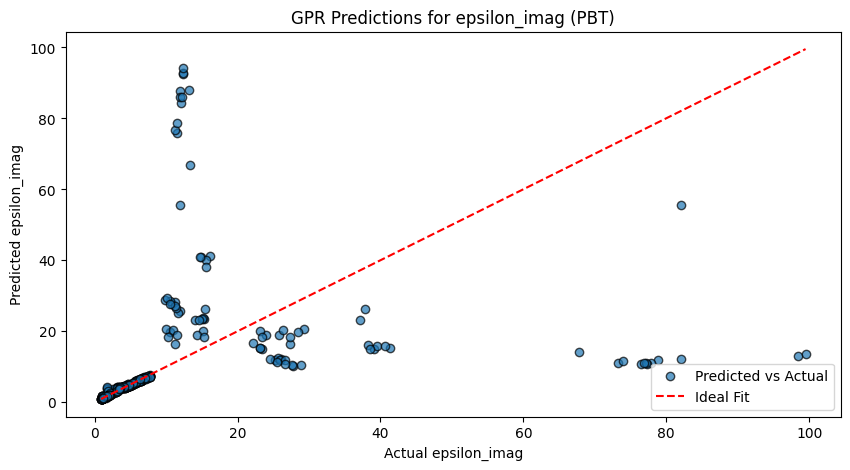

Kernel used for GPR (epsilon_real) - PBT: 8.67**2 * RationalQuadratic(alpha=0.0635, length_scale=0.01)
Kernel used for GPR (epsilon_imag) - PBT: 10**2 * RationalQuadratic(alpha=0.0359, length_scale=0.01)
Total unique samples: 21 (ABS + PBT)
Identified 15 unique ABS samples.

Training GPR for epsilon_real (ABS) with 1500 samples...
Training GPR for epsilon_imag (ABS) with 1500 samples...


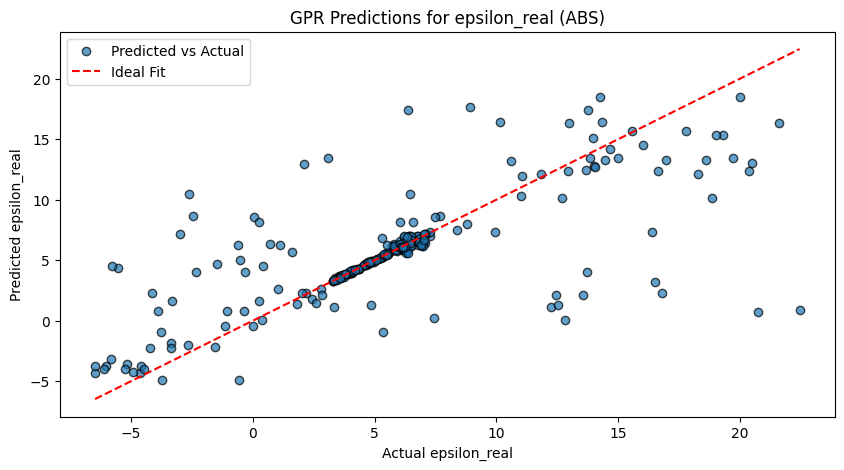

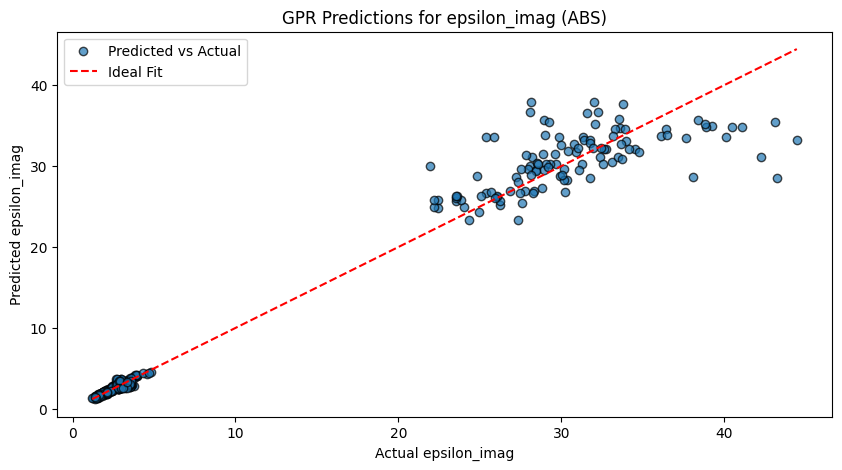

Kernel used for GPR (epsilon_real) - ABS: 5.54**2 * RationalQuadratic(alpha=0.00682, length_scale=0.0108)
Kernel used for GPR (epsilon_imag) - ABS: 6.76**2 * RationalQuadratic(alpha=0.0329, length_scale=0.0759)


In [55]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels import RationalQuadratic, ConstantKernel as C
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

def train_gpr_model(df, material_name):
    """
    Trains a GPR model for a given material using all valid samples for that material.

    Parameters:
        df: DataFrame containing data for both ABS and PBT
        material_name: String indicating whether training is for "ABS" or "PBT"

    Returns:
        Trained GPR models (for epsilon_real and epsilon_imag) and the scaler
    """

    # Step 1: Extract Unique CNT%, Thickness, and Material Combinations
    unique_samples = df[['cnt_pct', 'thickness', 'material']].drop_duplicates()
    print(f"Total unique samples: {len(unique_samples)} (ABS + PBT)")

    # Step 2: Keep only rows where the material matches the training material
    df_material = df[df['material'] == material_name]

    # Step 3: Ensure we have the correct number of samples for this material
    num_samples = df_material.shape[0] // 100  # Assuming 100 frequency points per sample
    print(f"Identified {num_samples} unique {material_name} samples.")

    # Step 4: Prepare Features and Targets
    X = df_material[['cnt_pct', 'thickness', 'frequency']].values
    y_real = df_material['epsilon_real'].values
    y_imag = df_material['epsilon_imag'].values

    # Step 5: Split into Training and Testing Sets
    X_train, X_test, y_real_train, y_real_test = train_test_split(X, y_real, test_size=0.2, random_state=42)
    _, _, y_imag_train, y_imag_test = train_test_split(X, y_imag, test_size=0.2, random_state=42)

    # Step 6: Normalize Features
    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    # Step 7: Define Gaussian Process Model with Rational Quadratic Kernel
    kernel = C(1.0, (1e-2, 1e2)) * RationalQuadratic(length_scale=1.0, alpha=1.0, length_scale_bounds=(1e-2, 1e2))
    gpr_real = GaussianProcessRegressor(kernel=kernel, n_restarts_optimizer=5, alpha=1e-6)
    gpr_imag = GaussianProcessRegressor(kernel=kernel, n_restarts_optimizer=5, alpha=1e-6)

    # Step 8: Train GPR Models
    print(f"\nTraining GPR for epsilon_real ({material_name}) with {df_material.shape[0]} samples...")
    gpr_real.fit(X_train_scaled, y_real_train)
    print(f"Training GPR for epsilon_imag ({material_name}) with {df_material.shape[0]} samples...")
    gpr_imag.fit(X_train_scaled, y_imag_train)

    # Step 9: Predictions and Plotting
    y_real_pred, _ = gpr_real.predict(X_test_scaled, return_std=True)
    y_imag_pred, _ = gpr_imag.predict(X_test_scaled, return_std=True)

    # Plot results for epsilon_real
    plt.figure(figsize=(10, 5))
    plt.scatter(y_real_test, y_real_pred, label="Predicted vs Actual", alpha=0.7, edgecolors='k')
    plt.plot([min(y_real_test), max(y_real_test)], [min(y_real_test), max(y_real_test)], 'r--', label="Ideal Fit")
    plt.xlabel("Actual epsilon_real")
    plt.ylabel("Predicted epsilon_real")
    plt.title(f"GPR Predictions for epsilon_real ({material_name})")
    plt.legend()
    plt.show()

    # Plot results for epsilon_imag
    plt.figure(figsize=(10, 5))
    plt.scatter(y_imag_test, y_imag_pred, label="Predicted vs Actual", alpha=0.7, edgecolors='k')
    plt.plot([min(y_imag_test), max(y_imag_test)], [min(y_imag_test), max(y_imag_test)], 'r--', label="Ideal Fit")
    plt.xlabel("Actual epsilon_imag")
    plt.ylabel("Predicted epsilon_imag")
    plt.title(f"GPR Predictions for epsilon_imag ({material_name})")
    plt.legend()
    plt.show()

    # Print Model Performance
    print(f"Kernel used for GPR (epsilon_real) - {material_name}: {gpr_real.kernel_}")
    print(f"Kernel used for GPR (epsilon_imag) - {material_name}: {gpr_imag.kernel_}")

    return gpr_real, gpr_imag, scaler

# Train models for PBT and ABS using ALL valid samples for each material
gpr_real_pbt, gpr_imag_pbt, scaler_pbt = train_gpr_model(df, "PBT")
gpr_real_abs, gpr_imag_abs, scaler_abs = train_gpr_model(df, "ABS")


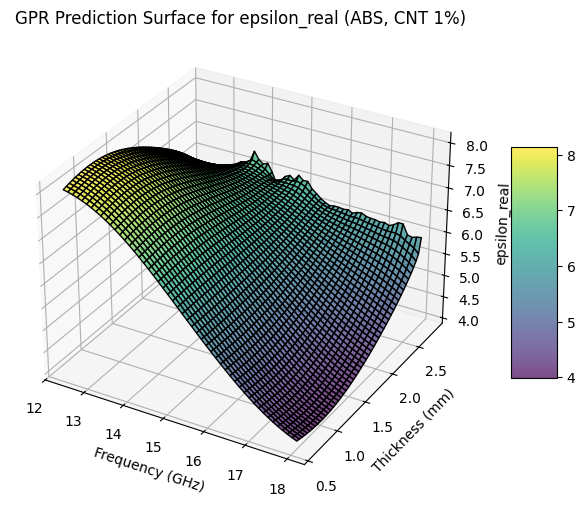

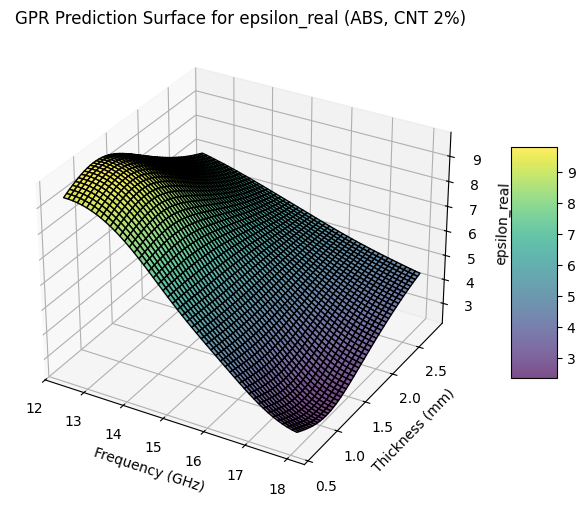

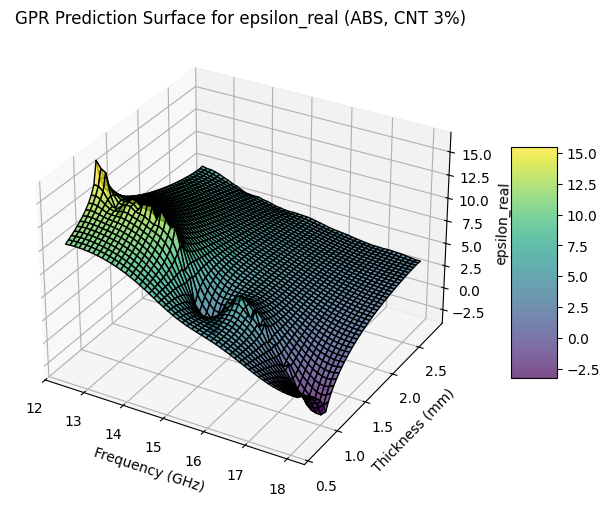

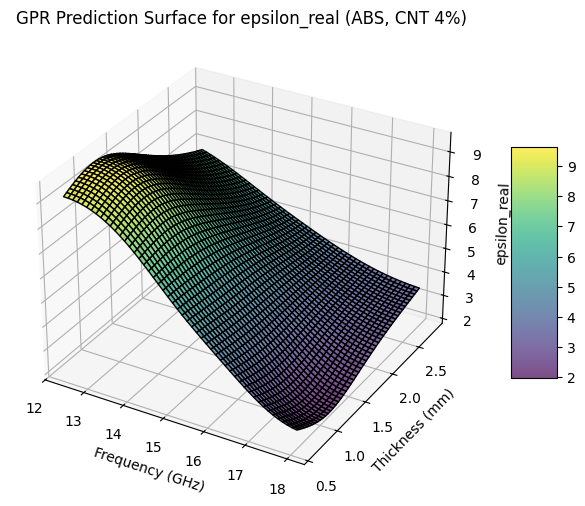

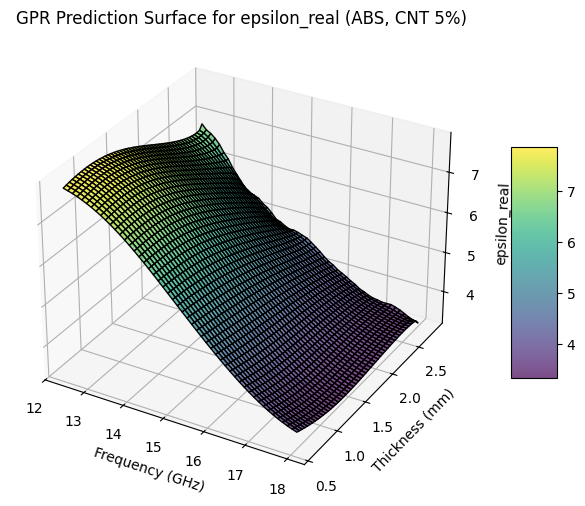

...

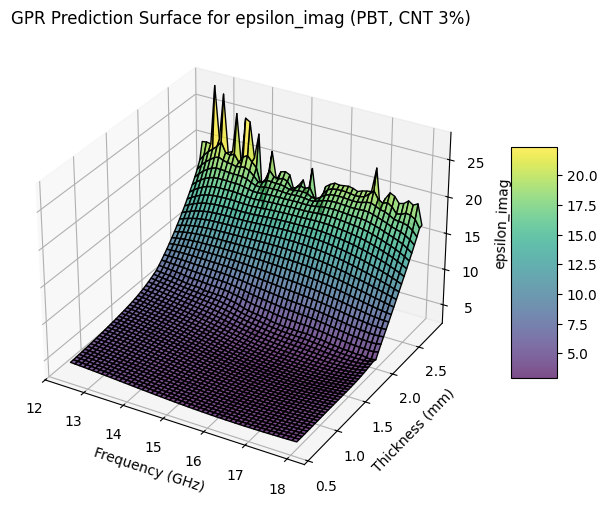

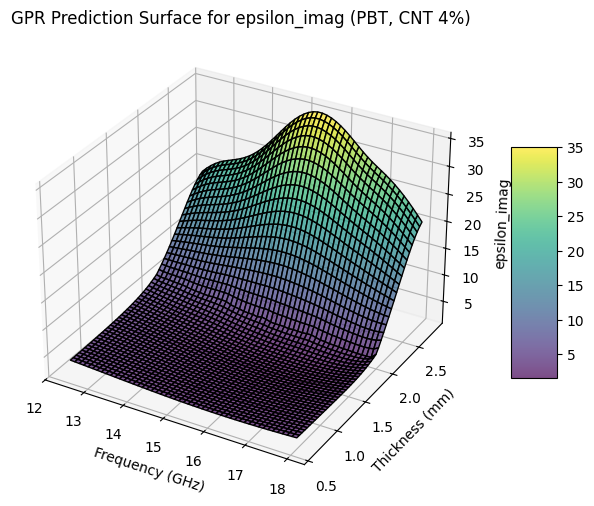

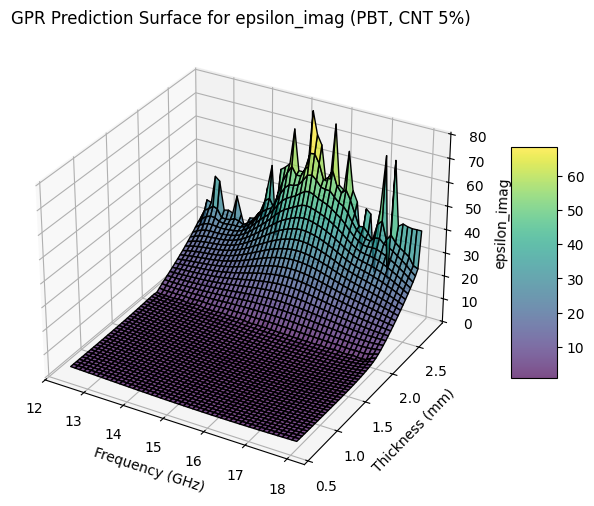

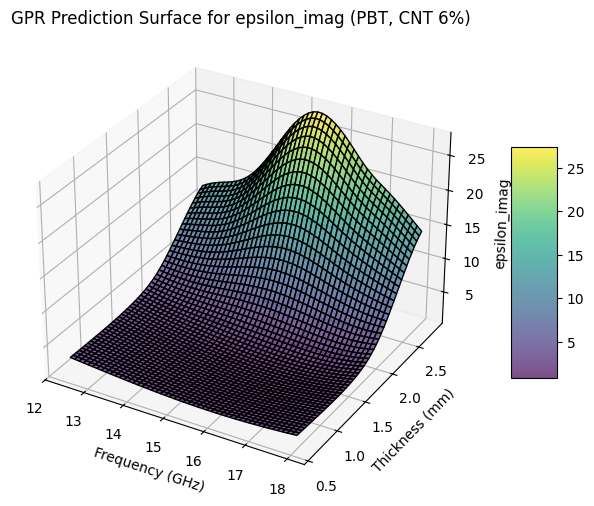

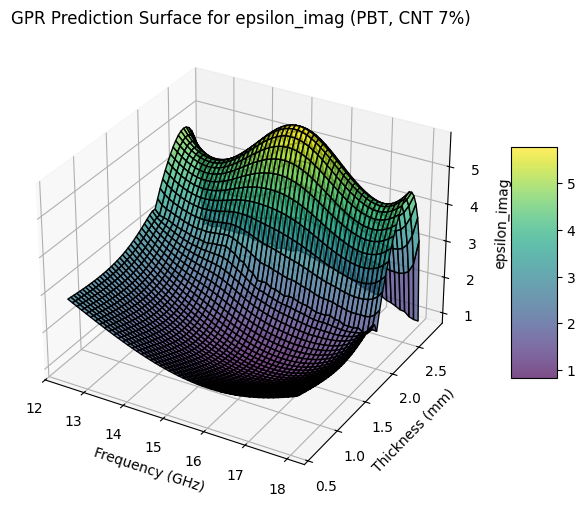

In [56]:
from mpl_toolkits.mplot3d import Axes3D

def plot_gpr_3d_fixed(gpr_model, scaler, feature_name, title, cnt_pct=3.0):
    """
    Plots a 3D surface for a trained GPR model for the ABS material with varying thickness.

    Parameters:
        gpr_model: Trained GPR model (gpr_real_abs or gpr_imag_abs)
        scaler: StandardScaler used in training
        feature_name: The name of the feature being predicted ('epsilon_real' or 'epsilon_imag')
        title: The plot title
        cnt_pct: Fixed CNT percentage (default: 3.0%)
    """
    # Define the range of frequency and thickness
    freq_range = np.linspace(12.4e9, 18e9, 50)  # 50 points between 12.4GHz and 18GHz
    thickness_range = np.linspace(0.6, 2.8, 50)  # Vary thickness from 0.6mm to 2.8mm

    # Create meshgrid
    FREQ, THICK = np.meshgrid(freq_range, thickness_range)

    # Flatten meshgrid for prediction
    X_pred = np.column_stack((np.full(FREQ.ravel().shape, cnt_pct), THICK.ravel(), FREQ.ravel()))

    # Standardize features
    X_pred_scaled = scaler.transform(X_pred)

    # Predict values using GPR model
    Y_pred = gpr_model.predict(X_pred_scaled).reshape(FREQ.shape)

    # Create 3D plot
    fig = plt.figure(figsize=(10, 6))
    ax = fig.add_subplot(111, projection='3d')

    # Plot surface
    surf = ax.plot_surface(FREQ / 1e9, THICK, Y_pred, cmap='viridis', edgecolor='k', alpha=0.7)

    # Labels and title
    ax.set_xlabel("Frequency (GHz)")
    ax.set_ylabel("Thickness (mm)")
    ax.set_zlabel(feature_name)
    ax.set_title(title)
    fig.colorbar(surf, shrink=0.5, aspect=5)  # Add color bar for scale

    plt.show()

# Define CNT% range from 1% to 7%
cnt_range = range(1, 8)  # 1 to 7 inclusive

# Loop through each CNT% and plot for both ABS and PBT
for cnt in cnt_range:
    # Plot for ABS
    plot_gpr_3d_fixed(gpr_real_abs, scaler_abs, "epsilon_real", f"GPR Prediction Surface for epsilon_real (ABS, CNT {cnt}%)", cnt_pct=cnt)

for cnt in cnt_range:
    plot_gpr_3d_fixed(gpr_imag_abs, scaler_abs, "epsilon_imag", f"GPR Prediction Surface for epsilon_imag (ABS, CNT {cnt}%)", cnt_pct=cnt)

for cnt in cnt_range:
    # Plot for PBT
    plot_gpr_3d_fixed(gpr_real_pbt, scaler_pbt, "epsilon_real", f"GPR Prediction Surface for epsilon_real (PBT, CNT {cnt}%)", cnt_pct=cnt)
for cnt in cnt_range:
    plot_gpr_3d_fixed(gpr_imag_pbt, scaler_pbt, "epsilon_imag", f"GPR Prediction Surface for epsilon_imag (PBT, CNT {cnt}%)", cnt_pct=cnt)


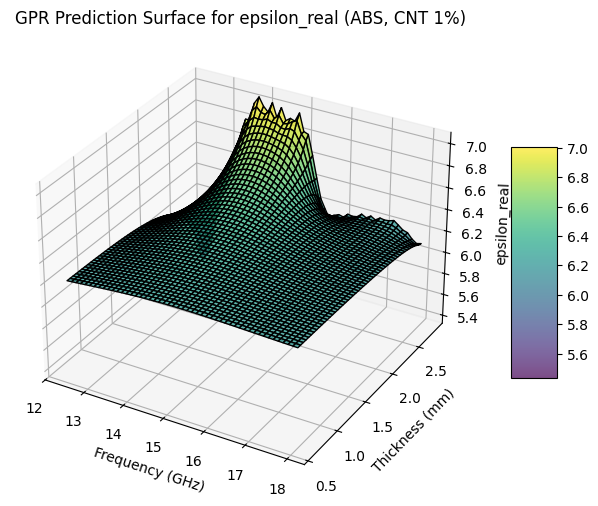

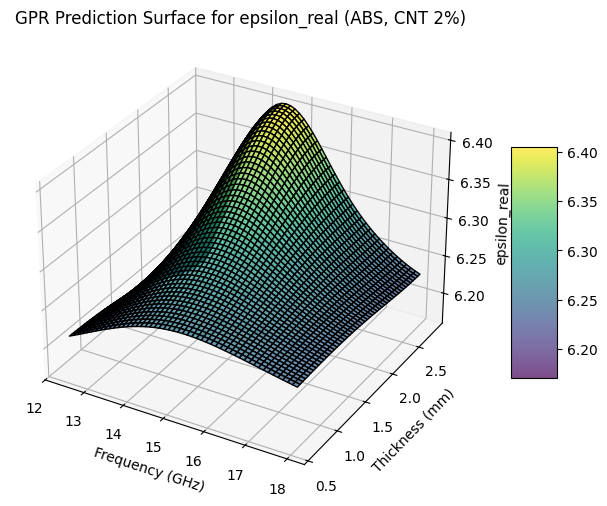

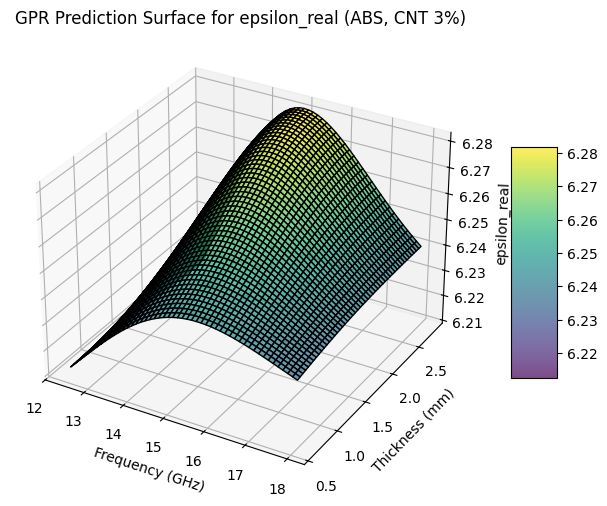

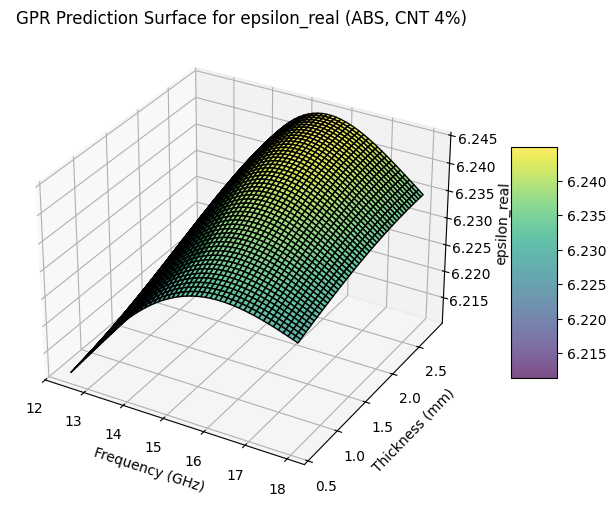

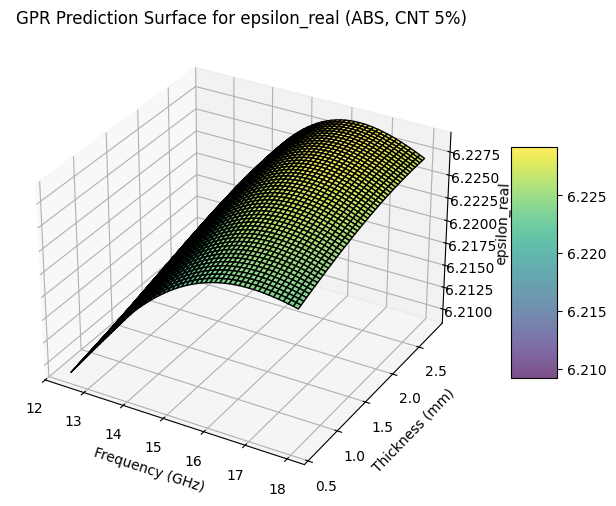

...

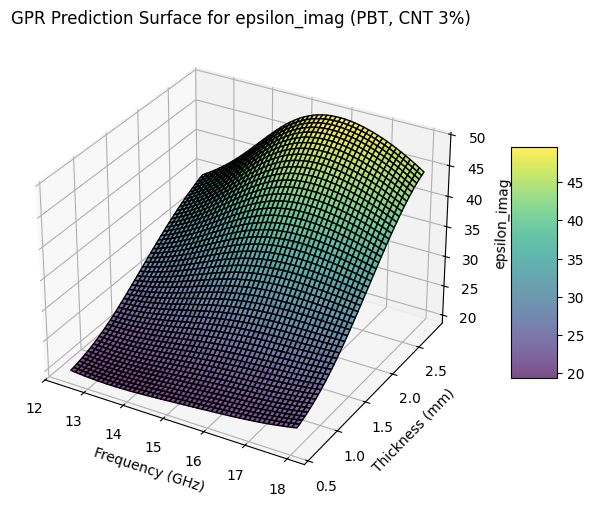

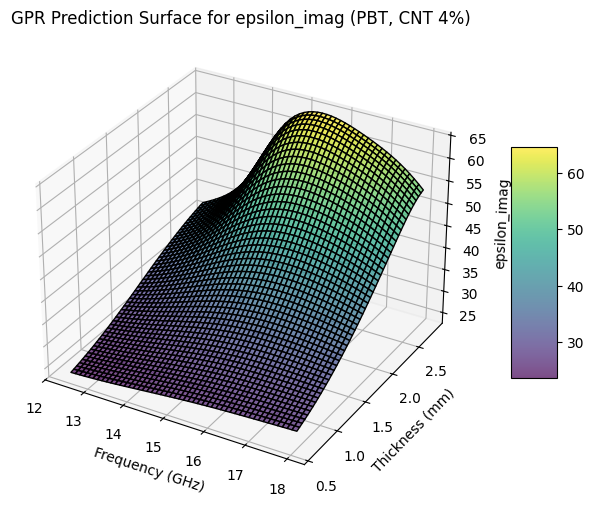

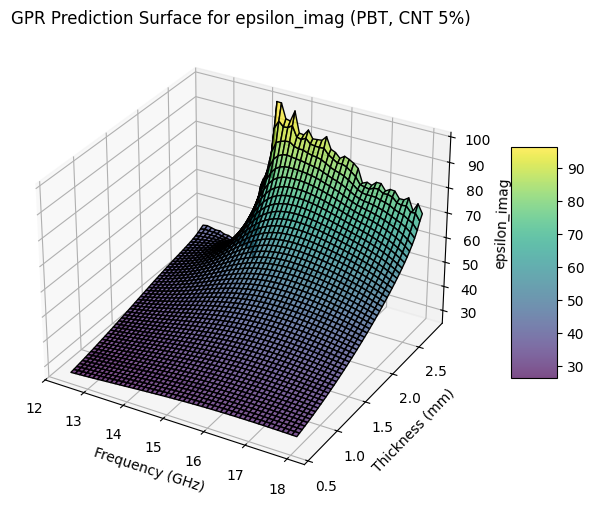

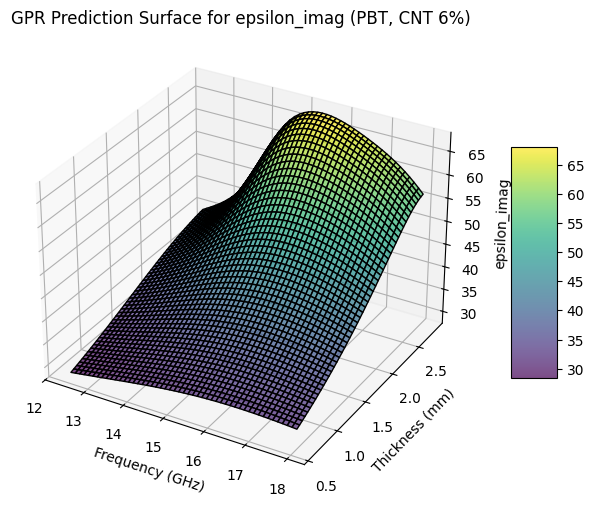

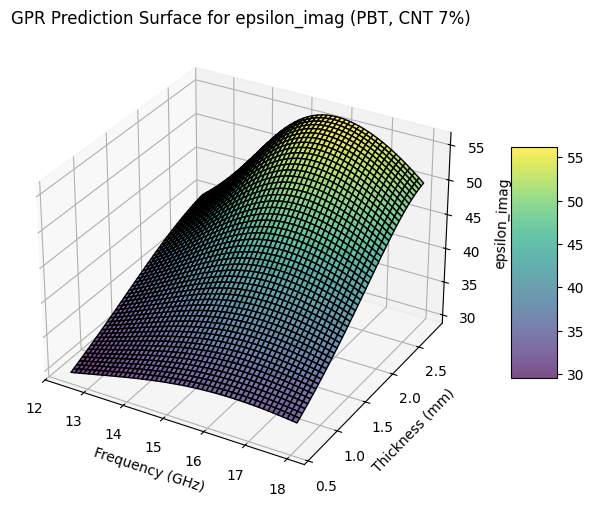

In [54]:
from mpl_toolkits.mplot3d import Axes3D

def plot_gpr_3d_fixed(gpr_model, scaler, feature_name, title, cnt_pct=3.0):
    """
    Plots a 3D surface for a trained GPR model for the ABS material with varying thickness.

    Parameters:
        gpr_model: Trained GPR model (gpr_real_abs or gpr_imag_abs)
        scaler: StandardScaler used in training
        feature_name: The name of the feature being predicted ('epsilon_real' or 'epsilon_imag')
        title: The plot title
        cnt_pct: Fixed CNT percentage (default: 3.0%)
    """
    # Define the range of frequency and thickness
    freq_range = np.linspace(12.4e9, 18e9, 50)  # 50 points between 12.4GHz and 18GHz
    thickness_range = np.linspace(0.6, 2.8, 50)  # Vary thickness from 0.6mm to 2.8mm

    # Create meshgrid
    FREQ, THICK = np.meshgrid(freq_range, thickness_range)

    # Flatten meshgrid for prediction
    X_pred = np.column_stack((np.full(FREQ.ravel().shape, cnt_pct), THICK.ravel(), FREQ.ravel()))

    # Standardize features
    X_pred_scaled = scaler.transform(X_pred)

    # Predict values using GPR model
    Y_pred = gpr_model.predict(X_pred_scaled).reshape(FREQ.shape)

    # Create 3D plot
    fig = plt.figure(figsize=(10, 6))
    ax = fig.add_subplot(111, projection='3d')

    # Plot surface
    surf = ax.plot_surface(FREQ / 1e9, THICK, Y_pred, cmap='viridis', edgecolor='k', alpha=0.7)

    # Labels and title
    ax.set_xlabel("Frequency (GHz)")
    ax.set_ylabel("Thickness (mm)")
    ax.set_zlabel(feature_name)
    ax.set_title(title)
    fig.colorbar(surf, shrink=0.5, aspect=5)  # Add color bar for scale

    plt.show()

# Define CNT% range from 1% to 7%
cnt_range = range(1, 8)  # 1 to 7 inclusive

# Loop through each CNT% and plot for both ABS and PBT
for cnt in cnt_range:
    # Plot for ABS
    plot_gpr_3d_fixed(gpr_real_abs, scaler_abs, "epsilon_real", f"GPR Prediction Surface for epsilon_real (ABS, CNT {cnt}%)", cnt_pct=cnt)

for cnt in cnt_range:
    plot_gpr_3d_fixed(gpr_imag_abs, scaler_abs, "epsilon_imag", f"GPR Prediction Surface for epsilon_imag (ABS, CNT {cnt}%)", cnt_pct=cnt)

for cnt in cnt_range:
    # Plot for PBT
    plot_gpr_3d_fixed(gpr_real_pbt, scaler_pbt, "epsilon_real", f"GPR Prediction Surface for epsilon_real (PBT, CNT {cnt}%)", cnt_pct=cnt)
for cnt in cnt_range:
    plot_gpr_3d_fixed(gpr_imag_pbt, scaler_pbt, "epsilon_imag", f"GPR Prediction Surface for epsilon_imag (PBT, CNT {cnt}%)", cnt_pct=cnt)


## Modelling

In [14]:
def prepare_gpr_data(thesis_df):
    """
    Prepare data for GPR by grouping by CNT% and Thickness combinations,
    and aggregating the mean and variance of target values.
    """
    # Extract CNT% and Thickness from filenames
    thesis_df['CNT%'] = thesis_df['filename'].str.extract(r'(\d+)%').astype(float)
    thesis_df['Thickness'] = thesis_df['filename'].str.extract(r'([\d.]+)mm').astype(float)

    # Group by CNT% and Thickness, calculate mean and variance for targets
    aggregated = (
        thesis_df.groupby(['cnt_pct', 'thickness'])
        .agg(
            mean_absorption=('mean_a', 'mean'),
            var_absorption=('mean_a', 'var'),
            mean_reflection=('mean_r', 'mean'),
            var_reflection=('mean_r', 'var'),
            mean_transmission=('mean_t', 'mean'),
            var_transmission=('mean_t', 'var')
        )
        .reset_index()
    )

    # Replace NaN variances with small values to avoid issues
    aggregated.fillna(1e-6, inplace=True)

    return aggregated

def train_gpr_model(aggregated, target_column, noise_column):
    """
    Train a GPR model on the aggregated data.

    Parameters:
    - aggregated (pd.DataFrame): Dataframe with aggregated features and targets.
    - target_column (str): Column name for the target variable.
    - noise_column (str): Column name for the noise (variance) variable.

    Returns:
    - gpr (GaussianProcessRegressor): Trained GPR model.
    """
    # Input features (CNT%, Thickness)
    X = aggregated[['cnt_pct', 'thickness']].values

    # Target variable (e.g., Absorption)
    y = aggregated[target_column].values

    # Noise (variance of the target)
    noise = aggregated[noise_column].values

    # Define the kernel: RBF kernel + WhiteKernel for noise
    kernel = C(1.0, (1e-3, 1e3)) * RBF(length_scale=1.0, length_scale_bounds=(1e-2, 1e2)) + WhiteKernel(noise_level=1.0)

    # Create and fit the GPR model
    gpr = GaussianProcessRegressor(kernel=kernel, alpha=noise, n_restarts_optimizer=10, random_state=42)
    gpr.fit(X, y)

    return gpr

def predict_gpr(gpr, X_new):
    """
    Predict using the trained GPR model.

    Parameters:
    - gpr (GaussianProcessRegressor): Trained GPR model.
    - X_new (np.ndarray): New input features for prediction.

    Returns:
    - y_pred (np.ndarray): Predicted mean values.
    - y_std (np.ndarray): Predicted standard deviations (uncertainty).
    """
    y_pred, y_std = gpr.predict(X_new, return_std=True)
    return y_pred, y_std

# Example usage:
# Prepare the data
aggregated_data = prepare_gpr_data(thesis_df)

# Train GPR models for each target
gpr_absorption = train_gpr_model(aggregated_data, 'mean_absorption', 'var_absorption')
gpr_reflection = train_gpr_model(aggregated_data, 'mean_reflection', 'var_reflection')
gpr_transmission = train_gpr_model(aggregated_data, 'mean_transmission', 'var_transmission')

# Predict for new data (example input)
X_new = np.array([[3, 2.8], [5, 1.1]])  # Example CNT% and Thickness combinations
absorption_pred, absorption_std = predict_gpr(gpr_absorption, X_new)
reflection_pred, reflection_std = predict_gpr(gpr_reflection, X_new)
transmission_pred, transmission_std = predict_gpr(gpr_transmission, X_new)

print("Predictions for Absorption:", absorption_pred)
print("Uncertainty for Absorption:", absorption_std)
print("Predictions for Reflection:", reflection_pred)
print("Uncertainty for Reflection:", reflection_std)
print("Predictions for Transmission:", transmission_pred)
print("Uncertainty for Transmission:", transmission_std)


Predictions for Absorption: [0.37459004 0.27695138]
Uncertainty for Absorption: [0.05557343 0.05742515]
Predictions for Reflection: [0.60789926 0.69519531]
Uncertainty for Reflection: [0.09126449 0.09666707]
Predictions for Transmission: [0.010163   0.00619542]
Uncertainty for Transmission: [0.0355633 0.0948324]


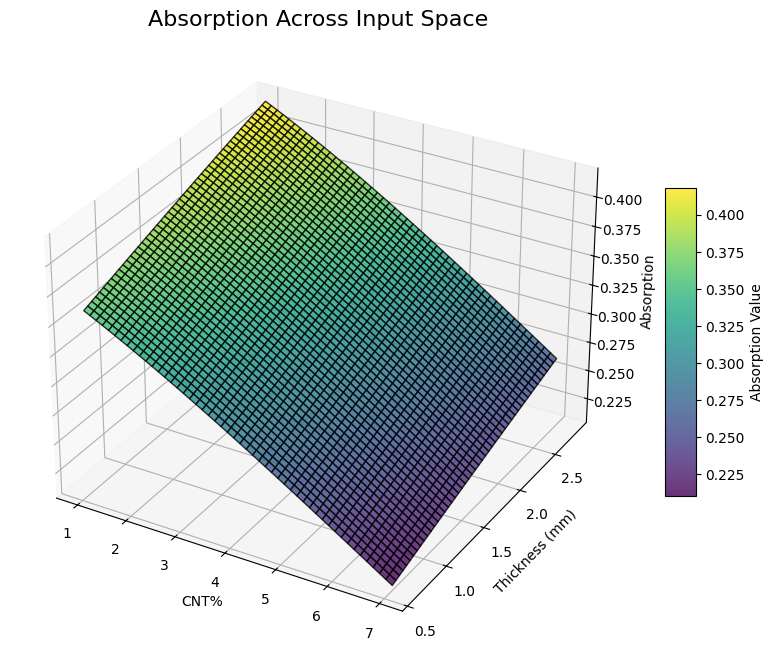

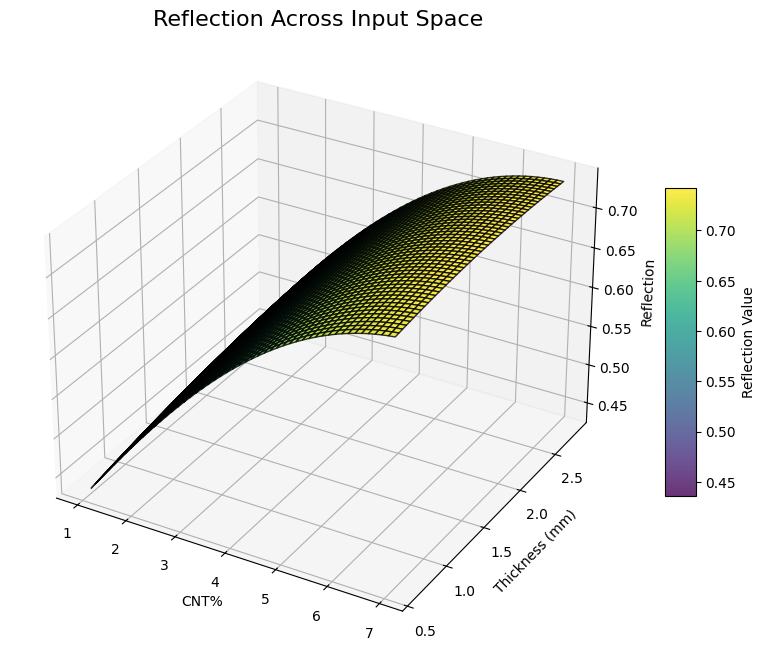

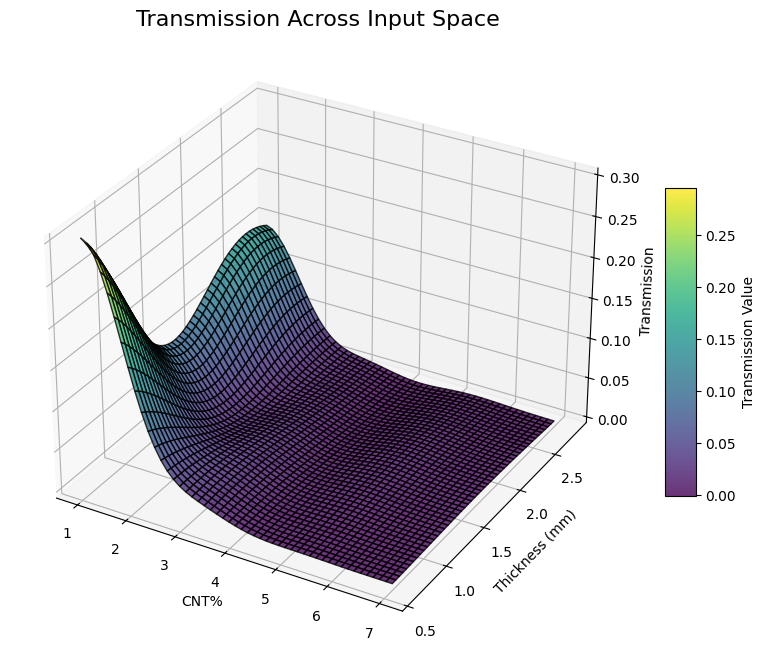

In [ ]:
def visualize_target_surface(gpr, title, X, Y, target_name):
    """
    Visualize the target variable as a 3D surface plot.

    Parameters:
    - gpr (GaussianProcessRegressor): Trained GPR model for the target.
    - title (str): Title for the plot.
    - X (np.ndarray): 2D array of CNT% values for the grid.
    - Y (np.ndarray): 2D array of Thickness values for the grid.
    - target_name (str): Name of the target variable being visualized.
    """
    # Create a meshgrid for CNT% and Thickness
    X_flat = X.ravel()
    Y_flat = Y.ravel()
    grid_points = np.vstack([X_flat, Y_flat]).T

    # Predict values for the grid
    Z_pred, Z_std = gpr.predict(grid_points, return_std=True)
    Z_pred = Z_pred.reshape(X.shape)

    # Plot the surface
    fig = plt.figure(figsize=(10, 8))
    ax = fig.add_subplot(111, projection='3d')
    surface = ax.plot_surface(X, Y, Z_pred, cmap='viridis', alpha=0.8, edgecolor='k')

    # Add color bar and labels
    fig.colorbar(surface, ax=ax, shrink=0.5, aspect=10, label=f"{target_name} Value")
    ax.set_title(title, fontsize=16)
    ax.set_xlabel("CNT%")
    ax.set_ylabel("Thickness (mm)")
    ax.set_zlabel(target_name)
    plt.show()

# Generate a grid of CNT% and Thickness
cnt_values = np.linspace(thesis_df['CNT%'].min(), thesis_df['CNT%'].max(), 50)
thickness_values = np.linspace(thesis_df['Thickness'].min(), thesis_df['Thickness'].max(), 50)
CNT_grid, Thickness_grid = np.meshgrid(cnt_values, thickness_values)

# Visualize each target variable
visualize_target_surface(gpr_absorption, "Absorption Across Input Space", CNT_grid, Thickness_grid, "Absorption")
visualize_target_surface(gpr_reflection, "Reflection Across Input Space", CNT_grid, Thickness_grid, "Reflection")
visualize_target_surface(gpr_transmission, "Transmission Across Input Space", CNT_grid, Thickness_grid, "Transmission")


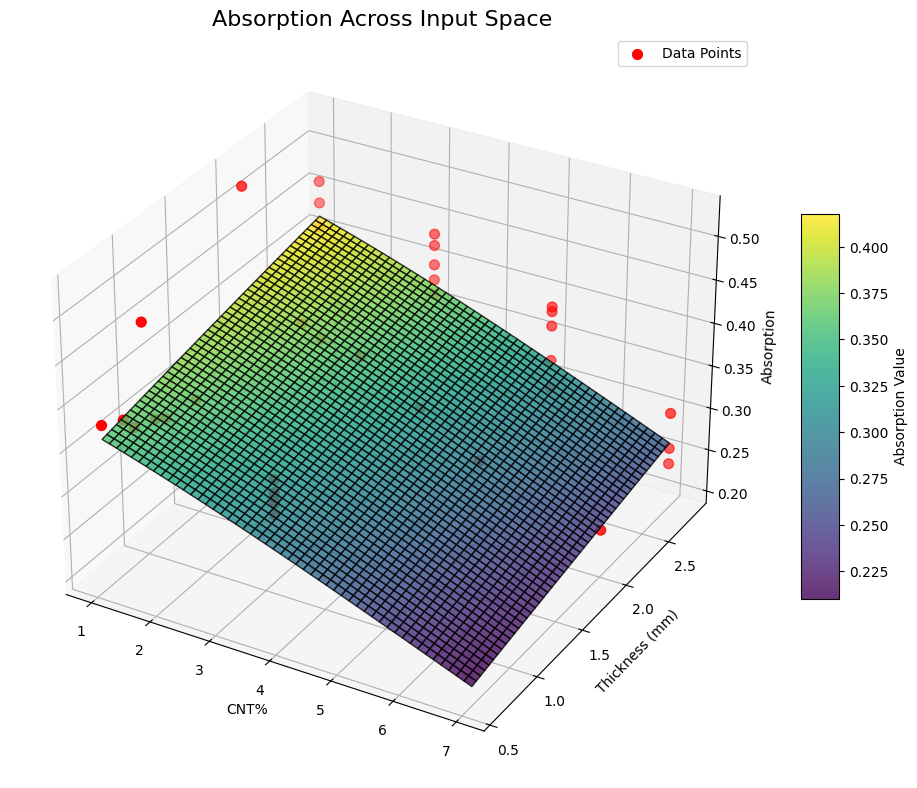

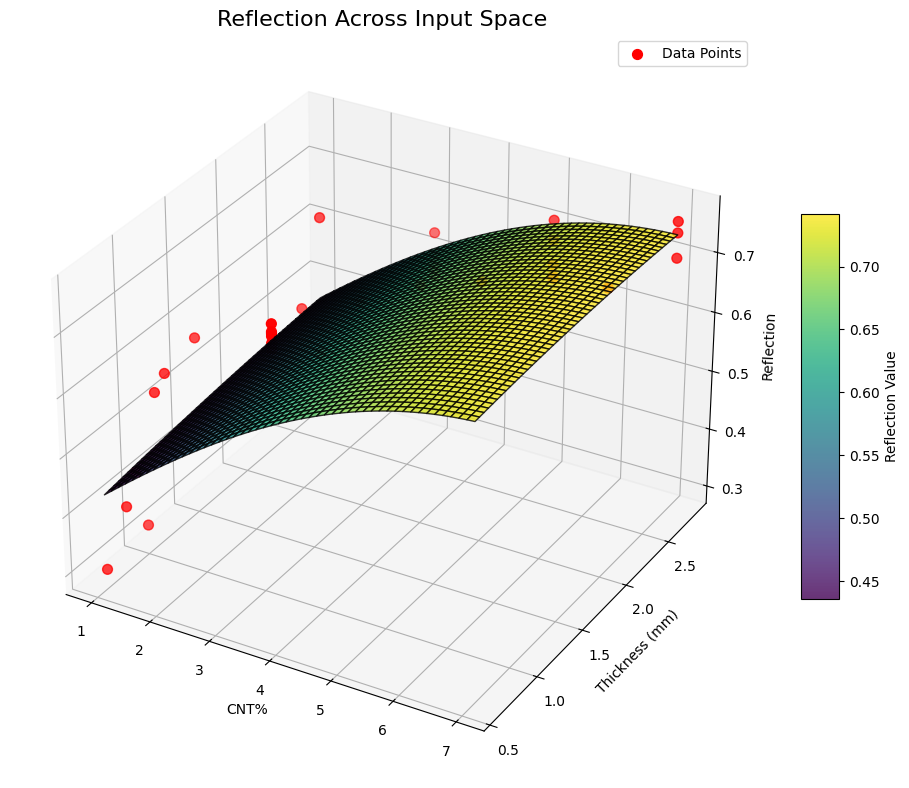

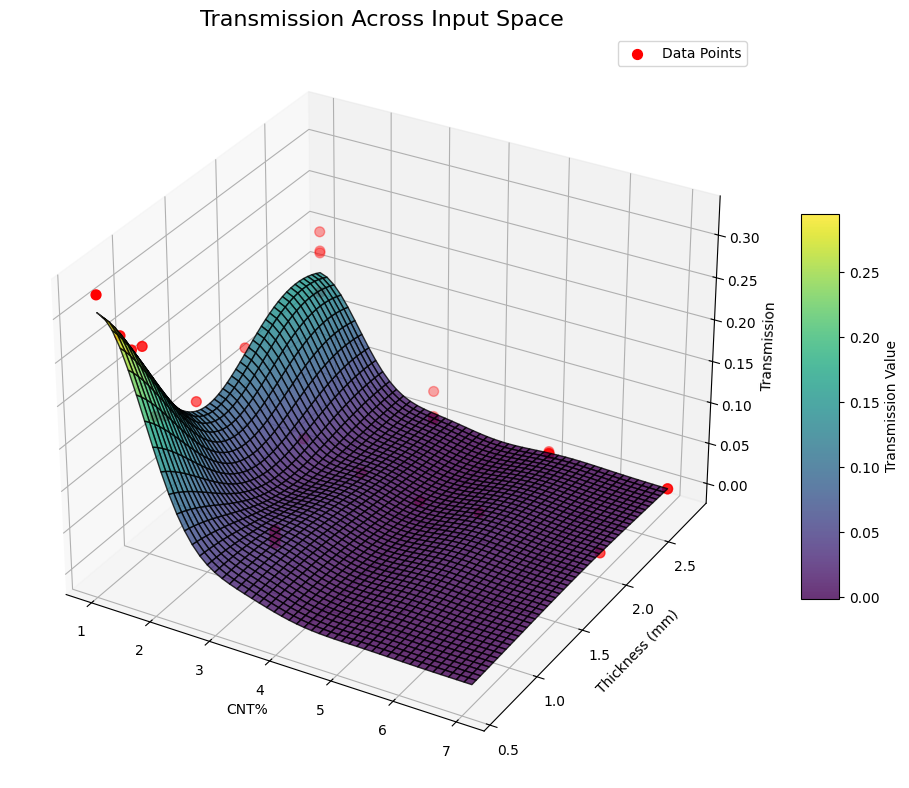

In [ ]:
def visualize_target_surface_with_points(gpr, title, X, Y, target_name, thesis_df, target_col, x_col="CNT%", y_col="Thickness"):
    """
    Visualize the target variable as a 3D surface plot with data points overlayed.

    Parameters:
    - gpr (GaussianProcessRegressor): Trained GPR model for the target.
    - title (str): Title for the plot.
    - X (np.ndarray): 2D array of CNT% values for the grid.
    - Y (np.ndarray): 2D array of Thickness values for the grid.
    - target_name (str): Name of the target variable being visualized.
    - thesis_df (pd.DataFrame): DataFrame containing the original data points.
    - target_col (str): Column name for the target variable in the DataFrame.
    - x_col (str): Column name for the x-axis variable (CNT%).
    - y_col (str): Column name for the y-axis variable (Thickness).
    """
    # Create a meshgrid for CNT% and Thickness
    X_flat = X.ravel()
    Y_flat = Y.ravel()
    grid_points = np.vstack([X_flat, Y_flat]).T

    # Predict values for the grid
    Z_pred, Z_std = gpr.predict(grid_points, return_std=True)
    Z_pred = Z_pred.reshape(X.shape)

    # Plot the surface
    fig = plt.figure(figsize=(12, 10))
    ax = fig.add_subplot(111, projection='3d')
    surface = ax.plot_surface(X, Y, Z_pred, cmap='viridis', alpha=0.8, edgecolor='k')

    # Add the actual data points as scatter points
    ax.scatter(thesis_df[x_col], thesis_df[y_col], thesis_df[target_col], color='r', s=50, label="Data Points")

    # Add color bar and labels
    fig.colorbar(surface, ax=ax, shrink=0.5, aspect=10, label=f"{target_name} Value")
    ax.set_title(title, fontsize=16)
    ax.set_xlabel("CNT%")
    ax.set_ylabel("Thickness (mm)")
    ax.set_zlabel(target_name)
    ax.legend()
    plt.show()

# Visualize with the actual data points overlayed
visualize_target_surface_with_points(
    gpr_absorption, "Absorption Across Input Space", CNT_grid, Thickness_grid,
    "Absorption", thesis_df, "mean_a", "CNT%", "Thickness"
)

visualize_target_surface_with_points(
    gpr_reflection, "Reflection Across Input Space", CNT_grid, Thickness_grid,
    "Reflection", thesis_df, "mean_r", "CNT%", "Thickness"
)

visualize_target_surface_with_points(
    gpr_transmission, "Transmission Across Input Space", CNT_grid, Thickness_grid,
    "Transmission", thesis_df, "mean_t", "CNT%", "Thickness"
)


Removing white noise smoothing function

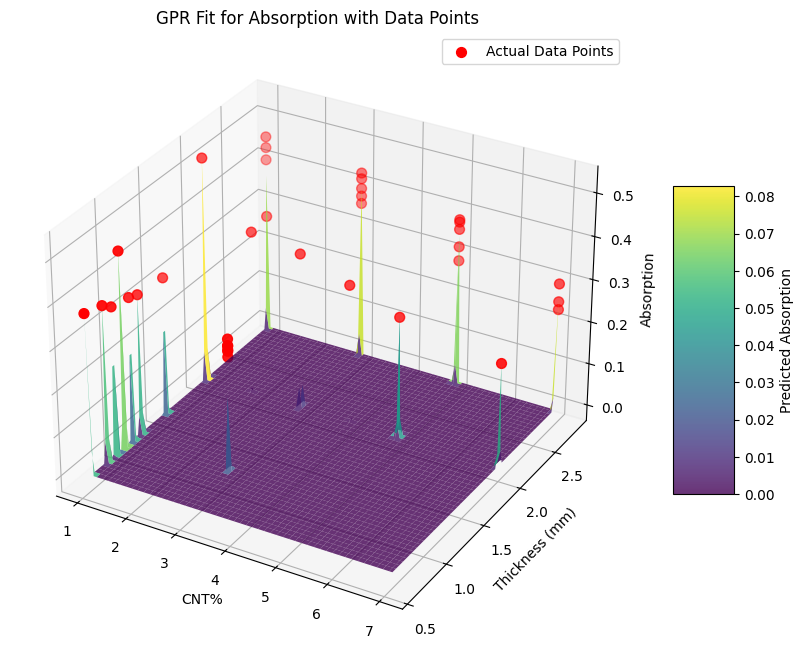

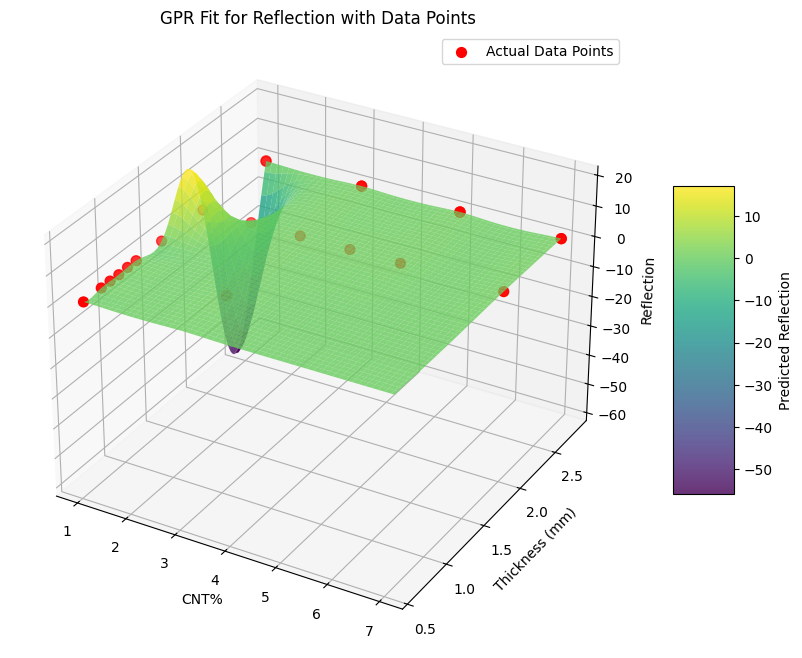

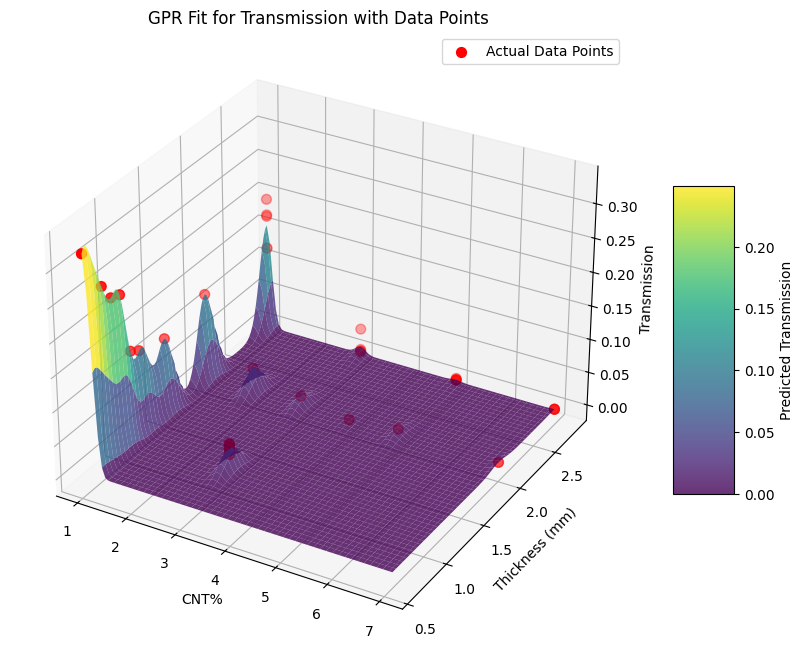

In [ ]:
def create_train_visualize_gpr_custom(thesis_df, target, grid_resolution=100):
    """
    Train a GPR model with target-specific kernel configurations and visualize the fit.

    Parameters:
    - thesis_df (pd.DataFrame): The dataset containing input features and targets.
    - target (str): The target variable to predict ('absorption', 'reflection', or 'transmission').
    - grid_resolution (int): Resolution for the prediction grid.

    Returns:
    - gpr_model (GaussianProcessRegressor): Trained GPR model.
    """
    # Extract features and target from thesis_df
    X = thesis_df[['cnt_pct', 'thickness']].values
    y = thesis_df[f'mean_{target[0].lower()}'].values  # mean_a, mean_r, or mean_t

    # Define custom kernel configurations based on the target variable
    if target == "absorption":
        kernel = C(1.0, (1e-1, 1e3)) * RBF(length_scale=0.5, length_scale_bounds=(1e-2, 1e1))
    elif target in ["reflection", "transmission"]:
        kernel = C(1.0, (1e-2, 1e3)) * RBF(length_scale=2.0, length_scale_bounds=(1e-1, 1e2))
    else:
        raise ValueError(f"Unknown target: {target}. Choose from 'absorption', 'reflection', or 'transmission'.")

    # Train the Gaussian Process Regressor
    gpr_model = GaussianProcessRegressor(kernel=kernel, alpha=1e-10, n_restarts_optimizer=10)
    gpr_model.fit(X, y)

    # Generate grid for predictions
    CNT_grid = np.linspace(thesis_df['CNT%'].min(), thesis_df['CNT%'].max(), grid_resolution)
    Thickness_grid = np.linspace(thesis_df['Thickness'].min(), thesis_df['Thickness'].max(), grid_resolution)
    CNT_grid, Thickness_grid = np.meshgrid(CNT_grid, Thickness_grid)
    X_pred = np.c_[CNT_grid.ravel(), Thickness_grid.ravel()]

    # Make predictions
    y_pred, y_std = gpr_model.predict(X_pred, return_std=True)
    y_pred = y_pred.reshape(CNT_grid.shape)

    # Plot the surface and overlay data points
    fig = plt.figure(figsize=(12, 8))
    ax = fig.add_subplot(111, projection='3d')
    surf = ax.plot_surface(CNT_grid, Thickness_grid, y_pred, cmap='viridis', alpha=0.8)
    fig.colorbar(surf, shrink=0.5, aspect=5, label=f'Predicted {target.capitalize()}')

    # Overlay the actual data points
    ax.scatter(
        thesis_df['CNT%'], thesis_df['Thickness'], thesis_df[f'mean_{target[0].lower()}'],
        c='red', label='Actual Data Points', s=50
    )

    # Labels and title
    ax.set_xlabel('CNT%')
    ax.set_ylabel('Thickness (mm)')
    ax.set_zlabel(f'{target.capitalize()}')
    ax.set_title(f'GPR Fit for {target.capitalize()} with Data Points')
    ax.legend()
    plt.show()

    return gpr_model

# Example usage for each target:
gpr_model_absorption = create_train_visualize_gpr_custom(thesis_df, target="absorption")
gpr_model_reflection = create_train_visualize_gpr_custom(thesis_df, target="reflection")
gpr_model_transmission = create_train_visualize_gpr_custom(thesis_df, target="transmission")


In [ ]:
thesis_df

,filename,cnt_pct,material,thickness,mean_a,max_a,std_a,range_a,weighted_mean_a,mean_r,...,gradient_a,gradient_r,gradient_t,performance_score,PCA1,PCA2,tSNE1,tSNE2,CNT%,Thickness
0,4%/PBT/4%-PBT-2.0mm.csv,4,PBT,2.0,0.322400,0.366000,0.032448,0.120000,0.325429,0.675710,...,0.001260,-0.001250,-1.000000e-05,-0.041117,0.115240,0.018058,-2.347158,3.230204,4.0,2.0
1,5%/PBT/5%-PBT-2.8mm-B.csv,5,PBT,2.8,0.290490,0.340000,0.031941,0.109000,0.293846,0.708940,...,0.001065,-0.001055,0.000000e+00,-0.067237,0.152722,-0.007661,-2.502394,3.452564,5.0,2.8
2,5%/PBT/5%-PBT-2.0mm.csv,5,PBT,2.0,0.280870,0.308000,0.024239,0.087000,0.282945,0.709060,...,0.000950,-0.000915,-3.000000e-05,-0.070281,0.151723,-0.023353,-2.637094,3.431880,5.0,2.0
3,5%/PBT/5%-PBT-2.8mm-A.csv,5,PBT,2.8,0.381270,0.428000,0.032487,0.121000,0.384122,0.614710,...,0.001225,-0.001235,0.000000e+00,0.007022,0.046279,0.065039,-2.109944,2.785143,5.0,2.8
4,5%/ABS/5%-ABS-2.8mm-C.csv,5,ABS,2.8,0.323394,0.378991,0.037225,0.151901,0.327121,0.675066,...,0.001591,-0.001586,-5.277696e-06,-0.040515,0.114426,0.020920,-2.339236,3.226514,5.0,2.8
5,5%/ABS/5%-ABS-2.8mm-B.csv,5,ABS,2.8,0.386848,0.447619,0.041150,0.165001,0.391030,0.610900,...,0.001709,-0.001698,-1.075371e-05,0.010605,0.041934,0.073774,-2.074533,2.766482,5.0,2.8
6,5%/ABS/5%-ABS-2.8mm-A.csv,5,ABS,2.8,0.364283,0.420302,0.037661,0.154790,0.368035,0.634600,...,0.001598,-0.001592,-6.100656e-06,-0.008015,0.068948,0.054678,-2.168010,2.940428,5.0,2.8
7,3%/ABS/3%-ABS-1.1mm-B-ambient.csv,3,ABS,1.1,0.277968,0.336482,0.037138,0.145670,0.281689,0.682892,...,0.001491,-0.001586,9.488576e-05,-0.058055,0.116387,-0.035871,-2.899476,3.093035,3.0,1.1
8,3%/ABS/3%-ABS-2.8mm-C.csv,3,ABS,2.8,0.398753,0.453739,0.037528,0.153152,0.402528,0.597885,...,0.001552,-0.001541,-1.118723e-05,0.020684,0.027240,0.081528,-2.035055,2.672850,3.0,2.8
9,3%/ABS/3%-ABS-1.1mm-A-ambient.csv,3,ABS,1.1,0.264837,0.319390,0.035780,0.132930,0.268387,0.703096,...,0.001321,-0.001426,1.044107e-04,-0.072097,0.140426,-0.043300,-2.945905,3.247687,3.0,1.1


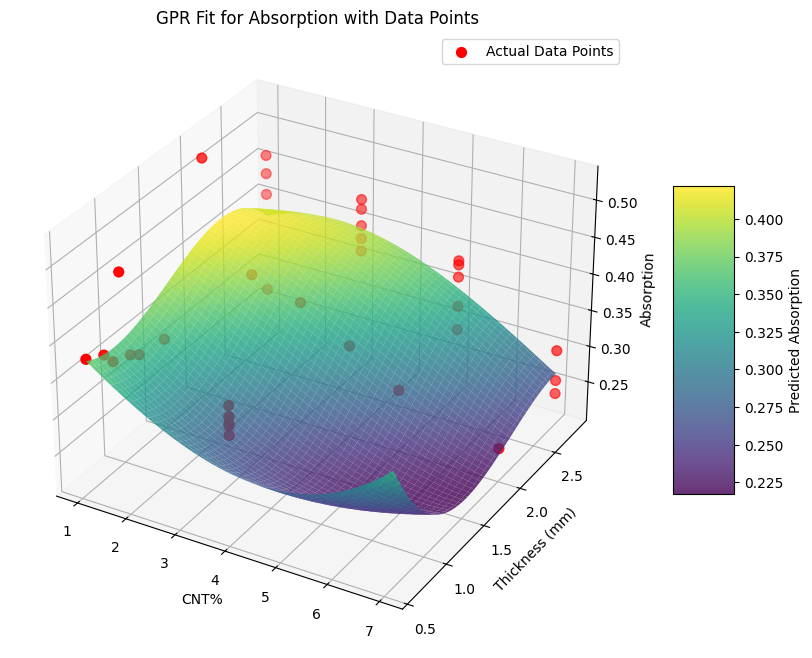

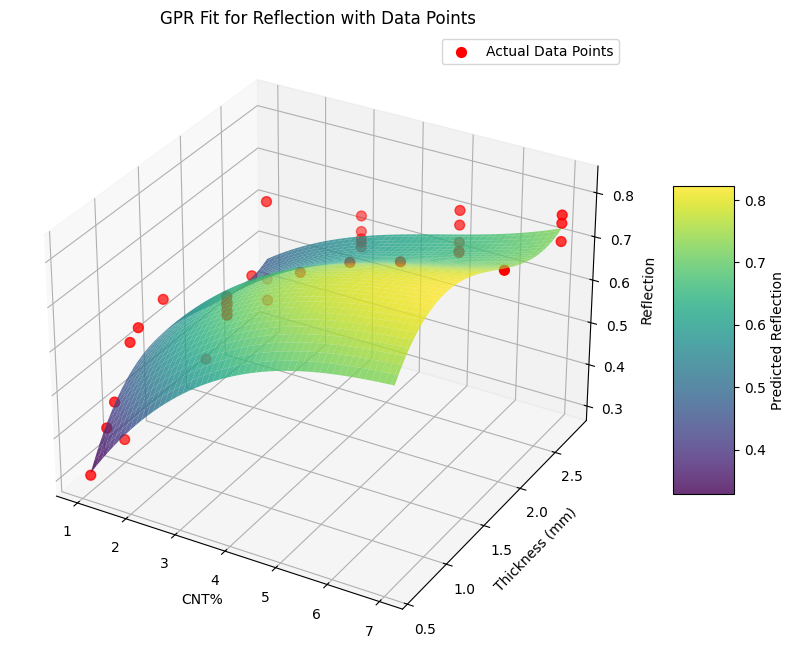

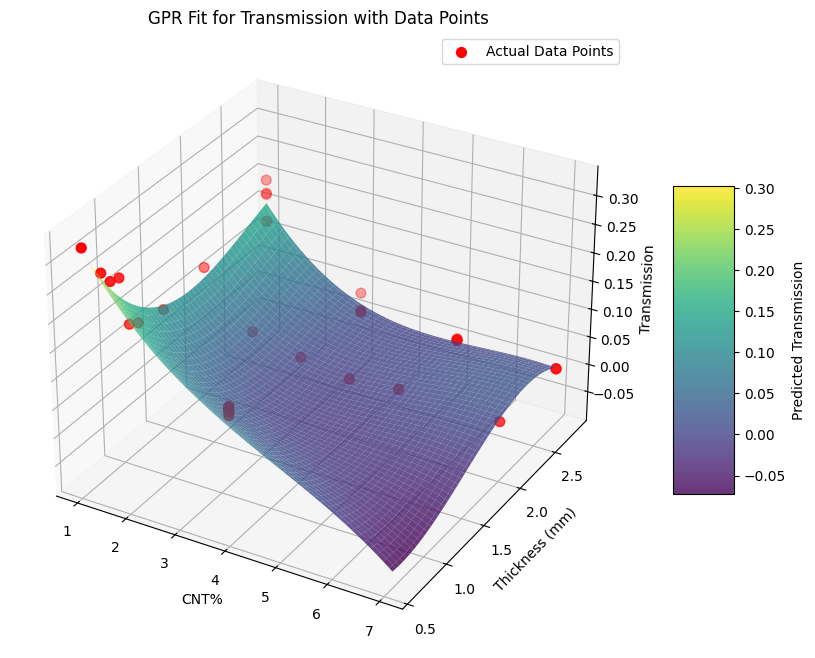

In [ ]:
def create_train_visualize_gpr_custom_normalized(thesis_df, target, grid_resolution=100):
    """
    Train a GPR model with target-specific kernel configurations and visualize the fit,
    with normalization of input features.

    Parameters:
    - thesis_df (pd.DataFrame): The dataset containing input features and targets.
    - target (str): The target variable to predict ('absorption', 'reflection', or 'transmission').
    - grid_resolution (int): Resolution for the prediction grid.

    Returns:
    - gpr_model (GaussianProcessRegressor): Trained GPR model.
    """
    # Extract features and target from thesis_df
    features = thesis_df[['cnt_pct', 'thickness']].values
    targets = thesis_df[f'mean_{target[0].lower()}'].values

    # Normalize the features
    scaler = MinMaxScaler()
    features_scaled = scaler.fit_transform(features)

    # Define custom kernel configurations based on the target variable
    if target == "absorption":
        kernel = C(1.0, (1e-1, 1e3)) * RBF(length_scale=0.5, length_scale_bounds=(1e1, 1e3))
    elif target in ["reflection", "transmission"]:
        kernel = C(1.0, (1e-2, 1e3)) * RBF(length_scale=2.0, length_scale_bounds=(1e1, 1e3))
    else:
        raise ValueError(f"Unknown target: {target}. Choose from 'absorption', 'reflection', or 'transmission'.")

    # Train the Gaussian Process Regressor
    gpr_model = GaussianProcessRegressor(kernel=kernel, alpha=1e-6, n_restarts_optimizer=10)
    gpr_model.fit(features_scaled, targets)

    # Generate grid for predictions
    CNT_grid = np.linspace(thesis_df['CNT%'].min(), thesis_df['CNT%'].max(), grid_resolution)
    Thickness_grid = np.linspace(thesis_df['Thickness'].min(), thesis_df['Thickness'].max(), grid_resolution)
    CNT_grid, Thickness_grid = np.meshgrid(CNT_grid, Thickness_grid)
    X_pred = np.c_[CNT_grid.ravel(), Thickness_grid.ravel()]
    X_pred_scaled = scaler.transform(X_pred)

    # Make predictions
    y_pred, y_std = gpr_model.predict(X_pred_scaled, return_std=True)
    y_pred = y_pred.reshape(CNT_grid.shape)

    # Plot the surface and overlay data points
    fig = plt.figure(figsize=(12, 8))
    ax = fig.add_subplot(111, projection='3d')
    surf = ax.plot_surface(CNT_grid, Thickness_grid, y_pred, cmap='viridis', alpha=0.8)
    fig.colorbar(surf, shrink=0.5, aspect=5, label=f'Predicted {target.capitalize()}')

    # Overlay the actual data points
    ax.scatter(
        thesis_df['CNT%'], thesis_df['Thickness'], thesis_df[f'mean_{target[0].lower()}'],
        c='red', label='Actual Data Points', s=50
    )

    # Labels and title
    ax.set_xlabel('CNT%')
    ax.set_ylabel('Thickness (mm)')
    ax.set_zlabel(f'{target.capitalize()}')
    ax.set_title(f'GPR Fit for {target.capitalize()} with Data Points')
    ax.legend()
    plt.show()

    return gpr_model

# Example usage for each target:
gpr_model_absorption = create_train_visualize_gpr_custom_normalized(thesis_df, target="absorption")
gpr_model_reflection = create_train_visualize_gpr_custom_normalized(thesis_df, target="reflection")
gpr_model_transmission = create_train_visualize_gpr_custom_normalized(thesis_df, target="transmission")


Optimization

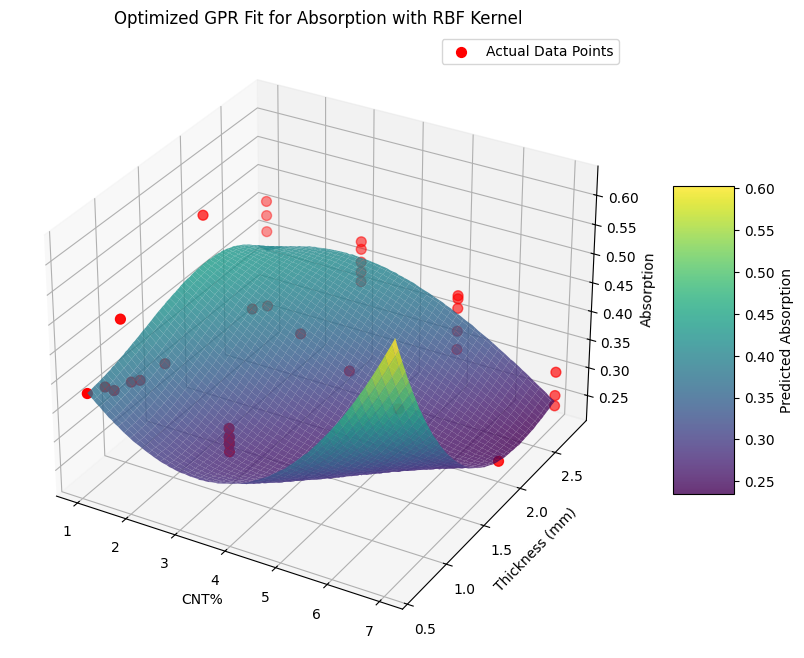

Best Absorption Model Parameters: {'length_scale': 0.1, 'length_scale_bounds': (100.0, 10000.0), 'constant': 1.0, 'alpha': 1e-10, 'loss': 0.012156219302128853}


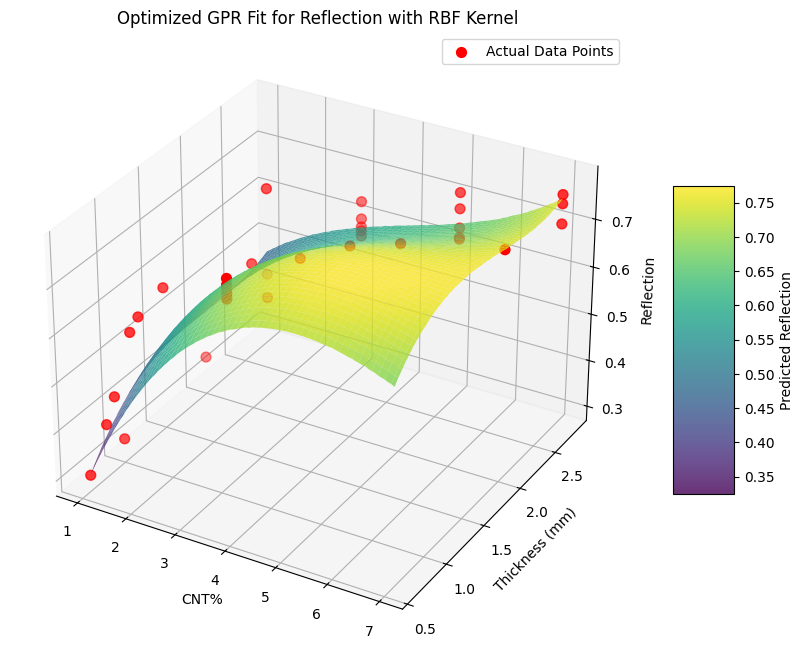

Best Reflection Model Parameters: {'length_scale': 0.1, 'length_scale_bounds': (100.0, 10000.0), 'constant': 1.0, 'alpha': 1e-10, 'loss': 0.015020231354209282}


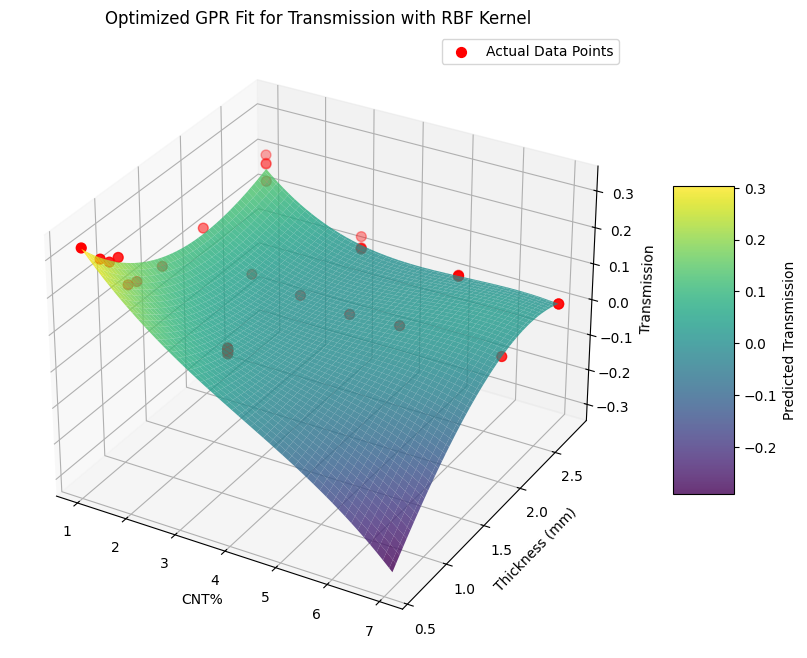

Best Transmission Model Parameters: {'length_scale': 0.1, 'length_scale_bounds': (100.0, 10000.0), 'constant': 1.0, 'alpha': 1e-10, 'loss': 0.010796799076837634}


In [ ]:
def custom_loss(y_true, y_pred, kernel):
    """
    Custom loss function to penalize spiky fits.
    Rewards smoother fits with larger length_scale values.

    Parameters:
    - y_true (array): True target values.
    - y_pred (array): Predicted target values.
    - kernel: The kernel of the GPR model.

    Returns:
    - float: Computed loss.
    """
    mse = np.mean((y_true - y_pred) ** 2)  # Mean Squared Error
    length_scale = kernel.k2.length_scale  # Extract RBF length scale
    penalty = 1 / (length_scale + 1e-6)  # Penalize small length_scale values
    return mse + penalty

def grid_search_rbf(thesis_df, target, grid_resolution=100):
    """
    Perform grid search to optimize hyperparameters of the RBF kernel.

    Parameters:
    - thesis_df (pd.DataFrame): The dataset containing input features and targets.
    - target (str): The target variable to predict ('absorption', 'reflection', or 'transmission').
    - grid_resolution (int): Resolution for the prediction grid.

    Returns:
    - best_model (GaussianProcessRegressor): Trained GPR model with the best RBF kernel.
    - best_params (dict): Optimal hyperparameters of the RBF kernel.
    """
    # Extract features and target
    X = thesis_df[['cnt_pct', 'thickness']].values
    y = thesis_df[f'mean_{target[0].lower()}'].values

    # Split into train and validation sets
    X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42)

    # Hyperparameter grid
    length_scales = [0.1]
    length_scale_bounds = [(1e-2, 1e1), (1e-1, 1e2), (1e-1, 1e1), (1e0, 1e1), (1e0, 1e2), (1e1, 1e3), (1e2, 1e4),]
    constants = [1.0, 2.0]
    alphas = [1e-10]

    best_loss = float('inf')
    best_model = None
    best_params = None

    # Grid search
    for ls in length_scales:
        for lsb in length_scale_bounds:
            for c in constants:
                for alpha in alphas:
                    # Define kernel
                    kernel = C(c, (1e-3, 1e3)) * RBF(length_scale=ls, length_scale_bounds=lsb)
                    gpr = GaussianProcessRegressor(kernel=kernel, alpha=alpha, n_restarts_optimizer=10)
                    gpr.fit(X_train, y_train)
                    y_val_pred = gpr.predict(X_val)
                    loss = custom_loss(y_val, y_val_pred, gpr.kernel_)

                    # Update best model if lower loss is found
                    if loss < best_loss:
                        best_loss = loss
                        best_model = gpr
                        best_params = {
                            "length_scale": ls,
                            "length_scale_bounds": lsb,
                            "constant": c,
                            "alpha": alpha,
                            "loss": loss,
                        }

    # Generate grid for predictions
    CNT_grid = np.linspace(thesis_df['CNT%'].min(), thesis_df['CNT%'].max(), grid_resolution)
    Thickness_grid = np.linspace(thesis_df['Thickness'].min(), thesis_df['Thickness'].max(), grid_resolution)
    CNT_grid, Thickness_grid = np.meshgrid(CNT_grid, Thickness_grid)
    X_pred = np.c_[CNT_grid.ravel(), Thickness_grid.ravel()]

    # Make predictions
    y_pred, y_std = best_model.predict(X_pred, return_std=True)
    y_pred = y_pred.reshape(CNT_grid.shape)

    # Plot the results
    fig = plt.figure(figsize=(12, 8))
    ax = fig.add_subplot(111, projection='3d')
    surf = ax.plot_surface(CNT_grid, Thickness_grid, y_pred, cmap='viridis', alpha=0.8)
    fig.colorbar(surf, shrink=0.5, aspect=5, label=f'Predicted {target.capitalize()}')

    # Overlay the actual data points
    ax.scatter(
        thesis_df['CNT%'], thesis_df['Thickness'], thesis_df[f'mean_{target[0].lower()}'],
        c='red', label='Actual Data Points', s=50
    )

    # Labels and title
    ax.set_xlabel('CNT%')
    ax.set_ylabel('Thickness (mm)')
    ax.set_zlabel(f'{target.capitalize()}')
    ax.set_title(f'Optimized GPR Fit for {target.capitalize()} with RBF Kernel')
    ax.legend()
    plt.show()

    return best_model, best_params

# Example usage for each target:
gpr_model_absorption, best_params_absorption = grid_search_rbf(thesis_df, target="absorption")
print("Best Absorption Model Parameters:", best_params_absorption)

gpr_model_reflection, best_params_reflection = grid_search_rbf(thesis_df, target="reflection")
print("Best Reflection Model Parameters:", best_params_reflection)

gpr_model_transmission, best_params_transmission = grid_search_rbf(thesis_df, target="transmission")
print("Best Transmission Model Parameters:", best_params_transmission)


matern

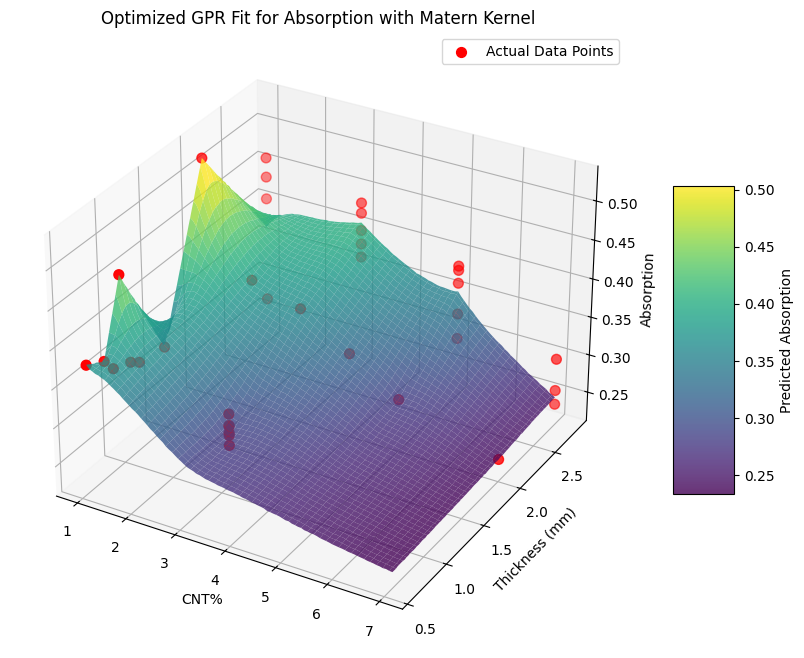

Best Absorption Model Parameters (Matern): {'length_scale': 0.5, 'length_scale_bounds': (10.0, 10000.0), 'nu': 0.5, 'loss': 0.003142718687877466}


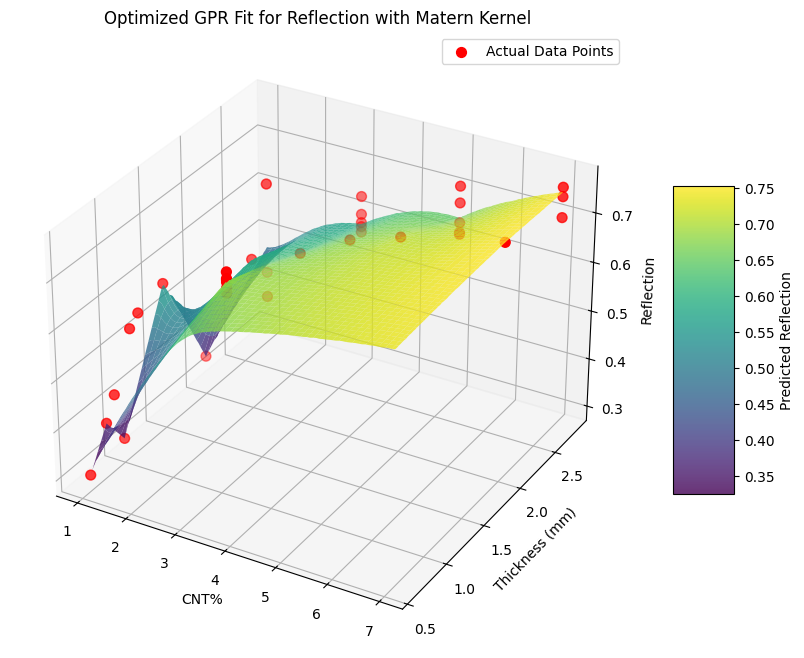

Best Reflection Model Parameters (Matern): {'length_scale': 0.5, 'length_scale_bounds': (100.0, 100000.0), 'nu': 0.5, 'loss': 0.006943114373428717}


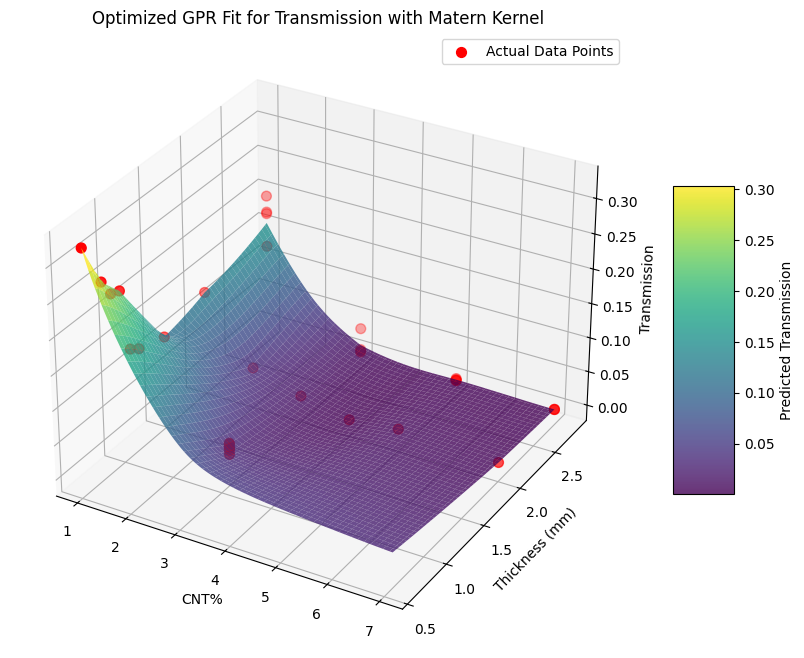

Best Transmission Model Parameters (Matern): {'length_scale': 0.5, 'length_scale_bounds': (10.0, 10000.0), 'nu': 0.5, 'loss': 0.0011041427657028989}


In [ ]:
def custom_loss_matern(y_true, y_pred, kernel):
    """
    Custom loss function to penalize spiky fits with Matern kernel.
    Rewards smoother fits with larger length_scale values.

    Parameters:
    - y_true (array): True target values.
    - y_pred (array): Predicted target values.
    - kernel: The kernel of the GPR model.

    Returns:
    - float: Computed loss.
    """
    mse = np.mean((y_true - y_pred) ** 2)  # Mean Squared Error
    length_scale = kernel.k2.length_scale  # Extract Matern length scale
    penalty = 1 / (length_scale + 1e-6)  # Penalize small length_scale values
    return mse + penalty

def grid_search_matern(thesis_df, target, grid_resolution=100):
    """
    Perform grid search to optimize hyperparameters of the Matern kernel.

    Parameters:
    - thesis_df (pd.DataFrame): The dataset containing input features and targets.
    - target (str): The target variable to predict ('absorption', 'reflection', or 'transmission').
    - grid_resolution (int): Resolution for the prediction grid.

    Returns:
    - best_model (GaussianProcessRegressor): Trained GPR model with the best Matern kernel.
    - best_params (dict): Optimal hyperparameters of the Matern kernel.
    """
    # Extract features and target
    X = thesis_df[['cnt_pct', 'thickness']].values
    y = thesis_df[f'mean_{target[0].lower()}'].values

    # Split into train and validation sets
    X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42)

    # Hyperparameter grid
    length_scales = [0.1, 0.5, 1.0]
    length_scale_bounds = [(1e-2, 1e1), (1e-1, 1e2), (1e0, 1e3), (1e1, 1e4), (1e2, 1e5)]
    nus = [0.5, 1.5, 2.5]

    best_loss = float('inf')
    best_model = None
    best_params = None

    # Grid search
    for ls in length_scales:
        for lsb in length_scale_bounds:
            for nu in nus:
                # Define kernel
                kernel = C(1.0, (1e-3, 1e3)) * Matern(length_scale=ls, length_scale_bounds=lsb, nu=nu)
                gpr = GaussianProcessRegressor(kernel=kernel, alpha=1e-10, n_restarts_optimizer=10)
                gpr.fit(X_train, y_train)
                y_val_pred = gpr.predict(X_val)
                loss = custom_loss_matern(y_val, y_val_pred, gpr.kernel_)

                # Update best model if lower loss is found
                if loss < best_loss:
                    best_loss = loss
                    best_model = gpr
                    best_params = {
                        "length_scale": ls,
                        "length_scale_bounds": lsb,
                        "nu": nu,
                        "loss": loss,
                    }

    # Generate grid for predictions
    CNT_grid = np.linspace(thesis_df['CNT%'].min(), thesis_df['CNT%'].max(), grid_resolution)
    Thickness_grid = np.linspace(thesis_df['Thickness'].min(), thesis_df['Thickness'].max(), grid_resolution)
    CNT_grid, Thickness_grid = np.meshgrid(CNT_grid, Thickness_grid)
    X_pred = np.c_[CNT_grid.ravel(), Thickness_grid.ravel()]

    # Make predictions
    y_pred, y_std = best_model.predict(X_pred, return_std=True)
    y_pred = y_pred.reshape(CNT_grid.shape)

    # Plot the results
    fig = plt.figure(figsize=(12, 8))
    ax = fig.add_subplot(111, projection='3d')
    surf = ax.plot_surface(CNT_grid, Thickness_grid, y_pred, cmap='viridis', alpha=0.8)
    fig.colorbar(surf, shrink=0.5, aspect=5, label=f'Predicted {target.capitalize()}')

    # Overlay the actual data points
    ax.scatter(
        thesis_df['CNT%'], thesis_df['Thickness'], thesis_df[f'mean_{target[0].lower()}'],
        c='red', label='Actual Data Points', s=50
    )

    # Labels and title
    ax.set_xlabel('CNT%')
    ax.set_ylabel('Thickness (mm)')
    ax.set_zlabel(f'{target.capitalize()}')
    ax.set_title(f'Optimized GPR Fit for {target.capitalize()} with Matern Kernel')
    ax.legend()
    plt.show()

    return best_model, best_params

# Example usage for each target:
gpr_model_absorption_matern, best_params_absorption_matern = grid_search_matern(thesis_df, target="absorption")
print("Best Absorption Model Parameters (Matern):", best_params_absorption_matern)

gpr_model_reflection_matern, best_params_reflection_matern = grid_search_matern(thesis_df, target="reflection")
print("Best Reflection Model Parameters (Matern):", best_params_reflection_matern)

gpr_model_transmission_matern, best_params_transmission_matern = grid_search_matern(thesis_df, target="transmission")
print("Best Transmission Model Parameters (Matern):", best_params_transmission_matern)


Periodic + RBF

In [ ]:

def custom_loss_periodic_rbf(y_true, y_pred, kernel):
    """
    Custom loss function to penalize spiky fits with Periodic + RBF kernel.
    Rewards smoother fits with larger length_scale values.

    Parameters:
    - y_true (array): True target values.
    - y_pred (array): Predicted target values.
    - kernel: The kernel of the GPR model.

    Returns:
    - float: Computed loss.
    """
    mse = np.mean((y_true - y_pred) ** 2)  # Mean Squared Error
    length_scale_rbf = kernel.k2.k1.length_scale  # Extract RBF length scale
    periodic_length_scale = kernel.k2.k2.length_scale  # Periodic kernel length scale
    penalty = 1 / (length_scale_rbf + periodic_length_scale + 1e-6)  # Penalize small length scales
    return mse + penalty

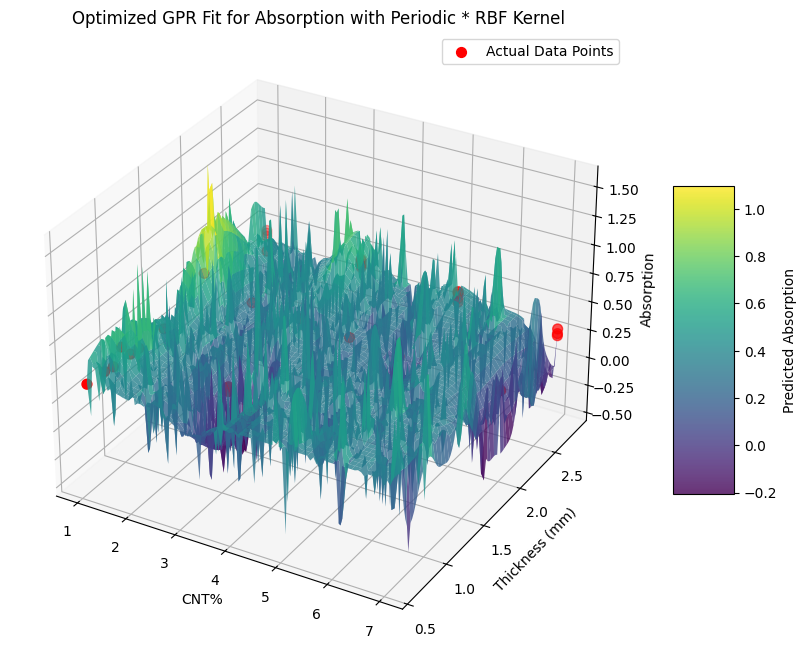

Best Absorption Model Parameters (Periodic + RBF): {'rbf_length_scale': 5.0, 'periodic_length_scale': 1.0, 'periodicity': 2.0, 'length_scale_bounds': (0.01, 100000.0), 'periodicity_bounds': (1.0, 1000.0), 'alpha': 0.01, 'loss': 0.1729945835942913}


KeyboardInterrupt: 

In [ ]:
def custom_loss_periodic_rbf(y_true, y_pred, kernel):
    residual = np.mean((y_true - y_pred) ** 2)
    # Extract kernel hyperparameters
    rbf_ls = kernel.k2.k1.length_scale  # RBF length_scale
    #periodic_ls = kernel.k2.k2.length_scale  # Periodic length_scale
    #periodicity = kernel.k2.k2.periodicity
    # Add regularization to penalize small length_scale and periodicity
    #regularization = 1 / rbf_ls  + 1 / periodicity
    return residual


def grid_search_periodic_rbf_refined(thesis_df, target, grid_resolution=100):
    """
    Perform grid search to optimize hyperparameters of the Periodic * RBF kernel with improved loss and bounds.

    Parameters:
    - thesis_df (pd.DataFrame): The dataset containing input features and targets.
    - target (str): The target variable to predict ('absorption', 'reflection', or 'transmission').
    - grid_resolution (int): Resolution for the prediction grid.

    Returns:
    - best_model (GaussianProcessRegressor): Trained GPR model with the best kernel.
    - best_params (dict): Optimal hyperparameters of the Periodic * RBF kernel.
    """
    # Extract features and target
    X = thesis_df[['cnt_pct', 'thickness']].values
    y = thesis_df[f'mean_{target[0].lower()}'].values

    # Normalize target
    y_mean, y_std = y.mean(), y.std()
    y_normalized = (y - y_mean) / y_std

    # Split into train and validation sets
    X_train, X_val, y_train, y_val = train_test_split(X, y_normalized, test_size=0.1, random_state=42)

    # Hyperparameter grid
    rbf_length_scales = [0.1, 0.5, 1.0, 2.0, 5.0]
    periodic_length_scales = [0.1, 0.5, 1.0, 2.0]
    periodic_periodicities = [0.1, 0.5, 1.0, 2.0]
    length_scale_bounds_options = [(1e-2, 1e5)]   # increase lower bound
    periodicity_bounds_options = [(1.0, 1e3)]
    alpha_values = [1e-3, 1e-2]

    best_loss = float('inf')
    best_model = None
    best_params = None

    # Grid search
    for rbf_ls in rbf_length_scales:
        for periodic_ls in periodic_length_scales:
            for periodicity in periodic_periodicities:
                for length_scale_bounds in length_scale_bounds_options:
                    for periodicity_bounds in periodicity_bounds_options:
                        for alpha in alpha_values:
                            # Define kernel
                            kernel = C(1.0, (1e-2, 1e3)) * (
                                RBF(length_scale=rbf_ls, length_scale_bounds=length_scale_bounds)
                                + ExpSineSquared(length_scale=periodic_ls, periodicity=periodicity,
                                                 length_scale_bounds=length_scale_bounds,
                                                 periodicity_bounds=periodicity_bounds)
                            )
                            gpr = GaussianProcessRegressor(kernel=kernel, alpha=alpha, n_restarts_optimizer=10)
                            gpr.fit(X_train, y_train)
                            y_val_pred = gpr.predict(X_val)
                            loss = custom_loss_periodic_rbf(y_val, y_val_pred, gpr.kernel_)

                            # Update best model
                            if loss < best_loss:
                                best_loss = loss
                                best_model = gpr
                                best_params = {
                                    "rbf_length_scale": rbf_ls,
                                    "periodic_length_scale": periodic_ls,
                                    "periodicity": periodicity,
                                    "length_scale_bounds": length_scale_bounds,
                                    "periodicity_bounds": periodicity_bounds,
                                    "alpha": alpha,
                                    "loss": loss,
                                }

    # Visualization (same as previous)
    # Generate grid for predictions
    CNT_grid = np.linspace(thesis_df['CNT%'].min(), thesis_df['CNT%'].max(), grid_resolution)
    Thickness_grid = np.linspace(thesis_df['Thickness'].min(), thesis_df['Thickness'].max(), grid_resolution)
    CNT_grid, Thickness_grid = np.meshgrid(CNT_grid, Thickness_grid)
    X_pred = np.c_[CNT_grid.ravel(), Thickness_grid.ravel()]

    # Make predictions
    y_pred, y_std = best_model.predict(X_pred, return_std=True)

    # Reshape both predictions and standard deviations to match the grid
    y_pred = y_pred.reshape(CNT_grid.shape)
    y_std = y_std.reshape(CNT_grid.shape)

    # Plot results
    fig = plt.figure(figsize=(12, 8))
    ax = fig.add_subplot(111, projection='3d')

    # Adjust plotting to include predictions and uncertainty
    surf = ax.plot_surface(
        CNT_grid, Thickness_grid, y_pred * y_std + y_mean, cmap='viridis', alpha=0.8
    )
    fig.colorbar(surf, shrink=0.5, aspect=5, label=f'Predicted {target.capitalize()}')

    # Overlay the actual data points
    ax.scatter(
        thesis_df['CNT%'], thesis_df['Thickness'], thesis_df[f'mean_{target[0].lower()}'],
        c='red', label='Actual Data Points', s=50
    )

    # Labels and title
    ax.set_xlabel('CNT%')
    ax.set_ylabel('Thickness (mm)')
    ax.set_zlabel(f'{target.capitalize()}')
    ax.set_title(f'Optimized GPR Fit for {target.capitalize()} with Periodic * RBF Kernel')
    ax.legend()
    plt.show()


    return best_model, best_params

# Example usage for each target:
gpr_model_absorption_prbf, best_params_absorption_prbf = grid_search_periodic_rbf_refined(thesis_df, target="absorption")
print("Best Absorption Model Parameters (Periodic + RBF):", best_params_absorption_prbf)

gpr_model_reflection_prbf, best_params_reflection_prbf = grid_search_periodic_rbf_refined(thesis_df, target="reflection")
print("Best Reflection Model Parameters (Periodic + RBF):", best_params_reflection_prbf)

gpr_model_transmission_prbf, best_params_transmission_prbf = grid_search_periodic_rbf_refined(thesis_df, target="transmission")
print("Best Transmission Model Parameters (Periodic + RBF):", best_params_transmission_prbf)


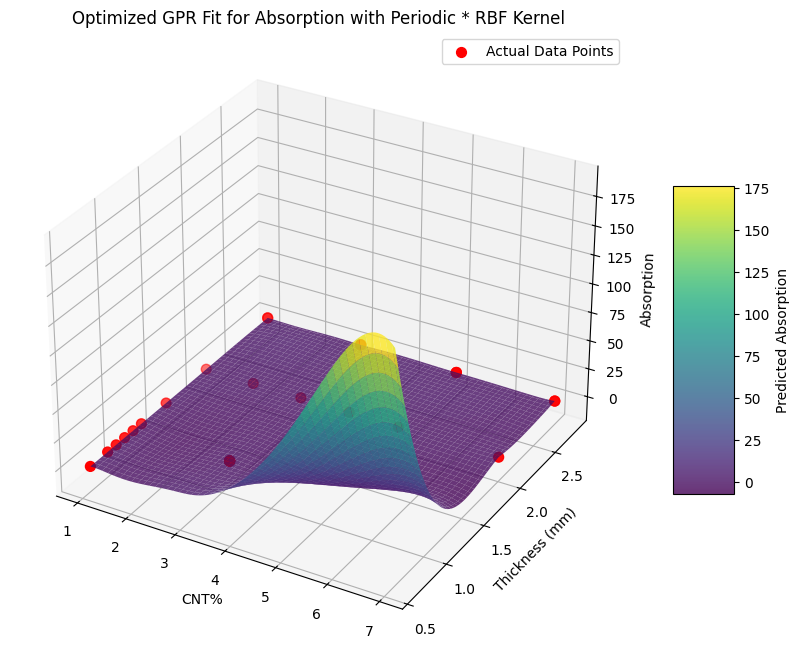

Best Absorption Model Parameters (Periodic + RBF): {'rbf_length_scale': 0.1, 'periodic_length_scale': 0.5, 'periodicity': 0.5, 'length_scale_bounds': (3.5, 100000.0), 'periodicity_bounds': (0.1, 1000.0), 'alpha': 0.001, 'loss': 0.47171290341044714}


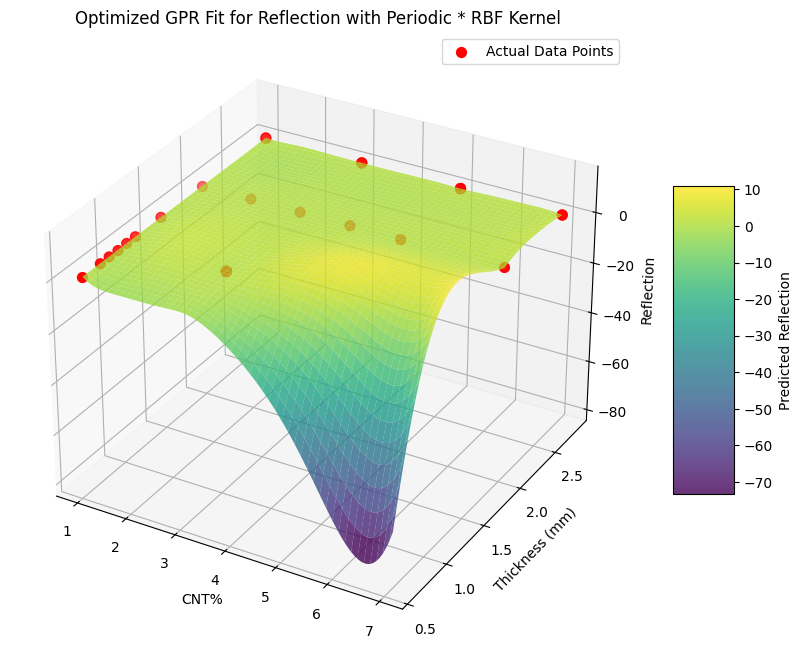

Best Reflection Model Parameters (Periodic + RBF): {'rbf_length_scale': 0.1, 'periodic_length_scale': 0.1, 'periodicity': 2.0, 'length_scale_bounds': (3.5, 100000.0), 'periodicity_bounds': (0.1, 1000.0), 'alpha': 0.0001, 'loss': 0.37175888022321746}


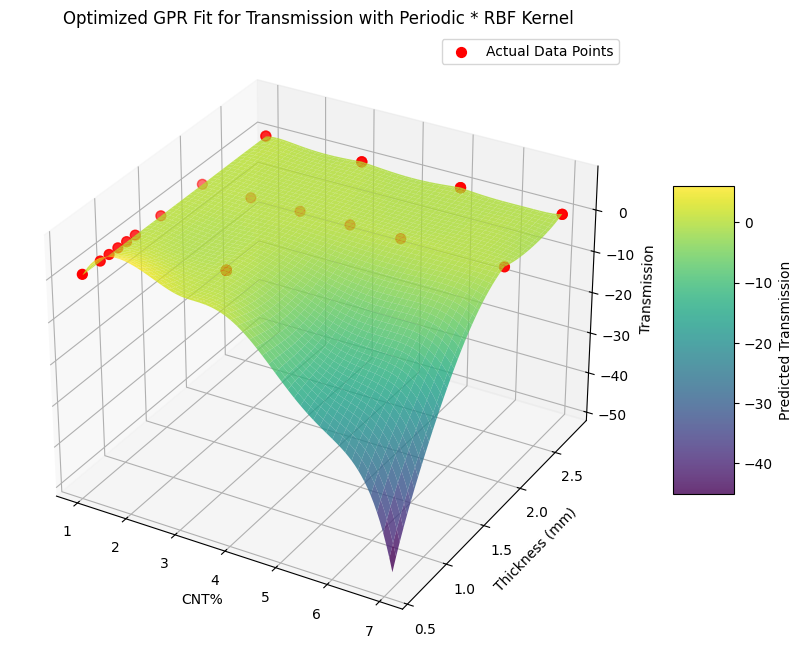

Best Transmission Model Parameters (Periodic + RBF): {'rbf_length_scale': 0.5, 'periodic_length_scale': 0.5, 'periodicity': 5.0, 'length_scale_bounds': (3.5, 100000.0), 'periodicity_bounds': (0.1, 1000.0), 'alpha': 0.0001, 'loss': 0.30483412820648936}


In [ ]:
def custom_loss_periodic_rbf(y_true, y_pred, kernel):
    residual = np.mean((y_true - y_pred) ** 2)
    # Extract kernel hyperparameters
    rbf_ls = kernel.k2.k1.length_scale  # RBF length_scale
    periodic_ls = kernel.k2.k2.length_scale  # Periodic length_scale
    periodicity = kernel.k2.k2.periodicity
    # Add regularization to penalize small length_scale and periodicity
    regularization = 1 / rbf_ls + 1 / periodic_ls + 1 / periodicity
    return residual + regularization


def grid_search_periodic_rbf_refined(thesis_df, target, grid_resolution=100):
    """
    Perform grid search to optimize hyperparameters of the Periodic * RBF kernel with improved loss and bounds.

    Parameters:
    - thesis_df (pd.DataFrame): The dataset containing input features and targets.
    - target (str): The target variable to predict ('absorption', 'reflection', or 'transmission').
    - grid_resolution (int): Resolution for the prediction grid.

    Returns:
    - best_model (GaussianProcessRegressor): Trained GPR model with the best kernel.
    - best_params (dict): Optimal hyperparameters of the Periodic * RBF kernel.
    """
    # Extract features and target
    X = thesis_df[['cnt_pct', 'thickness']].values
    y = thesis_df[f'mean_{target[0].lower()}'].values

    # Normalize target
    y_mean, y_std = y.mean(), y.std()
    y_normalized = (y - y_mean) / y_std

    # Split into train and validation sets
    X_train, X_val, y_train, y_val = train_test_split(X, y_normalized, test_size=0.1, random_state=42)

    # Hyperparameter grid
    rbf_length_scales = [0.1, 0.2,0.5]
    periodic_length_scales = [0.1, 0.5, 1.0]
    periodic_periodicities = [0.1, 0.5, 1.0, 2.0, 5.0]
    length_scale_bounds_options = [(2.5, 1e5)]
    periodicity_bounds_options = [(1e-1, 1e3)]
    alpha_values = [1e-3, 1e-4]

    best_loss = float('inf')
    best_model = None
    best_params = None

    # Grid search
    for rbf_ls in rbf_length_scales:
        for periodic_ls in periodic_length_scales:
            for periodicity in periodic_periodicities:
                for length_scale_bounds in length_scale_bounds_options:
                    for periodicity_bounds in periodicity_bounds_options:
                        for alpha in alpha_values:
                            # Define kernel
                            kernel = C(1.0, (1e-5, 1e5)) * (
                                RBF(length_scale=rbf_ls, length_scale_bounds=length_scale_bounds)
                                * ExpSineSquared(length_scale=periodic_ls, periodicity=periodicity,
                                                 length_scale_bounds=length_scale_bounds,
                                                 periodicity_bounds=periodicity_bounds)
                            )
                            gpr = GaussianProcessRegressor(kernel=kernel, alpha=alpha, n_restarts_optimizer=10)
                            gpr.fit(X_train, y_train)
                            y_val_pred = gpr.predict(X_val)
                            loss = custom_loss_periodic_rbf(y_val, y_val_pred, gpr.kernel_)

                            # Update best model
                            if loss < best_loss:
                                best_loss = loss
                                best_model = gpr
                                best_params = {
                                    "rbf_length_scale": rbf_ls,
                                    "periodic_length_scale": periodic_ls,
                                    "periodicity": periodicity,
                                    "length_scale_bounds": length_scale_bounds,
                                    "periodicity_bounds": periodicity_bounds,
                                    "alpha": alpha,
                                    "loss": loss,
                                }

    # Visualization (same as previous)
    # Generate grid for predictions
    CNT_grid = np.linspace(thesis_df['CNT%'].min(), thesis_df['CNT%'].max(), grid_resolution)
    Thickness_grid = np.linspace(thesis_df['Thickness'].min(), thesis_df['Thickness'].max(), grid_resolution)
    CNT_grid, Thickness_grid = np.meshgrid(CNT_grid, Thickness_grid)
    X_pred = np.c_[CNT_grid.ravel(), Thickness_grid.ravel()]

    # Make predictions
    y_pred, y_std = best_model.predict(X_pred, return_std=True)

    # Reshape both predictions and standard deviations to match the grid
    y_pred = y_pred.reshape(CNT_grid.shape)
    y_std = y_std.reshape(CNT_grid.shape)

    # Plot results
    fig = plt.figure(figsize=(12, 8))
    ax = fig.add_subplot(111, projection='3d')

    # Adjust plotting to include predictions and uncertainty
    surf = ax.plot_surface(
        CNT_grid, Thickness_grid, y_pred * y_std + y_mean, cmap='viridis', alpha=0.8
    )
    fig.colorbar(surf, shrink=0.5, aspect=5, label=f'Predicted {target.capitalize()}')

    # Overlay the actual data points
    ax.scatter(
        thesis_df['CNT%'], thesis_df['Thickness'], thesis_df[f'mean_{target[0].lower()}'],
        c='red', label='Actual Data Points', s=50
    )

    # Labels and title
    ax.set_xlabel('CNT%')
    ax.set_ylabel('Thickness (mm)')
    ax.set_zlabel(f'{target.capitalize()}')
    ax.set_title(f'Optimized GPR Fit for {target.capitalize()} with Periodic * RBF Kernel')
    ax.legend()
    plt.show()


    return best_model, best_params

# Example usage for each target:
gpr_model_absorption_prbf, best_params_absorption_prbf = grid_search_periodic_rbf_refined(thesis_df, target="absorption")
print("Best Absorption Model Parameters (Periodic + RBF):", best_params_absorption_prbf)

gpr_model_reflection_prbf, best_params_reflection_prbf = grid_search_periodic_rbf_refined(thesis_df, target="reflection")
print("Best Reflection Model Parameters (Periodic + RBF):", best_params_reflection_prbf)

gpr_model_transmission_prbf, best_params_transmission_prbf = grid_search_periodic_rbf_refined(thesis_df, target="transmission")
print("Best Transmission Model Parameters (Periodic + RBF):", best_params_transmission_prbf)


Periodic

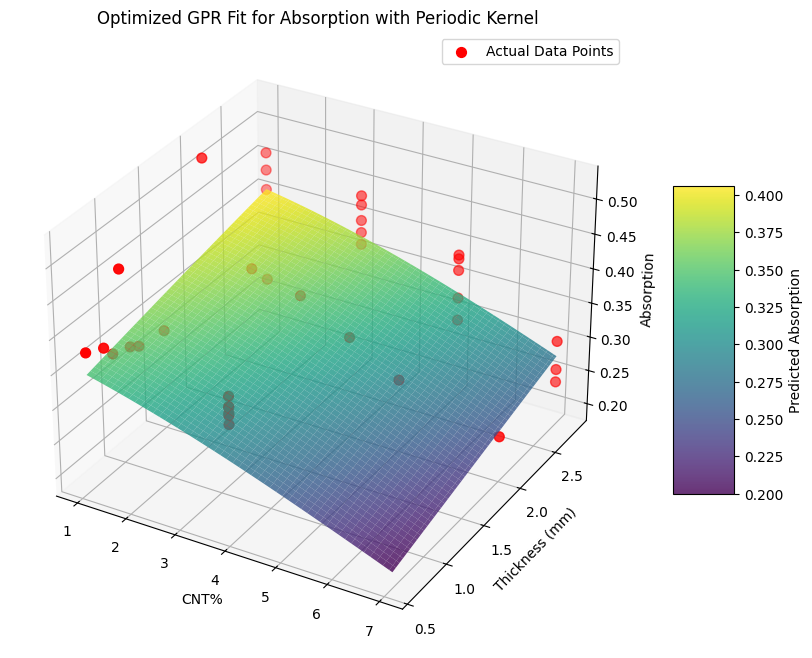

Best Absorption Model Parameters (Periodic Kernel): {'periodic_length_scale': 0.1, 'periodicity': 1.0, 'periodicity_bounds': (1.0, 1000.0), 'alpha': 0.001, 'loss': 0.0007669401090836764}


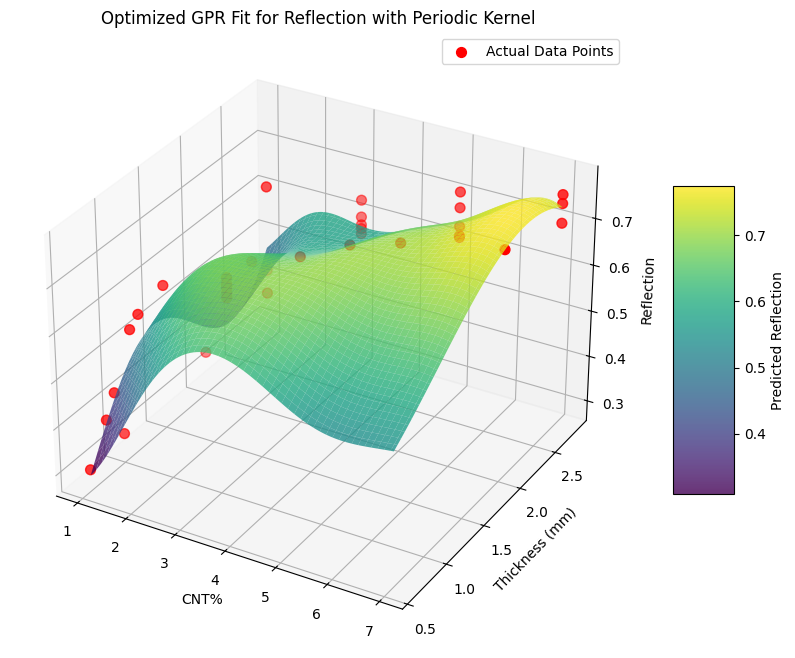

Best Reflection Model Parameters (Periodic Kernel): {'periodic_length_scale': 2.0, 'periodicity': 0.5, 'periodicity_bounds': (1.0, 10.0), 'alpha': 0.001, 'loss': 0.003167601777730428}


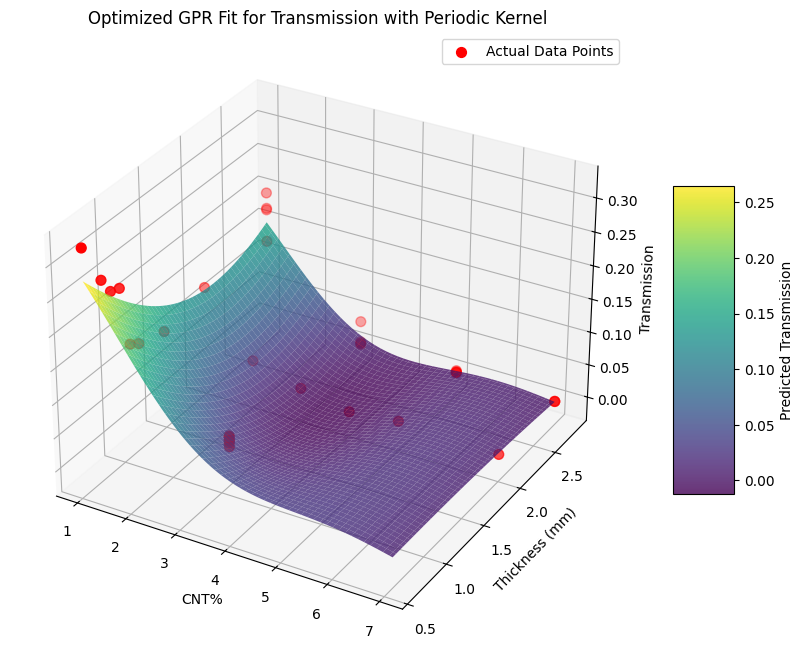

Best Transmission Model Parameters (Periodic Kernel): {'periodic_length_scale': 0.1, 'periodicity': 5.0, 'periodicity_bounds': (1.0, 1000.0), 'alpha': 0.001, 'loss': 0.000923614905671021}


In [ ]:
def custom_loss_periodic(y_true, y_pred, kernel):
    """
    Custom loss function for GPR with a periodic kernel.

    Parameters:
    - y_true: True target values.
    - y_pred: Predicted target values.
    - kernel: The GPR kernel used for predictions.

    Returns:
    - Loss: Weighted sum of MSE and periodicity penalty.
    """
    # Accuracy: Mean Squared Error
    mse_loss = np.mean((y_true - y_pred) ** 2)

    # Smoothness penalty based on kernel periodicity
    periodicity_penalty = 1 / kernel.k2.periodicity  # Penalize shorter periodicity

    # Total loss
    return mse_loss + 0.01 * periodicity_penalty  # Adjust weight as needed

def grid_search_periodic_kernel(thesis_df, target, grid_resolution=100):
    """
    Perform grid search to optimize hyperparameters of the periodic kernel.

    Parameters:
    - thesis_df (pd.DataFrame): The dataset containing input features and targets.
    - target (str): The target variable to predict ('absorption', 'reflection', or 'transmission').
    - grid_resolution (int): Resolution for the prediction grid.

    Returns:
    - best_model (GaussianProcessRegressor): Trained GPR model with the best periodic kernel.
    - best_params (dict): Optimal hyperparameters of the periodic kernel.
    """
    # Extract features and target
    X = thesis_df[['cnt_pct', 'thickness']].values
    y = thesis_df[f'mean_{target[0].lower()}'].values

    # Split into train and validation sets
    X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.1, random_state=42)

    # Hyperparameter grid
    periodic_length_scales = [0.01, 0.05, 0.1, 0.5, 1.0, 2.0]
    periodic_periodicities = [0.5, 1.0, 2.0, 5.0, 10.0]
    periodicity_bounds_options = [(1.0, 10.0), (1.0, 100.0), (1.0, 1000.0)]
    alpha_values = [1e-3]

    best_loss = float('inf')
    best_model = None
    best_params = None

    # Grid search
    for periodic_ls in periodic_length_scales:
        for periodicity in periodic_periodicities:
            for periodicity_bounds in periodicity_bounds_options:
                for alpha in alpha_values:
                    # Define kernel
                    kernel = C(1.0, (1e-1, 1e3)) * ExpSineSquared(
                        length_scale=periodic_ls,
                        periodicity=periodicity,
                        periodicity_bounds=periodicity_bounds,
                    )
                    gpr = GaussianProcessRegressor(kernel=kernel, alpha=alpha, n_restarts_optimizer=10)
                    gpr.fit(X_train, y_train)
                    y_val_pred = gpr.predict(X_val)
                    loss = custom_loss_periodic(y_val, y_val_pred, gpr.kernel_)

                    # Update best model if lower loss is found
                    if loss < best_loss:
                        best_loss = loss
                        best_model = gpr
                        best_params = {
                            "periodic_length_scale": periodic_ls,
                            "periodicity": periodicity,
                            "periodicity_bounds": periodicity_bounds,
                            "alpha": alpha,
                            "loss": loss,
                        }

    # Generate grid for predictions
    CNT_grid = np.linspace(thesis_df['CNT%'].min(), thesis_df['CNT%'].max(), grid_resolution)
    Thickness_grid = np.linspace(thesis_df['Thickness'].min(), thesis_df['Thickness'].max(), grid_resolution)
    CNT_grid, Thickness_grid = np.meshgrid(CNT_grid, Thickness_grid)
    X_pred = np.c_[CNT_grid.ravel(), Thickness_grid.ravel()]

    # Make predictions
    y_pred, y_std = best_model.predict(X_pred, return_std=True)
    y_pred = y_pred.reshape(CNT_grid.shape)

    # Plot the results
    fig = plt.figure(figsize=(12, 8))
    ax = fig.add_subplot(111, projection='3d')
    surf = ax.plot_surface(CNT_grid, Thickness_grid, y_pred, cmap='viridis', alpha=0.8)
    fig.colorbar(surf, shrink=0.5, aspect=5, label=f'Predicted {target.capitalize()}')

    # Overlay the actual data points
    ax.scatter(
        thesis_df['CNT%'], thesis_df['Thickness'], thesis_df[f'mean_{target[0].lower()}'],
        c='red', label='Actual Data Points', s=50
    )

    # Labels and title
    ax.set_xlabel('CNT%')
    ax.set_ylabel('Thickness (mm)')
    ax.set_zlabel(f'{target.capitalize()}')
    ax.set_title(f'Optimized GPR Fit for {target.capitalize()} with Periodic Kernel')
    ax.legend()
    plt.show()

    return best_model, best_params

# Example usage for each target:
gpr_model_absorption_periodic, best_params_absorption_periodic = grid_search_periodic_kernel(thesis_df, target="absorption")
print("Best Absorption Model Parameters (Periodic Kernel):", best_params_absorption_periodic)

gpr_model_reflection_periodic, best_params_reflection_periodic = grid_search_periodic_kernel(thesis_df, target="reflection")
print("Best Reflection Model Parameters (Periodic Kernel):", best_params_reflection_periodic)

gpr_model_transmission_periodic, best_params_transmission_periodic = grid_search_periodic_kernel(thesis_df, target="transmission")
print("Best Transmission Model Parameters (Periodic Kernel):", best_params_transmission_periodic)


Rational Quadratic

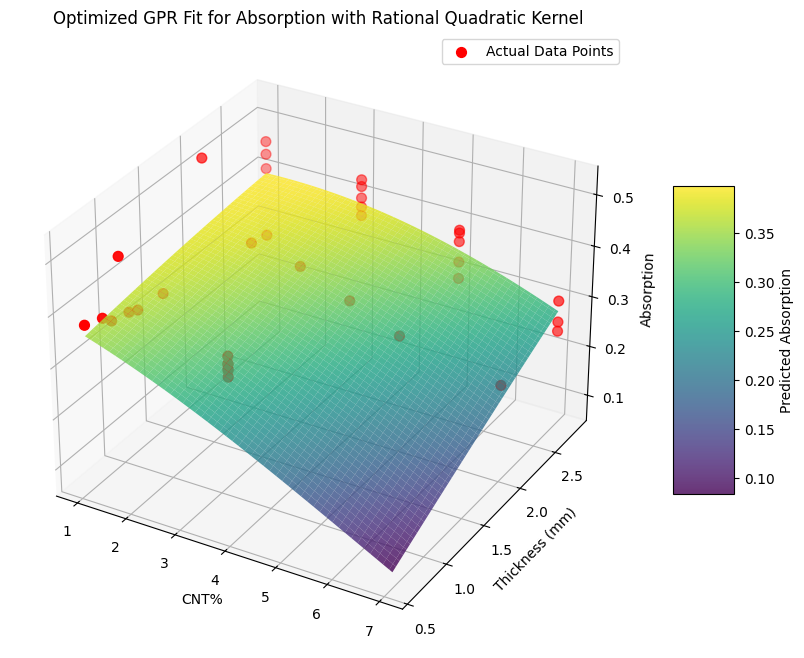

Best Absorption Model Parameters (Rational Quadratic): {'length_scale': 1.0, 'alpha': 1.0, 'length_scale_bounds': (10.0, 1000.0), 'alpha_bounds': (10.0, 1000.0), 'noise_alpha': 0.001, 'loss': 0.0028434461947780126}


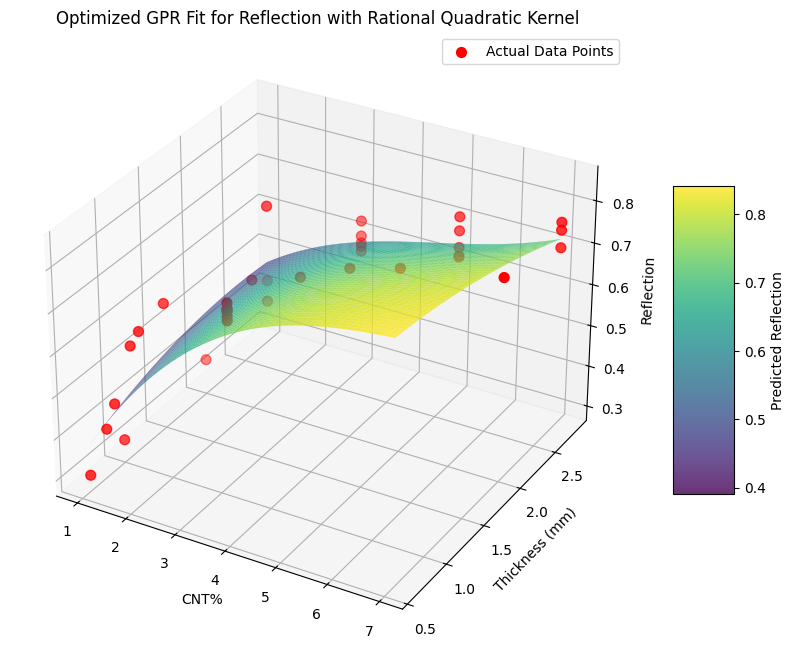

Best Reflection Model Parameters (Rational Quadratic): {'length_scale': 5.0, 'alpha': 0.5, 'length_scale_bounds': (10.0, 1000.0), 'alpha_bounds': (10.0, 1000.0), 'noise_alpha': 0.001, 'loss': 0.006579988214921874}


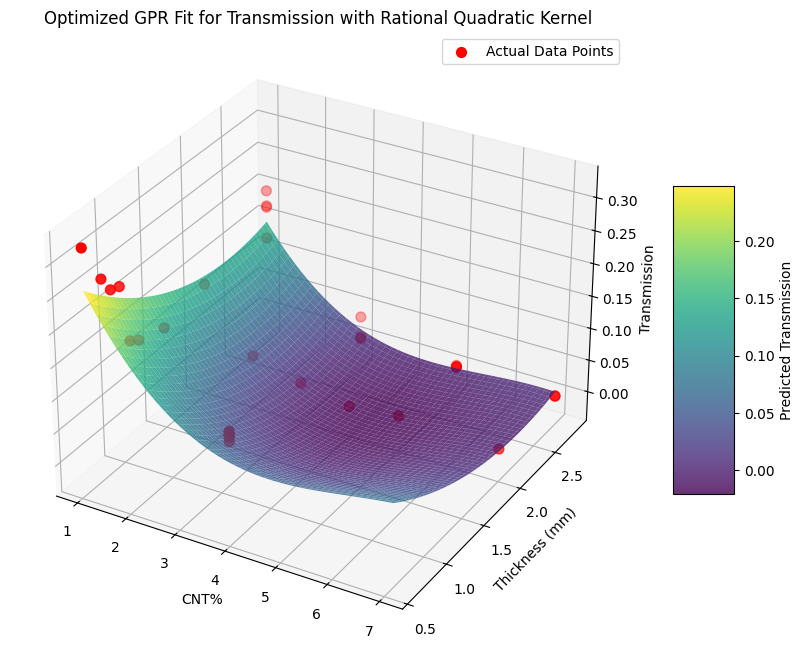

Best Transmission Model Parameters (Rational Quadratic): {'length_scale': 0.5, 'alpha': 1.0, 'length_scale_bounds': (10.0, 1000.0), 'alpha_bounds': (10.0, 1000.0), 'noise_alpha': 0.001, 'loss': 0.0031250557671261203}


In [ ]:
def custom_loss_rational_quadratic(y_true, y_pred, kernel):
    """
    Custom loss function for GPR with Rational Quadratic kernel.

    Parameters:
    - y_true: True target values.
    - y_pred: Predicted target values.
    - kernel: The GPR kernel used for predictions.

    Returns:
    - Loss: Weighted sum of MSE and kernel-based penalties.
    """
    # Mean Squared Error
    mse_loss = np.mean((y_true - y_pred) ** 2)

    # Regularization: Penalize small length_scale and alpha
    length_scale = kernel.k2.length_scale
    alpha = kernel.k2.alpha
    smoothness_penalty = 1 / length_scale + 1 / alpha  # Penalize small values

    # Total loss
    return mse_loss + 0.01 * smoothness_penalty  # Adjust regularization weight as needed


def grid_search_rational_quadratic(thesis_df, target, grid_resolution=100):
    """
    Perform grid search to optimize hyperparameters of the Rational Quadratic kernel.

    Parameters:
    - thesis_df (pd.DataFrame): The dataset containing input features and targets.
    - target (str): The target variable to predict ('absorption', 'reflection', or 'transmission').
    - grid_resolution (int): Resolution for the prediction grid.

    Returns:
    - best_model (GaussianProcessRegressor): Trained GPR model with the best Rational Quadratic kernel.
    - best_params (dict): Optimal hyperparameters of the Rational Quadratic kernel.
    """
    # Extract features and target
    X = thesis_df[['cnt_pct', 'thickness']].values
    y = thesis_df[f'mean_{target[0].lower()}'].values

    # Split into train and validation sets
    X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.1, random_state=42)

    # Hyperparameter grid
    length_scales = [0.1, 0.5, 1.0, 2.0, 5.0]
    alphas = [0.1, 0.5, 1.0, 2.0, 5.0]
    length_scale_bounds_options = [(1e-2, 1e2), (1e-1, 1e3), (10.0, 1000.0)]
    alpha_bounds_options = [(1e-2, 1e2), (1e-1, 1e3), (10.0, 1000.0)]
    alpha_values = [1e-3]

    best_loss = float('inf')
    best_model = None
    best_params = None

    # Grid search
    for length_scale in length_scales:
        for alpha in alphas:
            for length_scale_bounds in length_scale_bounds_options:
                for alpha_bounds in alpha_bounds_options:
                    for noise_alpha in alpha_values:
                        # Define kernel
                        kernel = C(1.0, (1e-1, 1e3)) * RationalQuadratic(
                            length_scale=length_scale,
                            alpha=alpha,
                            length_scale_bounds=length_scale_bounds,
                            alpha_bounds=alpha_bounds
                        )
                        gpr = GaussianProcessRegressor(kernel=kernel, alpha=noise_alpha, n_restarts_optimizer=10)
                        gpr.fit(X_train, y_train)
                        y_val_pred = gpr.predict(X_val)
                        loss = custom_loss_rational_quadratic(y_val, y_val_pred, gpr.kernel_)

                        # Update best model if lower loss is found
                        if loss < best_loss:
                            best_loss = loss
                            best_model = gpr
                            best_params = {
                                "length_scale": length_scale,
                                "alpha": alpha,
                                "length_scale_bounds": length_scale_bounds,
                                "alpha_bounds": alpha_bounds,
                                "noise_alpha": noise_alpha,
                                "loss": loss,
                            }

    # Generate grid for predictions
    CNT_grid = np.linspace(thesis_df['CNT%'].min(), thesis_df['CNT%'].max(), grid_resolution)
    Thickness_grid = np.linspace(thesis_df['Thickness'].min(), thesis_df['Thickness'].max(), grid_resolution)
    CNT_grid, Thickness_grid = np.meshgrid(CNT_grid, Thickness_grid)
    X_pred = np.c_[CNT_grid.ravel(), Thickness_grid.ravel()]

    # Make predictions
    y_pred, y_std = best_model.predict(X_pred, return_std=True)
    y_pred = y_pred.reshape(CNT_grid.shape)

    # Plot the results
    fig = plt.figure(figsize=(12, 8))
    ax = fig.add_subplot(111, projection='3d')
    surf = ax.plot_surface(CNT_grid, Thickness_grid, y_pred, cmap='viridis', alpha=0.8)
    fig.colorbar(surf, shrink=0.5, aspect=5, label=f'Predicted {target.capitalize()}')

    # Overlay the actual data points
    ax.scatter(
        thesis_df['CNT%'], thesis_df['Thickness'], thesis_df[f'mean_{target[0].lower()}'],
        c='red', label='Actual Data Points', s=50
    )

    # Labels and title
    ax.set_xlabel('CNT%')
    ax.set_ylabel('Thickness (mm)')
    ax.set_zlabel(f'{target.capitalize()}')
    ax.set_title(f'Optimized GPR Fit for {target.capitalize()} with Rational Quadratic Kernel')
    ax.legend()
    plt.show()

    return best_model, best_params


# Example usage for each target:
gpr_model_absorption_rq, best_params_absorption_rq = grid_search_rational_quadratic(thesis_df, target="absorption")
print("Best Absorption Model Parameters (Rational Quadratic):", best_params_absorption_rq)

gpr_model_reflection_rq, best_params_reflection_rq = grid_search_rational_quadratic(thesis_df, target="reflection")
print("Best Reflection Model Parameters (Rational Quadratic):", best_params_reflection_rq)

gpr_model_transmission_rq, best_params_transmission_rq = grid_search_rational_quadratic(thesis_df, target="transmission")
print("Best Transmission Model Parameters (Rational Quadratic):", best_params_transmission_rq)


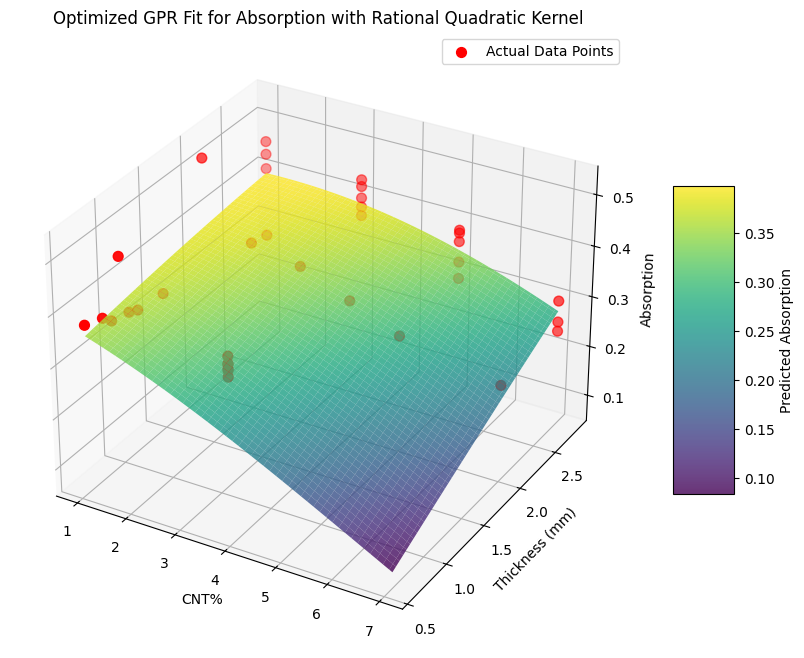

Best Absorption Model Parameters (Rational Quadratic): {'length_scale': 0.1, 'alpha': 5.0, 'length_scale_bounds': (10.0, 1000.0), 'alpha_bounds': (10.0, 1000.0), 'noise_alpha': 0.001, 'loss': 0.0008434463041719607}


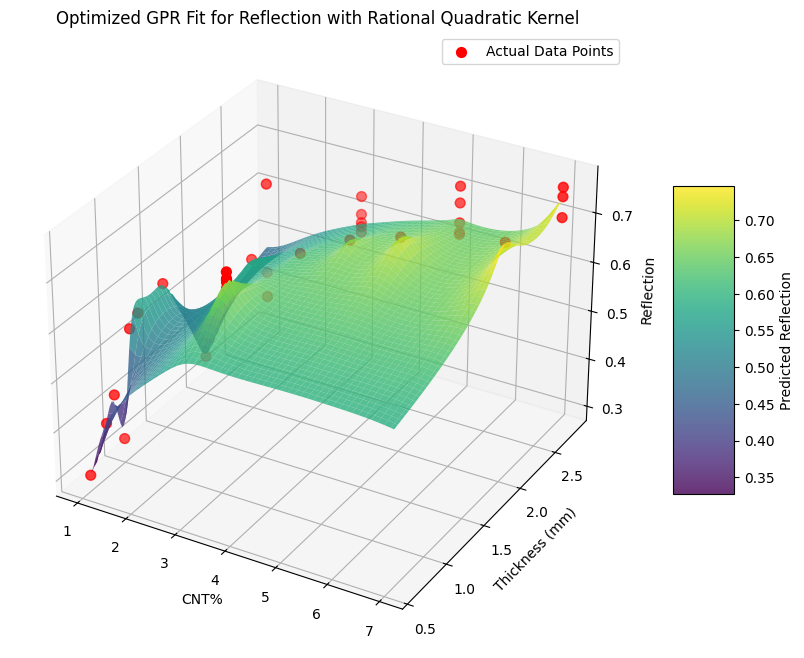

Best Reflection Model Parameters (Rational Quadratic): {'length_scale': 0.5, 'alpha': 0.1, 'length_scale_bounds': (0.01, 100.0), 'alpha_bounds': (0.1, 1000.0), 'noise_alpha': 0.001, 'loss': 0.0013010124603287342}


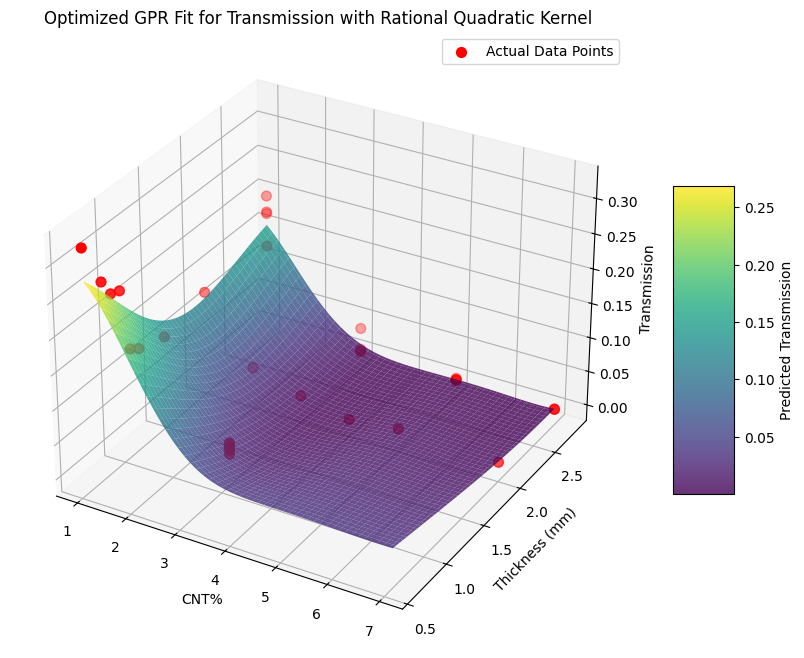

Best Transmission Model Parameters (Rational Quadratic): {'length_scale': 0.1, 'alpha': 0.1, 'length_scale_bounds': (0.1, 1000.0), 'alpha_bounds': (0.01, 100.0), 'noise_alpha': 0.001, 'loss': 0.0006556355968392318}


In [ ]:
def custom_loss_rational_quadratic(y_true, y_pred, kernel):
    """
    Custom loss function for GPR with Rational Quadratic kernel.

    Parameters:
    - y_true: True target values.
    - y_pred: Predicted target values.
    - kernel: The GPR kernel used for predictions.

    Returns:
    - Loss: Weighted sum of MSE and kernel-based penalties.
    """
    # Mean Squared Error
    mse_loss = np.mean((y_true - y_pred) ** 2)

    # Regularization: Penalize small length_scale and alpha
    length_scale = kernel.k2.length_scale
    alpha = kernel.k2.alpha
    smoothness_penalty = 1 / length_scale + 1 / alpha  # Penalize small values

    # Total loss
    return mse_loss + 0.0 * smoothness_penalty  # Adjust regularization weight as needed


def grid_search_rational_quadratic(thesis_df, target, grid_resolution=100):
    """
    Perform grid search to optimize hyperparameters of the Rational Quadratic kernel.

    Parameters:
    - thesis_df (pd.DataFrame): The dataset containing input features and targets.
    - target (str): The target variable to predict ('absorption', 'reflection', or 'transmission').
    - grid_resolution (int): Resolution for the prediction grid.

    Returns:
    - best_model (GaussianProcessRegressor): Trained GPR model with the best Rational Quadratic kernel.
    - best_params (dict): Optimal hyperparameters of the Rational Quadratic kernel.
    """
    # Extract features and target
    X = thesis_df[['cnt_pct', 'thickness']].values
    y = thesis_df[f'mean_{target[0].lower()}'].values

    # Split into train and validation sets
    X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.1, random_state=42)

    # Hyperparameter grid
    length_scales = [0.1, 0.5, 1.0, 2.0, 5.0]
    alphas = [0.1, 0.5, 1.0, 2.0, 5.0]
    length_scale_bounds_options = [(1e-2, 1e2), (1e-1, 1e3), (10.0, 1000.0)]
    alpha_bounds_options = [(1e-2, 1e2), (1e-1, 1e3), (10.0, 1000.0)]
    alpha_values = [1e-3]

    best_loss = float('inf')
    best_model = None
    best_params = None

    # Grid search
    for length_scale in length_scales:
        for alpha in alphas:
            for length_scale_bounds in length_scale_bounds_options:
                for alpha_bounds in alpha_bounds_options:
                    for noise_alpha in alpha_values:
                        # Define kernel
                        kernel = C(1.0, (1e-1, 1e3)) * RationalQuadratic(
                            length_scale=length_scale,
                            alpha=alpha,
                            length_scale_bounds=length_scale_bounds,
                            alpha_bounds=alpha_bounds
                        )
                        gpr = GaussianProcessRegressor(kernel=kernel, alpha=noise_alpha, n_restarts_optimizer=10)
                        gpr.fit(X_train, y_train)
                        y_val_pred = gpr.predict(X_val)
                        loss = custom_loss_rational_quadratic(y_val, y_val_pred, gpr.kernel_)

                        # Update best model if lower loss is found
                        if loss < best_loss:
                            best_loss = loss
                            best_model = gpr
                            best_params = {
                                "length_scale": length_scale,
                                "alpha": alpha,
                                "length_scale_bounds": length_scale_bounds,
                                "alpha_bounds": alpha_bounds,
                                "noise_alpha": noise_alpha,
                                "loss": loss,
                            }

    # Generate grid for predictions
    CNT_grid = np.linspace(thesis_df['CNT%'].min(), thesis_df['CNT%'].max(), grid_resolution)
    Thickness_grid = np.linspace(thesis_df['Thickness'].min(), thesis_df['Thickness'].max(), grid_resolution)
    CNT_grid, Thickness_grid = np.meshgrid(CNT_grid, Thickness_grid)
    X_pred = np.c_[CNT_grid.ravel(), Thickness_grid.ravel()]

    # Make predictions
    y_pred, y_std = best_model.predict(X_pred, return_std=True)
    y_pred = y_pred.reshape(CNT_grid.shape)

    # Plot the results
    fig = plt.figure(figsize=(12, 8))
    ax = fig.add_subplot(111, projection='3d')
    surf = ax.plot_surface(CNT_grid, Thickness_grid, y_pred, cmap='viridis', alpha=0.8)
    fig.colorbar(surf, shrink=0.5, aspect=5, label=f'Predicted {target.capitalize()}')

    # Overlay the actual data points
    ax.scatter(
        thesis_df['CNT%'], thesis_df['Thickness'], thesis_df[f'mean_{target[0].lower()}'],
        c='red', label='Actual Data Points', s=50
    )

    # Labels and title
    ax.set_xlabel('CNT%')
    ax.set_ylabel('Thickness (mm)')
    ax.set_zlabel(f'{target.capitalize()}')
    ax.set_title(f'Optimized GPR Fit for {target.capitalize()} with Rational Quadratic Kernel')
    ax.legend()
    plt.show()

    return best_model, best_params


# Example usage for each target:
gpr_model_absorption_rq, best_params_absorption_rq = grid_search_rational_quadratic(thesis_df, target="absorption")
print("Best Absorption Model Parameters (Rational Quadratic):", best_params_absorption_rq)

gpr_model_reflection_rq, best_params_reflection_rq = grid_search_rational_quadratic(thesis_df, target="reflection")
print("Best Reflection Model Parameters (Rational Quadratic):", best_params_reflection_rq)

gpr_model_transmission_rq, best_params_transmission_rq = grid_search_rational_quadratic(thesis_df, target="transmission")
print("Best Transmission Model Parameters (Rational Quadratic):", best_params_transmission_rq)


Round Two, extend ranges

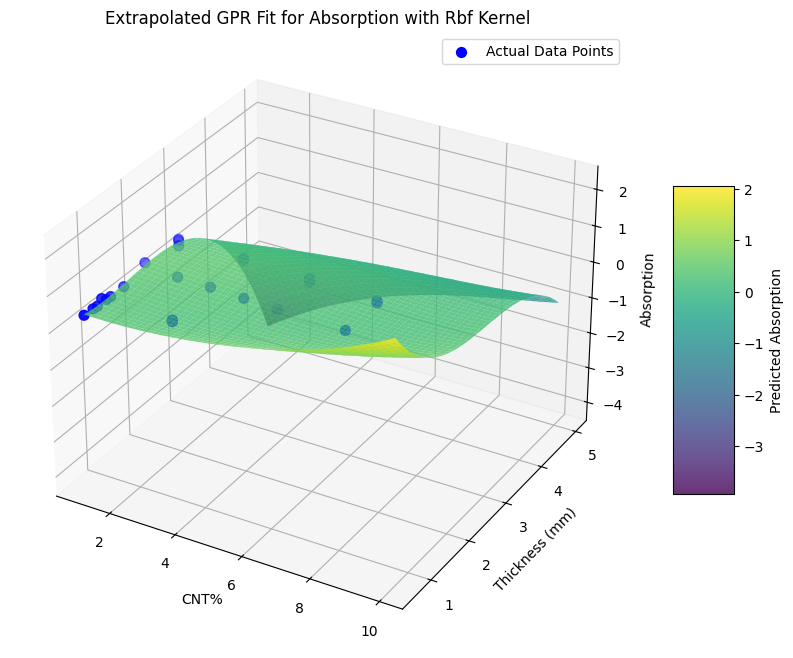

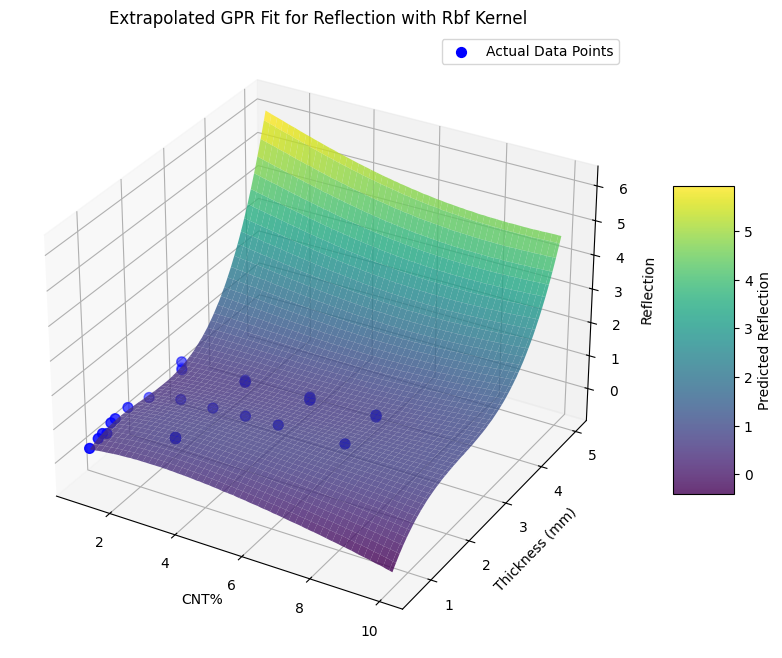

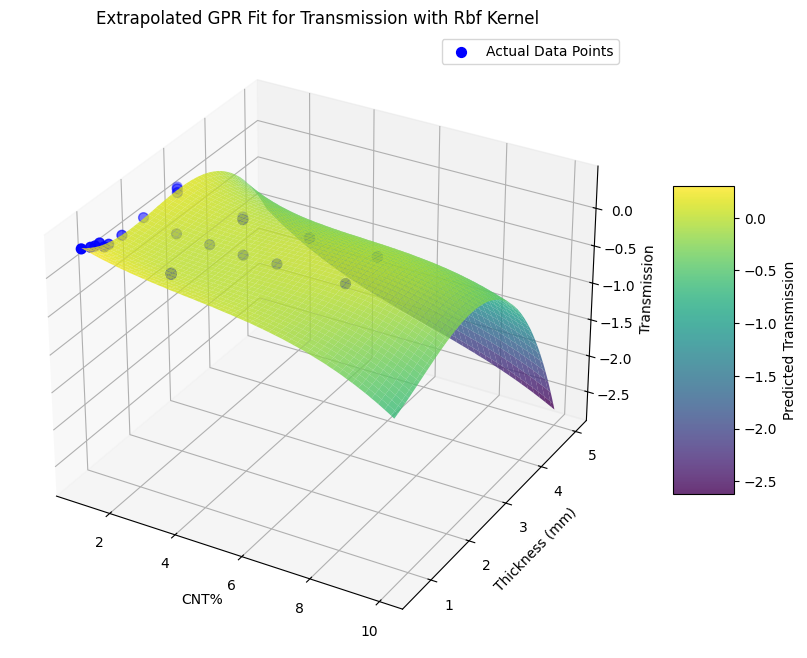

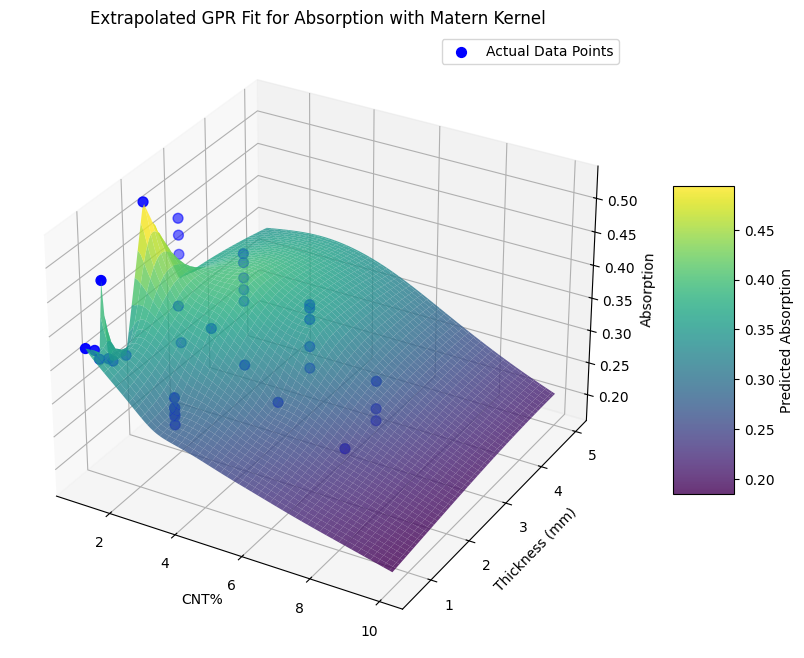

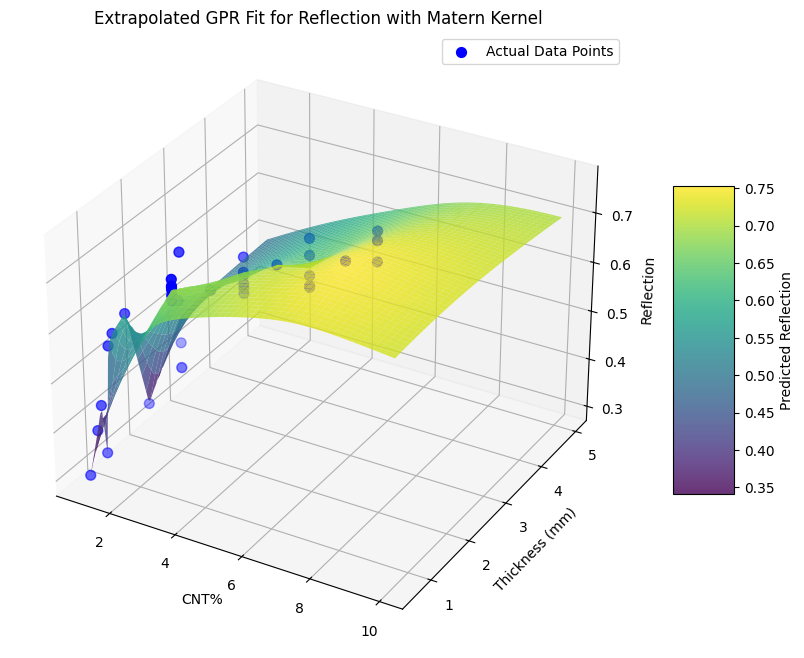

...

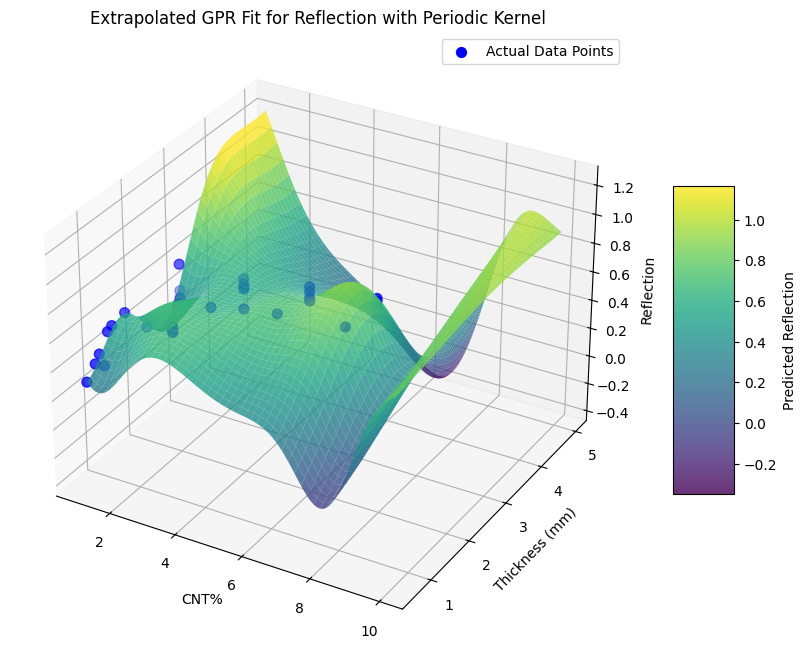

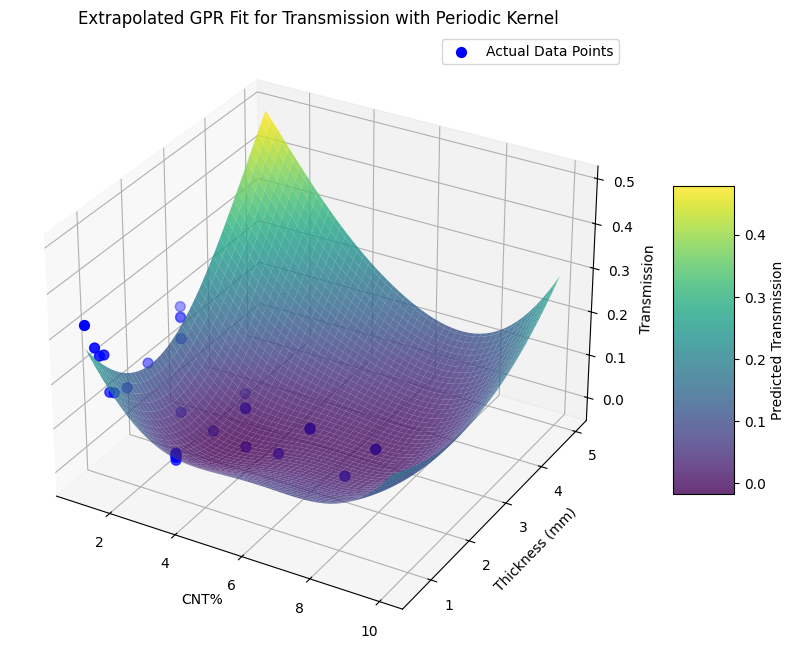

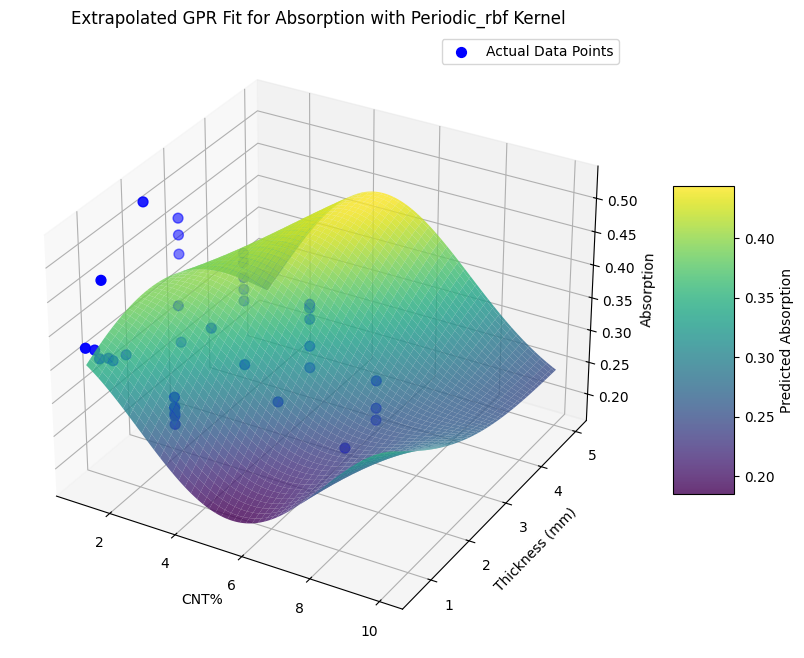

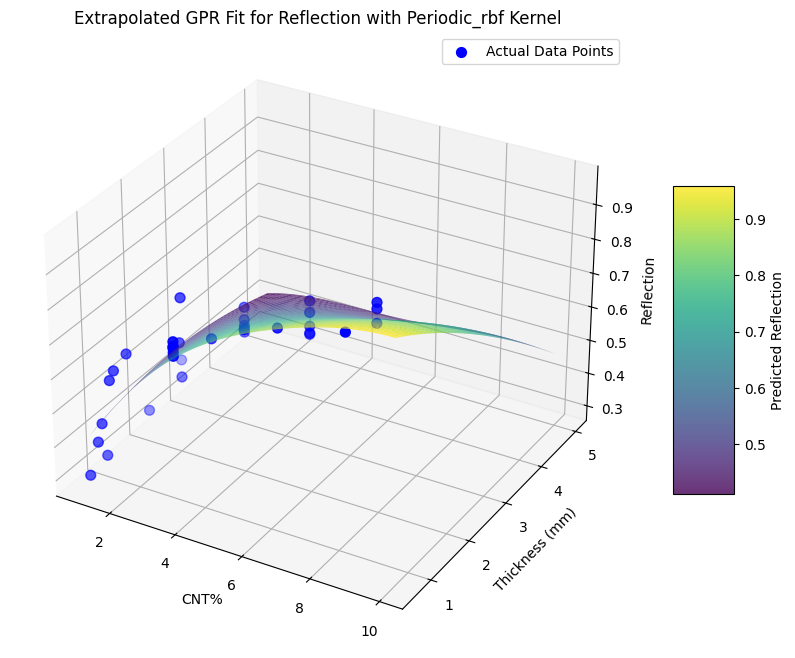

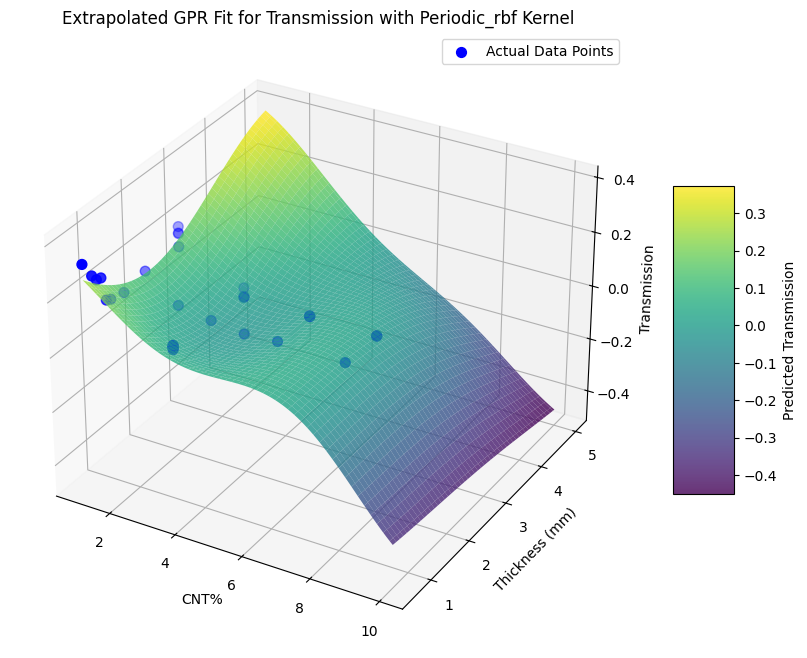

In [ ]:
# Define models with their best parameters
def create_model(kernel, params):
    return GaussianProcessRegressor(kernel=kernel, alpha=params.get('alpha', 1e-10), n_restarts_optimizer=10)

def create_and_visualize_models(thesis_df):
    # Define best parameters for all models
    parameters = {
        "rbf": {
            "absorption": {'length_scale': 0.1, 'length_scale_bounds': (100.0, 10000.0), 'constant': 1.0, 'alpha': 1e-10},
            "reflection": {'length_scale': 0.1, 'length_scale_bounds': (100.0, 10000.0), 'constant': 1.0, 'alpha': 1e-10},
            "transmission": {'length_scale': 0.1, 'length_scale_bounds': (100.0, 10000.0), 'constant': 1.0, 'alpha': 1e-10},
        },
        "matern": {
            "absorption": {'length_scale': 0.5, 'length_scale_bounds': (10.0, 10000.0), 'nu': 0.5, 'alpha': 1e-10},
            "reflection": {'length_scale': 0.5, 'length_scale_bounds': (100.0, 100000.0), 'nu': 0.5, 'alpha': 1e-10},
            "transmission": {'length_scale': 0.5, 'length_scale_bounds': (10.0, 10000.0), 'nu': 0.5, 'alpha': 1e-10},
        },
        "rq": {
            "absorption": {'length_scale': 1.0, 'alpha': 1.0, 'length_scale_bounds': (10.0, 1000.0), 'alpha_bounds': (10.0, 1000.0), 'noise_alpha': 0.001},
            "reflection": {'length_scale': 5.0, 'alpha': 0.5, 'length_scale_bounds': (10.0, 1000.0), 'alpha_bounds': (10.0, 1000.0), 'noise_alpha': 0.001},
            "transmission": {'length_scale': 0.5, 'alpha': 1.0, 'length_scale_bounds': (10.0, 1000.0), 'alpha_bounds': (10.0, 1000.0), 'noise_alpha': 0.001},
        },
        "periodic": {
            "absorption": {'periodic_length_scale': 0.1, 'periodicity': 1.0, 'periodicity_bounds': (1.0, 1000.0), 'alpha': 0.001},
            "reflection": {'periodic_length_scale': 2.0, 'periodicity': 0.5, 'periodicity_bounds': (1.0, 10.0), 'alpha': 0.001},
            "transmission": {'periodic_length_scale': 0.1, 'periodicity': 5.0, 'periodicity_bounds': (1.0, 1000.0), 'alpha': 0.001},
        },
        "periodic_rbf": {
            "absorption": {'rbf_length_scale': 0.1, 'periodic_length_scale': 0.1, 'periodicity': 5.0, 'length_scale_bounds': (10.0, 100000.0), 'periodicity_bounds': (1.0, 1000.0), 'alpha': 0.001},
            "reflection": {'rbf_length_scale': 5.0, 'periodic_length_scale': 2.0, 'periodicity': 5.0, 'length_scale_bounds': (10.0, 100000.0), 'periodicity_bounds': (1.0, 1000.0), 'alpha': 0.001},
            "transmission": {'rbf_length_scale': 5.0, 'periodic_length_scale': 2.0, 'periodicity': 1.0, 'length_scale_bounds': (10.0, 100000.0), 'periodicity_bounds': (1.0, 1000.0), 'alpha': 0.001},
        },
    }

    # Map kernels
    kernels = {
        "rbf": lambda params: C(params['constant'], params['length_scale_bounds']) * RBF(length_scale=params['length_scale'], length_scale_bounds=params['length_scale_bounds']),
        "matern": lambda params: Matern(length_scale=params['length_scale'], length_scale_bounds=params['length_scale_bounds'], nu=params['nu']),
        "rq": lambda params: RationalQuadratic(length_scale=params['length_scale'], alpha=params['alpha'], length_scale_bounds=params['length_scale_bounds'], alpha_bounds=params['alpha_bounds']),
        "periodic": lambda params: ExpSineSquared(length_scale=params['periodic_length_scale'], periodicity=params['periodicity'], periodicity_bounds=params['periodicity_bounds']),
        "periodic_rbf": lambda params: Product(
            RBF(length_scale=params['rbf_length_scale'], length_scale_bounds=params['length_scale_bounds']),
            ExpSineSquared(length_scale=params['periodic_length_scale'], periodicity=params['periodicity'], periodicity_bounds=params['periodicity_bounds']),
        ),
    }

    # Define extended ranges
    CNT_range = [thesis_df['CNT%'].min(), 10]  # Extend to 10%
    thickness_range = [thesis_df['Thickness'].min(), 5.0]  # Extend to 5 mm

    # Visualize models
    for kernel_name, targets in parameters.items():
        for target, params in targets.items():
            # Create model and fit to data
            kernel = kernels[kernel_name](params)
            model = create_model(kernel, params)

            X = thesis_df[['cnt_pct', 'thickness']].values
            y = thesis_df[f'mean_{target[0].lower()}'].values
            model.fit(X, y)

            # Generate extended grid for predictions
            CNT_grid = np.linspace(CNT_range[0], CNT_range[1], 100)
            thickness_grid = np.linspace(thickness_range[0], thickness_range[1], 100)
            CNT_grid, thickness_grid = np.meshgrid(CNT_grid, thickness_grid)
            X_pred = np.c_[CNT_grid.ravel(), thickness_grid.ravel()]
            y_pred = model.predict(X_pred).reshape(CNT_grid.shape)

            # Plot results
            fig = plt.figure(figsize=(12, 8))
            ax = fig.add_subplot(111, projection='3d')
            surf = ax.plot_surface(CNT_grid, thickness_grid, y_pred, cmap='viridis', alpha=0.8)
            fig.colorbar(surf, shrink=0.5, aspect=5, label=f'Predicted {target.capitalize()}')

            # Overlay actual data points
            ax.scatter(
                thesis_df['CNT%'], thesis_df['Thickness'], thesis_df[f'mean_{target[0].lower()}'],
                c='blue', label='Actual Data Points', s=50
            )

            # Labels and title
            ax.set_xlabel('CNT%')
            ax.set_ylabel('Thickness (mm)')
            ax.set_zlabel(f'{target.capitalize()}')
            ax.set_title(f'Extrapolated GPR Fit for {target.capitalize()} with {kernel_name.capitalize()} Kernel')
            ax.legend()
            plt.show()

# Call the function to visualize all 15 plots
create_and_visualize_models(thesis_df)


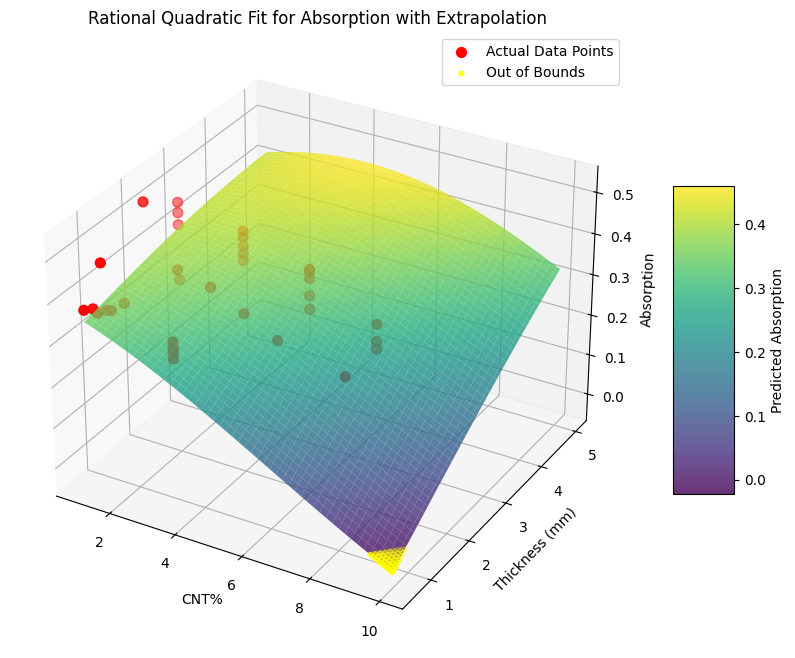

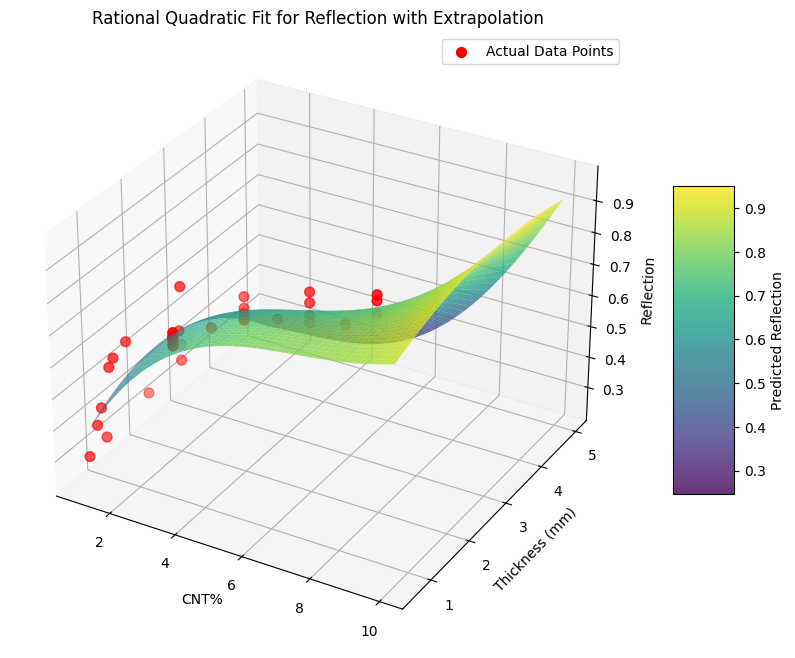

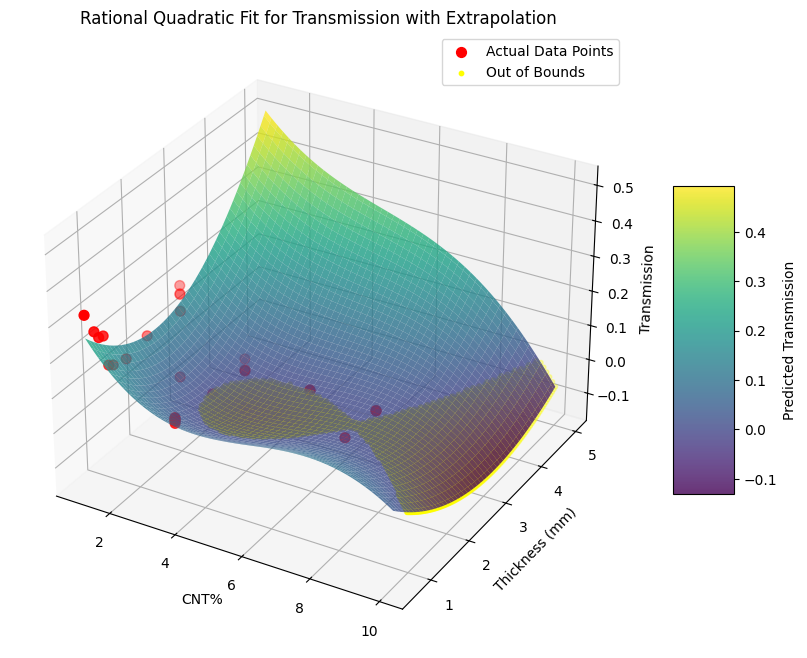

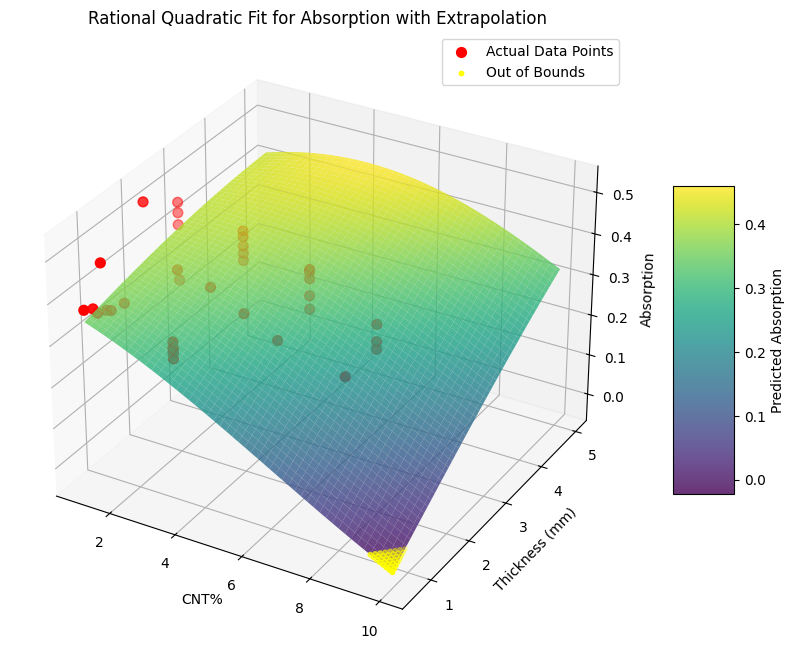

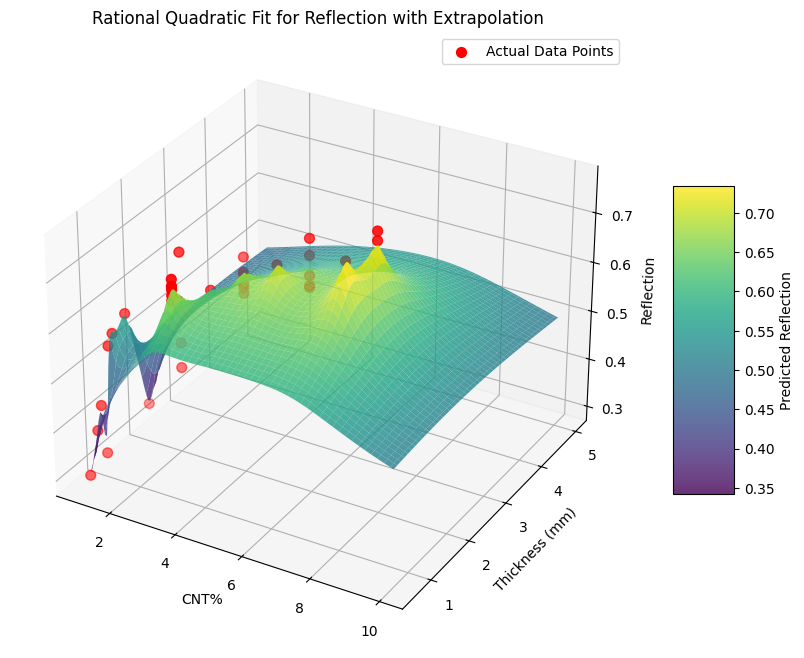

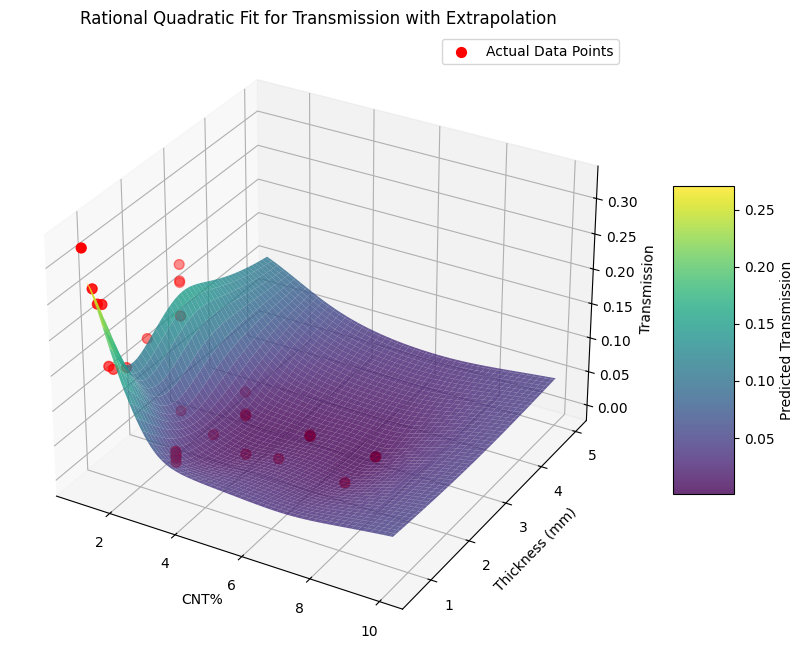

In [ ]:
def plot_rational_quadratic(thesis_df, best_params, target, grid_resolution=100, extrapolation_bounds=(0.1, 10.0, 0.6, 5.0)):
    """
    Plot Rational Quadratic kernel results with extrapolated predictions.

    Parameters:
    - thesis_df (pd.DataFrame): The dataset containing input features and targets.
    - best_params (dict): Best hyperparameters for the Rational Quadratic kernel.
    - target (str): The target variable to predict ('absorption', 'reflection', or 'transmission').
    - grid_resolution (int): Resolution for the prediction grid.
    - extrapolation_bounds (tuple): Bounds for extrapolation (min_CNT%, max_CNT%, min_Thickness, max_Thickness).

    Returns:
    - None (plots results)
    """
    # Extract features and target
    X = thesis_df[['cnt_pct', 'thickness']].values
    y = thesis_df[f'mean_{target[0].lower()}'].values

    # Define the Rational Quadratic kernel with the given parameters
    kernel = C(1.0, (1e-1, 1e3)) * RationalQuadratic(
        length_scale=best_params['length_scale'],
        alpha=best_params['alpha'],
        length_scale_bounds=best_params['length_scale_bounds'],
        alpha_bounds=best_params['alpha_bounds']
    )

    # Train the Gaussian Process Regressor
    gpr = GaussianProcessRegressor(kernel=kernel, alpha=best_params['noise_alpha'], n_restarts_optimizer=10)
    gpr.fit(X, y)

    # Generate grid for predictions
    CNT_min, CNT_max, Thickness_min, Thickness_max = extrapolation_bounds
    CNT_grid = np.linspace(CNT_min, CNT_max, grid_resolution)
    Thickness_grid = np.linspace(Thickness_min, Thickness_max, grid_resolution)
    CNT_grid, Thickness_grid = np.meshgrid(CNT_grid, Thickness_grid)
    X_pred = np.c_[CNT_grid.ravel(), Thickness_grid.ravel()]

    # Make predictions
    y_pred, y_std = gpr.predict(X_pred, return_std=True)
    y_pred = y_pred.reshape(CNT_grid.shape)

    # Plot the results
    fig = plt.figure(figsize=(12, 8))
    ax = fig.add_subplot(111, projection='3d')
    surf = ax.plot_surface(CNT_grid, Thickness_grid, y_pred, cmap='viridis', alpha=0.8)
    fig.colorbar(surf, shrink=0.5, aspect=5, label=f'Predicted {target.capitalize()}')

    # Overlay the actual data points
    ax.scatter(
        thesis_df['CNT%'], thesis_df['Thickness'], thesis_df[f'mean_{target[0].lower()}'],
        c='red', label='Actual Data Points', s=50
    )

    # Highlight where predictions exceed bounds
    out_of_bounds = (y_pred < 0) | (y_pred > 1)
    if np.any(out_of_bounds):
        ax.scatter(CNT_grid[out_of_bounds], Thickness_grid[out_of_bounds], y_pred[out_of_bounds],
                   c='yellow', label='Out of Bounds', s=10)

    # Labels and title
    ax.set_xlabel('CNT%')
    ax.set_ylabel('Thickness (mm)')
    ax.set_zlabel(f'{target.capitalize()}')
    ax.set_title(f'Rational Quadratic Fit for {target.capitalize()} with Extrapolation')
    ax.legend()
    plt.show()

# Example usage
rational_quadratic_params = [
    {'length_scale': 1.0, 'alpha': 1.0, 'length_scale_bounds': (10.0, 1000.0), 'alpha_bounds': (10.0, 1000.0), 'noise_alpha': 0.001},
    {'length_scale': 5.0, 'alpha': 0.5, 'length_scale_bounds': (10.0, 1000.0), 'alpha_bounds': (10.0, 1000.0), 'noise_alpha': 0.001},
    {'length_scale': 0.5, 'alpha': 1.0, 'length_scale_bounds': (10.0, 1000.0), 'alpha_bounds': (10.0, 1000.0), 'noise_alpha': 0.001},
    {'length_scale': 0.1, 'alpha': 5.0, 'length_scale_bounds': (10.0, 1000.0), 'alpha_bounds': (10.0, 1000.0), 'noise_alpha': 0.001},
    {'length_scale': 0.5, 'alpha': 0.1, 'length_scale_bounds': (0.01, 100.0), 'alpha_bounds': (0.1, 1000.0), 'noise_alpha': 0.001},
    {'length_scale': 0.1, 'alpha': 0.1, 'length_scale_bounds': (0.1, 1000.0), 'alpha_bounds': (0.01, 100.0), 'noise_alpha': 0.001},
]

targets = ["absorption", "reflection", "transmission"]

for i, params in enumerate(rational_quadratic_params):
    target = targets[i % 3]  # Rotate through targets
    plot_rational_quadratic(thesis_df, params, target, extrapolation_bounds=(1.0, 10.0, 0.6, 5.0))
